# Paper: nubosidad en el Noreste Argentino

**Este código genera las figuras para el paper de nubosidad en el Noreste Argentino**


### Table 1

Information of meteorological stations of the Argentina's National Weather Service (SMN) in Northeast Argentina

### Figura 1

ISCCP-H grid data points and SMN meteorological stations over Northeast Argentina. 

### Figura 2

Monthly cloud cover anomaly (okta) versus monthly cloud index anomaly (%) for all SMN´s NEA stations considered over the period 1961-2021. In red, it is shown the least-squares regression line and the coefficient of determination R^2.


### Figura 3a

Climatology of monthly frequency of daily total cloud cover -oktas- (1983-2016). Regional mean over Northeast Argentina, SMN stations. Low cloud cover oktas in brown, middle cloud cover oktas in grey and high cloud cover oktas in blue.

### Figura 3b

Climatology of monthly cloud cover -oktas- regional mean over Northeast Argentina, SMN stations (red) and climatology of monthly cloud amount -%- regional mean over Northeast Argentina, ISCCP-H (blue). Period: 1983 to 2016.


### Figura 4a

Cloud cover -oktas- annual (i) and seasonal (ii) mean over Northeast Argentina, SMN stations. Period: 1983 to 2016. 

### Figura 4b

Cloud amount -%- annual (i) and seasonal (ii) mean over Northeast Argentina, ISCCP-H. Period: 1983 to 2016. 

### Figura 4

(Se unen 4a y 4b)
Monthly cloud cover annual (top-left) and seasonal (top-right) mean -oktas- over Northeast Argentina, SMN stations.  Monthly cloud amount annual (bottom-left) and seasonal (bottom-right) mean -%- over Northeast Argentina, ISCCP-H. Period: 1983 to 2016.


### Tabla 2
##### 2.a
Tabla de contingencia que suma los casos de todas las estaciones de NEA y sus puntos de grilla mas cercanos:

Intercomparison in the form of a contingency matrix of monthly cloud cover (oktas) in Northeast Argentina SMN stations and ISCCP-H monthly cloud amount (oktas) in the corresponding nearest grid data points, for the period 1983-2016. The oktas indicated in the horizontal direction represent the data from SMN, the oktas in the vertical direction are those from ISCCP-H. Band 0 represents the cases in which both procedures yield the same cloudiness in okta. Band 1, Band 2 and Band 3 represents the cases in which there are 1 okta, 2 oktas and more than 3 oktas difference, respectively. Over (under) indicates that ISCCP-H overestimates (underestimates) SMN. It is also show the Normalized contingency coefficient. 

##### 2.b
Veo cada estacion por separado y muestro el porcentaje que cae en cada banda y el coef de contingencia. Agrego analisis para la media regional.


**Paletas de colores colorblind:** https://davidmathlogic.com/colorblind/#%23FF7364-%23785EF0-%23DC267F-%23FE6100-%23FFB000

Ademas guardo salidas como series que me pueden servir en un futuro:



----------------------------------
# Code

### Load Libraries and functions

In [1]:
import warnings
warnings.filterwarnings("ignore") #para que muestre los warnings una sola vez

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import csv
import xarray as xr
import datetime as dt

from f_paper_nubosidad_NEA import f_mapa, f_media_mensual_smn, f_serie_anomalias_mensuales, f_calculo_CI, f_calculo_PC, f_cor_CI_media_anomalias_paper, f_frecuencia_oktas_por_mes, f_barplot_oktas_separadas_climatologia_media_espacial, f_barplot_media_mensual_ISCCP_y_SMN_climatologia_media_espacial

import f_paletas_colores

from f_abrir_datos_smn import abrir_datos_smn
from f_make_grid import make_grid
from f_mis_shapes import df_paises, df_provincias
from f_graficos_calibracion import grafico_puntos, grafico_puntos_paper, histograma_oktas_sat, histograma_oktas_sat_smn
from f_cargo_datos_isccp import cargo_datos_ISCCP
from f_porc_to_oktas import data_frame_oktas
from f_puntos_cercanos import puntos_cercanos
from f_tablas_de_contingencia_nubosidad import generar_tabla_contingencia

from f_graficos_calibracion import scatter, histograma, stackplot, barplot_oktas_separadas, histogramas_partidos, histograma_oktas_sat_smn, histogramas_partidos_poster
from f_procesamiento_satelite import frecuencia_oktas_por_anio, frecuencia_oktas_por_anio_estaciones, frecuencia_oktas_por_anio_meses, frecuencia_oktas_por_mes, agrupo_frecuencias, agrupo_data
import f_procesamiento_smn
from c_clases_satelite import dataframe_satelite, frecuencias_oktas
from c_clases_smn import dataframe_smn


### Load directories

In [2]:
cwd = os.getcwd()
print("Current working directory: {0}".format(cwd))

#si estoy trabajando desde el servidor vegeta
ruta_a_archivos_isccp_mensual = "/pikachu/datos2/isccp-h/HGM" #ruta donde estan los archivos con datos de isccp-h
ruta_a_archivos_smn = "/pikachu/datos/nadia.testani/Doctorado/datos/smn/smn_variables_1961-2021/" #ruta donde estan los archivos con datos del smn
ruta_a_archivo_estaciones_smn = "/pikachu/datos/nadia.testani/Doctorado/datos/smn/" 
ruta_a_resultados = "/pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper" #ruta donde se guardan los resultados del analisis de nubosidad

Current working directory: /home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad


### Important dates

In [3]:
##periodo comun con satelite (Diciembre 1983 a Noviembre 2016)
fecha_inicio_str = "1983-12-15"
fecha_final_str = "2016-11-15"

##periodo completo años enteros y estaciones enteras March 1961 a February 2021
fecha_inicio_str_2 = "1961-03-01" 
fecha_final_str_2 = "2021-02-28" 

#climatologia: periodo comun con satelite (Diciembre 1983 a Noviembre 2016)
fecha_inicio_climatologia_str = "1983-12-15"
fecha_final_climatologia_str = "2016-11-15"

### Cargo datos

In [4]:
# Cargo datos de SMN
nombres_archivos = os.listdir(ruta_a_archivos_smn)
datos_smn = {}
for nombre_archivo in nombres_archivos:
    id_data = abrir_datos_smn(ruta_a_archivos = ruta_a_archivos_smn, nombre_archivo = nombre_archivo, 
                              variable = "nub")
    datos_smn[id_data[0]] = id_data[1]
    

# Cargo datos de ISCCPH mensual, recorto en region de interes y en las fechas que elijo para climatologia
isccp_mensual = xr.open_dataset(f"{ruta_a_archivos_isccp_mensual}/media_mensual_cldamt_cldamttypes.nc")[["cldamt","cldamt_types"]]
isccp_mensual_grande = isccp_mensual.loc[dict(lon=slice(298, 307),lat=slice(-33,-24))] #recorto region de interes (NEA) + 1 lon y lat para cada lado
isccp_mensual = isccp_mensual.loc[dict(lon=slice(299, 306),lat=slice(-32,-25))] #recorto region de interes (NEA)
isccp_mensual = isccp_mensual.sel(time=slice(fecha_inicio_climatologia_str, fecha_final_climatologia_str))
isccp_mensual_grande = isccp_mensual_grande.sel(time=slice(fecha_inicio_climatologia_str, fecha_final_climatologia_str))


In [5]:
# Cargo informacion sobre estaciones SMN
estaciones_smn = pd.read_excel(f"{ruta_a_archivo_estaciones_smn}Exp185151.xlsx", sheet_name = "Estaciones", 
                               names = ["EST", "NOMBRE", "LAT", "LON", "ALT"]) #smn

# Corrijo puntos manualmente 

#monte caseros
estaciones_smn.loc[estaciones_smn.EST == 87393, 'LAT'] = 30.27078
estaciones_smn.loc[estaciones_smn.EST == 87393, 'LON'] = 57.64046
#reconquista aero
estaciones_smn.loc[estaciones_smn.EST == 87270, 'LAT'] = 29.20159
estaciones_smn.loc[estaciones_smn.EST == 87270, 'LON'] = 59.69280

#paso de los libres aero
estaciones_smn.loc[estaciones_smn.EST == 87289, 'LAT'] = 29.68796
estaciones_smn.loc[estaciones_smn.EST == 87289, 'LON'] = 57.15317

#posadas aero
estaciones_smn.loc[estaciones_smn.EST == 87178, 'LAT'] = 27.39170
estaciones_smn.loc[estaciones_smn.EST == 87178, 'LON'] = 55.96673

#corrientes aero
estaciones_smn.loc[estaciones_smn.EST == 87166, 'LAT'] = 27.44915
estaciones_smn.loc[estaciones_smn.EST == 87166, 'LON'] = 58.75830

#concordia aero
estaciones_smn.loc[estaciones_smn.EST == 87395, 'LAT'] = 31.30297
estaciones_smn.loc[estaciones_smn.EST == 87395, 'LON'] = 58.00242

#resistencia aero
estaciones_smn.loc[estaciones_smn.EST == 87155, 'LAT'] = 27.44478
estaciones_smn.loc[estaciones_smn.EST == 87155, 'LON'] = 59.04856

#obera
estaciones_smn.loc[estaciones_smn.EST == 87187, 'LAT'] = 27.48733
estaciones_smn.loc[estaciones_smn.EST == 87187, 'LON'] = 55.12099

#roque saenz peña
estaciones_smn.loc[estaciones_smn.EST == 87148, 'LAT'] = 26.74565
estaciones_smn.loc[estaciones_smn.EST == 87148, 'LON'] = 60.48277

#mercedes
estaciones_smn.loc[estaciones_smn.EST == 87281, 'LAT'] = -29.22248
estaciones_smn.loc[estaciones_smn.EST == 87281, 'LON'] = -58.08762

#ituzaingo 
estaciones_smn.loc[estaciones_smn.EST == 87173, 'LAT'] = -27.58890
estaciones_smn.loc[estaciones_smn.EST == 87173, 'LON'] = -56.68925

### TABLE 1

In [7]:
#extraigo la fecha de la primer y ultima medicion y calculo porcentaje de datos faltantes y lo acomodo en una tabla
print(f"CREATE TABLE 1")
print("\n")

codigos = list(estaciones_smn.EST)
nombres = ["Mercedes Aero", "Monte Caseros Aero", "Reconquista Aero", "Paso de los Libres Aero",
           "Posadas Aero", "Corrientes Aero", "Concordia Aero", "Resistencia Aero", "Ituzaingó", 
           "Oberá", "Presidencia Roque Saenz Peña Aero"]
lons = list(round(estaciones_smn.LON, 3))
lats = list(round(estaciones_smn.LAT,3))
alts = list(estaciones_smn.ALT)
fechas_0 = [str(datos_smn[cod].index[0].month) +"/" + str(datos_smn[cod].index[0].year) for cod in codigos]
fechas_menos1 = [str(datos_smn[cod].index[-1].month) +"/" + str(datos_smn[cod].index[-1].year) for cod in codigos]
porcentajes_faltantes = [round(datos_smn[cod].isnull()["nub"].sum()/len(datos_smn[cod]["nub"])*100, 3) for cod in codigos]

tabla_info_estaciones = pd.DataFrame({"Name": nombres,
                                      "Code": codigos,
                                      "Longitude [º]": lons,
                                      "Latitude [º]": lats,
                                      "Elevation [m]": alts,
                                      "Initial Date [mm/yyyy]":fechas_0,
                                      "Final Date [mm/yyyy]":fechas_menos1,
                                      "Missing values [%]": porcentajes_faltantes})

#la guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

# create excel writer
writer = pd.ExcelWriter("tabla_info_estaciones.xlsx")
# write dataframe to excel sheet named 'marks'
tabla_info_estaciones.to_excel(writer, 'info')
#save the excel file
#writer.save()
print(f"SAVE TABLE 1")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY TO:{0}".format(cwd))

CREATE TABLE 1


CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE TABLE 1


CHANGE THE WORKING DIRECTORY TO:/home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad


### FIGURE 1

In [8]:
#%% Armo lista con los puntos satelitales
#Corregir esto! aparece esto cuando lo corro desde la terminal:


"""PLOT AND SAVE IT (use f_mapa in f_paper_nubosidad_NEA)
munmap_chunk(): invalid pointer
Aborted
""" 

lons_satelital_mensual = list(isccp_mensual.lon.values)
lats_satelital_mensual = list(isccp_mensual.lat.values)
lista_puntos_satelital_mensual = make_grid(lons_satelital_mensual, lats_satelital_mensual)

#%% Cargo lista puntos smn
lista_puntos_smn = [(360 - lon, -1 * lat) for lon, lat in zip(estaciones_smn["LON"],estaciones_smn["LAT"])]
dict_puntos_smn = dict(zip(list(estaciones_smn["EST"]), lista_puntos_smn))
estaciones_ordenadas = {87148: "Roque Saenz Peña", 87155: "Resistencia", 87166: "Corrientes", 87178: "Posadas",
                        87187: "Oberá", 87270: "Reconquista", 87289: "Paso de los Libres",
                        87393: "Montecaseros", 87395: "Concordia"} #solo me quedo con las que uso
ides_omm_ordenado = list(estaciones_ordenadas.keys())
nombres_ides_omm_ordenado = list(estaciones_ordenadas.values())

#cargo shapes
shape_paises = df_paises()
shape_provincias = df_provincias()

#grafico
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("PLOT AND SAVE IT (use f_mapa in f_paper_nubosidad_NEA)")
#f_mapa(lista_puntos_satelital_mensual, dict_puntos_smn, ides_omm_ordenado, 
 #                    nombres_ides_omm_ordenado, shape_paises, shape_provincias)

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


PLOT AND SAVE IT (use f_mapa in f_paper_nubosidad_NEA)


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad


### FIGURE 2

### Genero serie de anomalia de la media mensual de nubosidad (en oktas) para todas las estaciones

**Cálculo de medias mensuales**

* Calculo las medias mensuales para los meses con menos del 20% de datos faltantes
* Calculo las anomalias medias mensuales (le resto a las medias mensuales la media climatologica de cada mes calculada sobre el periodo comun con el satelite)

In [9]:
#calculo las medias mensuales
porcentaje_na_admitido = 20
medias_mensuales_smn = {} #genero diccionario donde se van a guardar las medias mensuales
#para cada id_omm_ordenado
for id_omm in ides_omm_ordenado:
    media_mensual_df = f_media_mensual_smn(id_omm, datos_smn[id_omm], porcentaje_na_admitido) #uso funcion f_media_mensual_smn en f_paper_nubosidad_NEA
    medias_mensuales_smn[id_omm] = media_mensual_df
print("Se genero diccionario con data frames de medias mensuales para cada estacion")
print("Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:")
print("-----------------") 
print("Medias mensuales:")
print(medias_mensuales_smn[87166].iloc[0:3])
print("-----------------") 


#calculo la climatologia de las medias mensuales
climatologia_medias_mensuales_smn = {} 
for id_omm in ides_omm_ordenado: #para cada id_omm_ordenado
    media_mensual_df = medias_mensuales_smn[id_omm]
    media_mensual_df.index = pd.to_datetime(media_mensual_df.index)
    media_mensual_fechas_climatologia = media_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    media_mensual_climatologia = media_mensual_fechas_climatologia.groupby(media_mensual_fechas_climatologia.index.month).mean() 
    #Lo guardo en diccionario: climatologia_medias_mensuales
    climatologia_medias_mensuales_smn[id_omm] = media_mensual_climatologia
print("\n") 
print("-----------------") 
print("Se genero diccionario con data frames de la climatologia de las medias mensuales para cada estacion")
print("Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:")
print("-----------------") 
print("Medias mensuales climatologia:")
print(climatologia_medias_mensuales_smn[87166])
print("-----------------") 

#calculo las anomalias de las medias mensuales
medias_mensuales_anomalias_smn = {}
for id_omm in ides_omm_ordenado:
    media_mensual_df = medias_mensuales_smn[id_omm]
    climatologia_medias_mensuales_df = climatologia_medias_mensuales_smn[id_omm]
    media_mensual_anomalia = f_serie_anomalias_mensuales(media_mensual_df, climatologia_medias_mensuales_df)
    medias_mensuales_anomalias_smn[id_omm] = media_mensual_anomalia
print("\n") 
print("-----------------") 
print("Se genero diccionario con data frames de la anomalia de las medias mensuales para cada estacion")
print("Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:")
print("-----------------") 
print("Medias mensuales anomalias:")
print(medias_mensuales_anomalias_smn[87166].iloc[0:3])
print("-----------------") 

Se genero diccionario con data frames de medias mensuales para cada estacion
Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:
-----------------
Medias mensuales:
               0
fecha           
1961-11-30  4.36
1961-12-31  3.00
1962-01-31   NaN
-----------------


-----------------
Se genero diccionario con data frames de la climatologia de las medias mensuales para cada estacion
Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:
-----------------
Medias mensuales climatologia:
              0
fecha          
1      3.617791
2      3.681706
3      3.439883
4      3.810101
5      3.747801
6      4.332323
7      3.636364
8      3.481916
9      3.701010
10     3.734115
11     3.336458
12     3.585533
-----------------


-----------------
Se genero diccionario con data frames de la anomalia de las medias mensuales para cada estacion
Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:
-----------------
Media

In [10]:
#guardo todo esto en csvs --> cada columna es una estacion

#defino dataframes

#TCC_monthly_mean_SMN 
TCC_monthly_mean_SMN  = pd.concat([medias_mensuales_smn[id] for id in ides_omm_ordenado], axis = 1)
TCC_monthly_mean_SMN.columns = ides_omm_ordenado

#TCC_monthly_mean_SMN_climatology (periodo fecha_inicio_str = "1983-12-15" fecha_final_str = "2016-11-15")
TCC_monthly_mean_SMN_climatology  = pd.concat([climatologia_medias_mensuales_smn[id] for id in ides_omm_ordenado], axis = 1)
TCC_monthly_mean_SMN_climatology.columns = ides_omm_ordenado

#TCC_monthly_mean_SMN_anomaly TCC_monthly_mean_SMN-TCC_monthly_mean_SMN_climatology
TCC_monthly_mean_SMN_anomaly  = pd.concat([medias_mensuales_anomalias_smn[id] for id in ides_omm_ordenado], axis = 1)
TCC_monthly_mean_SMN_anomaly.columns = ides_omm_ordenado

#los guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE TCC_monthly_mean_SMN as SAVE TCC_monthly_mean_SMN.csv")
TCC_monthly_mean_SMN.to_csv("TCC_monthly_mean_SMN.csv")
print("SAVE TCC_monthly_mean_SMN_climatology as SAVE TCC_monthly_mean_SMN_climatology.csv")
TCC_monthly_mean_SMN_climatology.to_csv("TCC_monthly_mean_SMN_climatology.csv")
print("SAVE TCC_monthly_mean_SMN_anomaly as SAVE TCC_monthly_mean_SMN_anomaly.csv")
TCC_monthly_mean_SMN_anomaly.to_csv("TCC_monthly_mean_SMN_anomaly.csv")


print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE TCC_monthly_mean_SMN as SAVE TCC_monthly_mean_SMN.csv
SAVE TCC_monthly_mean_SMN_climatology as SAVE TCC_monthly_mean_SMN_climatology.csv
SAVE TCC_monthly_mean_SMN_anomaly as SAVE TCC_monthly_mean_SMN_anomaly.csv


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad


### Genero serie de anomalia del indice de nubosidad (CI) (en %) que se define como: 

CI = 50 + 50 (N8 + N7 + N6 - N2 - N1 - N0 ) / Ntot

Donde:

* N8 = numero de observaciones con octa 8
* N7 = numero de observaciones con octa 7
* N6 = numero de observaciones con octa 6
* N2 = numero de observaciones con octa 2
* N1 = numero de observaciones con octa 1
* N0 = numero de observaciones con octa 0
* N = numero de observaciones del periodo a considerar

Tomo como periodo 1 mes y observaciones diarias, entonces:

* N8 = numero de dias con octa 8 en el mes
* N7 = numero de dias con octa 7 en el mes
* N6 = numero de dias con octa 6 en el mes
* N2 = numero de dias con octa 2 en el mes
* N1 = numero de dias con octa 1 en el mes
* N0 = numero de dias con octa 0 en el mes
* N = numero de dias del mes

**Y hago esto:**

* Calculo el CI mensuales para los meses con menos del 20% de datos faltantes
* Calculo las anomalias de CI mensuales (le resto a las medias mensuales la CI climatologica de cada mes calculada sobre el periodo comun con el satelite)

----------------------
Agrego el calculo del indice que tomamos de referencia para calcular CI: PC (Parameter of cloudiness):

PC = 50 + 50 (N8 - N0 ) / Ntot


In [11]:
#calculo CI mensuales
data_CI_mensuales = {} #genero diccionario donde se van a guardar las frecuencias mensuales
for id_omm in ides_omm_ordenado: #para cada id_omm_ordenado
    data_CI_mensuales[id_omm] = f_calculo_CI(datos_smn, id_omm, na = 20)
print("Se generara diccionario con data frames de CI mensuales para cada estacion")
print("Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:")
print("-----------------") 
print("CI mensuales:")
print(data_CI_mensuales[87166].iloc[0:3])
print("-----------------") 

#calculo climatologia de CI
climatologia_CI_mensuales = {} 
for id_omm in ides_omm_ordenado: #para cada id_omm_ordenado
    CI_mensual_df = data_CI_mensuales[id_omm]
    CI_mensual_df.index = pd.to_datetime(CI_mensual_df.index)
    CI_mensual_fechas_climatologia = CI_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    CI_mensual_climatologia = CI_mensual_fechas_climatologia.groupby(CI_mensual_fechas_climatologia.index.month).mean() 
    climatologia_CI_mensuales[id_omm] = CI_mensual_climatologia
print("\n") 
print("-----------------") 
print("Se generara diccionario con data frames de climatologia de CI mensuales para cada estacion")
print("Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:")
print("-----------------") 
print("CI mensuales climatologia:")
print(climatologia_CI_mensuales[87166].iloc[0:12])
print("-----------------") 

#calculo las anomalias de CI
CI_mensuales_anomalias = {}
for id_omm in ides_omm_ordenado:
    CI_mensual_df = data_CI_mensuales[id_omm]
    climatologia_CI_mensuales_df = climatologia_CI_mensuales[id_omm]
    CI_anomalia = f_serie_anomalias_mensuales(CI_mensual_df, climatologia_CI_mensuales_df)
    CI_mensuales_anomalias[id_omm] = CI_anomalia
print("\n") 
print("-----------------") 
print("Se genero diccionario con data frames de la anomalia de CI para cada estacion")
print("Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:")
print("-----------------") 
print("CI anomalias:")
print(CI_mensuales_anomalias[87166].iloc[0:3])
print("-----------------") 

Se generara diccionario con data frames de CI mensuales para cada estacion
Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:
-----------------
CI mensuales:
                    0
1961-11-01  58.333333
1961-12-01  33.870968
1962-01-01        NaN
-----------------


-----------------
Se generara diccionario con data frames de climatologia de CI mensuales para cada estacion
Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:
-----------------
CI mensuales climatologia:
            0
1   43.988270
2   44.181967
3   39.931574
4   47.474747
5   46.285435
6   54.696970
7   44.770283
8   41.739980
9   44.595960
10  46.334311
11  41.010101
12  44.052419
-----------------


-----------------
Se genero diccionario con data frames de la anomalia de CI para cada estacion
Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:
-----------------
CI anomalias:
                    0
1961-11-01  17.323232
1961-12-01 -10.181452
1

In [12]:
#calculo PC mensuales
data_PC_mensuales = {} #genero diccionario donde se van a guardar las frecuencias mensuales
for id_omm in ides_omm_ordenado: #para cada id_omm_ordenado
    data_PC_mensuales[id_omm] = f_calculo_PC(datos_smn, id_omm, na = 20)
print("Se generara diccionario con data frames de PC mensuales para cada estacion")
print("Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:")
print("-----------------") 
print("PC mensuales:")
print(data_PC_mensuales[87166].iloc[0:3])
print("-----------------") 

#calculo climatologia de PC
climatologia_PC_mensuales = {} 
for id_omm in ides_omm_ordenado: #para cada id_omm_ordenado
    PC_mensual_df = data_PC_mensuales[id_omm]
    PC_mensual_df.index = pd.to_datetime(PC_mensual_df.index)
    PC_mensual_fechas_climatologia = PC_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    PC_mensual_climatologia = PC_mensual_fechas_climatologia.groupby(PC_mensual_fechas_climatologia.index.month).mean() 
    climatologia_PC_mensuales[id_omm] = PC_mensual_climatologia
print("\n") 
print("-----------------") 
print("Se generara diccionario con data frames de climatologia de PC mensuales para cada estacion")
print("Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:")
print("-----------------") 
print("PC mensuales climatologia:")
print(climatologia_PC_mensuales[87166].iloc[0:12])
print("-----------------") 

#calculo las anomalias de PC
PC_mensuales_anomalias = {}
for id_omm in ides_omm_ordenado:
    PC_mensual_df = data_PC_mensuales[id_omm]
    climatologia_PC_mensuales_df = climatologia_PC_mensuales[id_omm]
    PC_anomalia = f_serie_anomalias_mensuales(PC_mensual_df, climatologia_PC_mensuales_df)
    PC_mensuales_anomalias[id_omm] = PC_anomalia
print("\n") 
print("-----------------") 
print("Se genero diccionario con data frames de la anomalia de PC para cada estacion")
print("Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:")
print("-----------------") 
print("PC anomalias:")
print(PC_mensuales_anomalias[87166].iloc[0:3])
print("-----------------") 

Se generara diccionario con data frames de PC mensuales para cada estacion
Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:
-----------------
PC mensuales:
                    0
1961-11-01  48.333333
1961-12-01  43.548387
1962-01-01        NaN
-----------------


-----------------
Se generara diccionario con data frames de climatologia de PC mensuales para cada estacion
Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:
-----------------
PC mensuales climatologia:
            0
1   48.338221
2   50.440364
3   48.435973
4   47.979798
5   48.729228
6   52.323232
7   46.285435
8   45.992180
9   48.333333
10  46.871945
11  44.242424
12  47.177419
-----------------


-----------------
Se genero diccionario con data frames de la anomalia de PC para cada estacion
Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:
-----------------
PC anomalias:
                   0
1961-11-01  4.090909
1961-12-01 -3.629032
1962

In [13]:
#guardo todo esto en csvs --> cada columna es una estacion

#defino dataframes

#TCC_monthly_CI_SMN 
TCC_monthly_CI_SMN  = pd.concat([data_CI_mensuales[id] for id in ides_omm_ordenado], axis = 1)
TCC_monthly_CI_SMN.columns = ides_omm_ordenado

#TCC_monthly_CI_SMN_climatology (periodo fecha_inicio_str = "1983-12-15" fecha_final_str = "2016-11-15")
TCC_monthly_CI_SMN_climatology  = pd.concat([climatologia_CI_mensuales[id] for id in ides_omm_ordenado], axis = 1)
TCC_monthly_CI_SMN_climatology.columns = ides_omm_ordenado

#TCC_monthly_CI_SMN_anomaly TCC_monthly_CI_SMN-TCC_monthly_CI_SMN_climatology
TCC_monthly_CI_SMN_anomaly  = pd.concat([CI_mensuales_anomalias[id] for id in ides_omm_ordenado], axis = 1)
TCC_monthly_CI_SMN_anomaly.columns = ides_omm_ordenado

#los guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE TCC_monthly_CI_SMN as SAVE TCC_monthly_CI_SMN.csv")
TCC_monthly_CI_SMN.to_csv("TCC_monthly_CI_SMN.csv")
print("SAVE TCC_monthly_CI_SMN_climatology as SAVE TCC_monthly_CI_SMN_climatology.csv")
TCC_monthly_CI_SMN_climatology.to_csv("TCC_monthly_CI_SMN_climatology.csv")
print("SAVE TCC_monthly_CI_SMN_anomaly as SAVE TCC_monthly_CI_SMN_anomaly.csv")
TCC_monthly_CI_SMN_anomaly.to_csv("TCC_monthly_CI_SMN_anomaly.csv")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE TCC_monthly_CI_SMN as SAVE TCC_monthly_CI_SMN.csv
SAVE TCC_monthly_CI_SMN_climatology as SAVE TCC_monthly_CI_SMN_climatology.csv
SAVE TCC_monthly_CI_SMN_anomaly as SAVE TCC_monthly_CI_SMN_anomaly.csv


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad


In [13]:
##BONUS TRACK
##veo correlacion entre anomalias de CI y anomalia de rango de temperatura diaria media mensual 

##Cargo datos tmax y tmin de SMN
#nombres_archivos = os.listdir(ruta_a_archivos_smn)
#datos_smn_tmax_tmin = {}
#for nombre_archivo in nombres_archivos:
#    id_data_tmax = abrir_datos_smn(ruta_a_archivos = ruta_a_archivos_smn, nombre_archivo = nombre_archivo, 
#                              variable = "tmax")
#    id_data_tmin = abrir_datos_smn(ruta_a_archivos_smn, nombre_archivo = nombre_archivo, 
#                              variable = "tmin")
#    datos_smn_tmax_tmin[id_data_tmax[0]] = pd.concat([id_data_tmax[1], id_data_tmin[1]], axis = 1)

##ejemplo: hago para 87178
#datos_smn_tmax_tmin[87178]["rango"] = datos_smn_tmax_tmin[87178]["tmax"] - datos_smn_tmax_tmin[87178]["tmin"]

##serie medias mensuales
#na = 20
#df_data = datos_smn_tmax_tmin[87178]
#data_group=df_data["rango"].groupby(pd.Grouper(freq="M"))
#data_group_media=data_group.mean() #hace la media aunque halla nans, a menos que todo el mes tenga nans
#data_group_faltantes = df_data["rango"].isnull().groupby(pd.Grouper(freq="M")).sum()
#data_group_size = data_group.size()
#parametro_porcentaje_na_admitido = 100/na
#posiciones_medias_a_conservar = data_group_faltantes.values <= data_group_size.values // parametro_porcentaje_na_admitido

##me quedo con los meses donde la cantidad de datos faltantes haya sido menor al na% de los datos para el mes
#media = []
#for i, elemento in enumerate(data_group_media):
#    if posiciones_medias_a_conservar[i] == True and pd.isna(elemento)!=True:
#        media.append(elemento) #media.append(round(elemento)) 
#    else:
#        media.append(np.nan)
#indices=data_group_media.index
#rango_media_mensual_df=pd.DataFrame(media, index = indices)
#rango_media_mensual_df.index.name = "fecha"
#rango_media_mensual_df

#rango_media_mensual_df.index = pd.to_datetime(rango_media_mensual_df.index)
#rango_media_mensual_df_fechas_climatologia = rango_media_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
#rango_media_mensual_df_climatologia = rango_media_mensual_df_fechas_climatologia.groupby(rango_media_mensual_df_fechas_climatologia.index.month).mean() 
#rango_media_mensual_df_climatologia

##calculo las anomalias de rango
#rango_media_mensual_anomalia = f_serie_anomalias_mensuales(rango_media_mensual_df, rango_media_mensual_df_climatologia)
#rango_media_mensual_anomalia

#plt.scatter(rango_media_mensual_anomalia, CI_mensuales_anomalias[87178])


### Armo la figura 2 para todas las estaciones 

Considero datos entre enero 1961 y noviembre 2021

In [14]:
def f_cor_CI_media_anomalias_paper(medias_dict, CI_dict, estaciones):
    
    #nombre_estacion = estaciones[id_estacion]
    ides_estaciones = list(estaciones.keys())
    
    #datos
    x_1 = medias_dict[ides_estaciones[0]][0].values
    y_1 = CI_dict[ides_estaciones[0]][0].values
    
    #datos 2
    x_2 = medias_dict[ides_estaciones[1]][0].values
    y_2 = CI_dict[ides_estaciones[1]][0].values
    
    #datos 3
    x_3 = medias_dict[ides_estaciones[2]][0].values
    y_3 = CI_dict[ides_estaciones[2]][0].values
    
    #datos 4
    x_4 = medias_dict[ides_estaciones[3]][0].values
    y_4 = CI_dict[ides_estaciones[3]][0].values
    
    #datos 5
    x_5 = medias_dict[ides_estaciones[4]][0].values
    y_5 = CI_dict[ides_estaciones[4]][0].values
    
    #datos 6
    x_6 = medias_dict[ides_estaciones[5]][0].values
    y_6 = CI_dict[ides_estaciones[5]][0].values
    
    #datos 7
    x_7 = medias_dict[ides_estaciones[6]][0].values
    y_7 = CI_dict[ides_estaciones[6]][0].values
    
    #datos 8
    x_8 = medias_dict[ides_estaciones[7]][0].values
    y_8 = CI_dict[ides_estaciones[7]][0].values
    
    #datos 9
    x_9 = medias_dict[ides_estaciones[8]][0].values
    y_9 = CI_dict[ides_estaciones[8]][0].values
    
    x = np.concatenate((x_1, x_2, x_3, x_4, x_5, x_6, x_7, x_8, x_9))
    y = np.concatenate((y_1, y_2, y_3, y_4, y_5, y_6, y_7, y_8, y_9))
    #calculo recta de regresion
    idx = np.isfinite(x) & np.isfinite(y)
    m, b = np.polyfit(x[idx], y[idx], 1) #m = slope, b=intercept
    
    #str con ecuacion
    if b > 0:
        ecuacion = f"CI={round(m, 3)}*TCC+{round(b,3)}"
    elif b == 0:
        ecuacion = f"CI={round(m, 3)}*TCC"
    else:
        ecuacion = f"CI={round(m, 3)}*TCC{round(b,3)}"
    
    #calculo R2
    correlation = np.corrcoef(x[idx], y[idx])[0,1]
    r_squared = correlation**2

    fig=plt.figure(num=1, figsize=(5, 5), dpi=1000) #genero figura
    fig.patch.set_facecolor('white')
    ax = plt.gca()
    ax.patch.set_facecolor('white')
    
    ax.scatter(x_1, y_1, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_2, y_2, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_3, y_3, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_4, y_4, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_5, y_5, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_6, y_6, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_7, y_7, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_8, y_8, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_9, y_9, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    
    ax.plot(x, m*x + b, c = "#D01B25", zorder = 5)
    ax.text(-1.5, 5, '$R^2$ = %0.2f' % r_squared, c= "#D01B25", fontweight = 800, zorder = 6)
    #ax.text(-2.5, 10, ecuacion, c= "#D01B25", fontsize = 10, zorder = 6)
    ax.hlines(0, xmin = -3, xmax = 3, color = "grey", zorder = 3)
    ax.vlines(0, ymin = -43.75, ymax = 43.75, color = "grey", zorder = 2)
    
    ax.set_xlabel('Monthly cloud cover anomaly (oktas)')
    ax.set_ylabel(f'Monthly cloud index anomaly (%)')
     
    plt.ylim(-43.75, 43.75)
    plt.xlim(-3, 3)
    ax.grid(alpha = 0.5, zorder = 1)
    #ax.annotate(nombre_estacion, (-2.7, 38), size = 17, style='italic', zorder = 7)
    ax.annotate("1961-2021", (-2.7, 37), size = 10, style='italic', zorder = 7)
    plt.savefig(f"figura2_cor_CI_media_mensual.png")
    plt.show()

CHANGE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


PLOT FIG 2


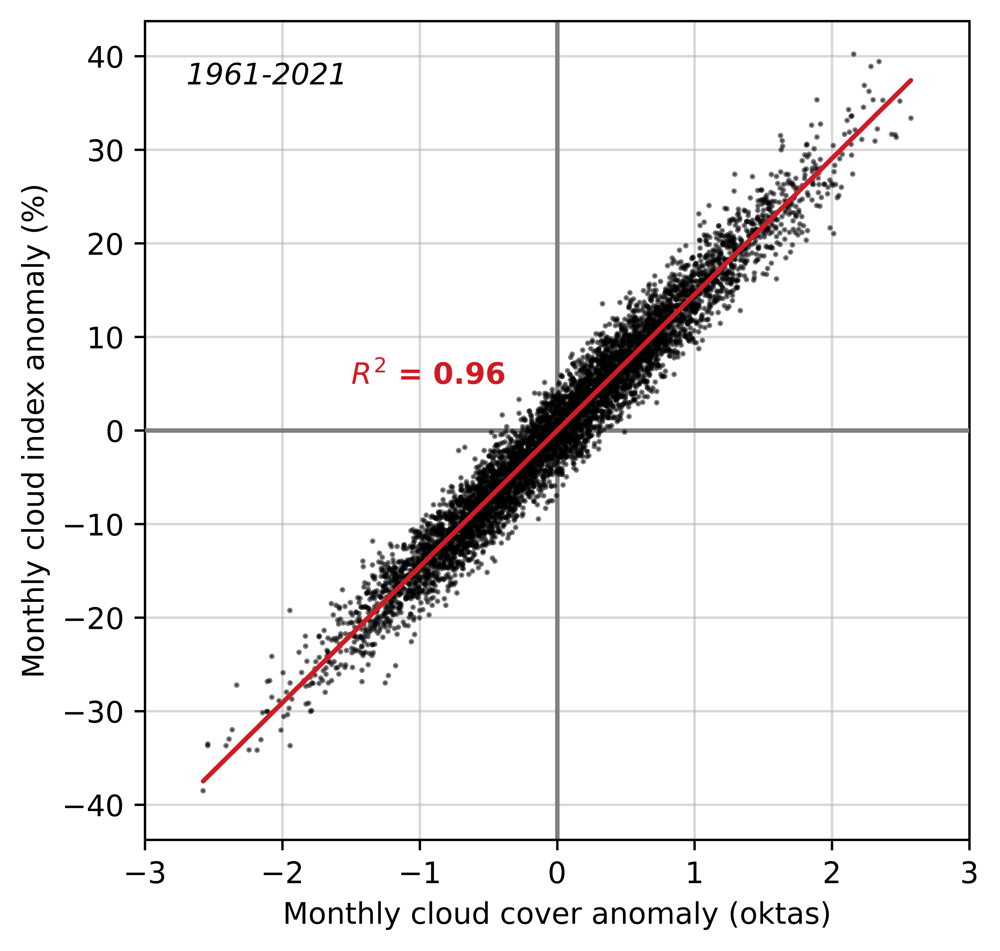



CHANGE WORKING DIRECTORY TO: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


In [15]:
#grafico

print(f"CHANGE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print(f"PLOT FIG 2")
f_cor_CI_media_anomalias_paper(medias_mensuales_anomalias_smn, CI_mensuales_anomalias, estaciones_ordenadas)

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE WORKING DIRECTORY TO: {0}".format(cwd))


In [16]:
def f_cor_PC_media_anomalias_paper(medias_dict, PC_dict, estaciones):
    
    #nombre_estacion = estaciones[id_estacion]
    ides_estaciones = list(estaciones.keys())
    
    #datos
    x_1 = medias_dict[ides_estaciones[0]][0].values
    y_1 = PC_dict[ides_estaciones[0]][0].values
    
    #datos 2
    x_2 = medias_dict[ides_estaciones[1]][0].values
    y_2 = PC_dict[ides_estaciones[1]][0].values
    
    #datos 3
    x_3 = medias_dict[ides_estaciones[2]][0].values
    y_3 = PC_dict[ides_estaciones[2]][0].values
    
    #datos 4
    x_4 = medias_dict[ides_estaciones[3]][0].values
    y_4 = PC_dict[ides_estaciones[3]][0].values
    
    #datos 5
    x_5 = medias_dict[ides_estaciones[4]][0].values
    y_5 = PC_dict[ides_estaciones[4]][0].values
    
    #datos 6
    x_6 = medias_dict[ides_estaciones[5]][0].values
    y_6 = PC_dict[ides_estaciones[5]][0].values
    
    #datos 7
    x_7 = medias_dict[ides_estaciones[6]][0].values
    y_7 = PC_dict[ides_estaciones[6]][0].values
    
    #datos 8
    x_8 = medias_dict[ides_estaciones[7]][0].values
    y_8 = PC_dict[ides_estaciones[7]][0].values
    
    #datos 9
    x_9 = medias_dict[ides_estaciones[8]][0].values
    y_9 = PC_dict[ides_estaciones[8]][0].values
    
    x = np.concatenate((x_1, x_2, x_3, x_4, x_5, x_6, x_7, x_8, x_9))
    y = np.concatenate((y_1, y_2, y_3, y_4, y_5, y_6, y_7, y_8, y_9))
    #calculo recta de regresion
    idx = np.isfinite(x) & np.isfinite(y)
    m, b = np.polyfit(x[idx], y[idx], 1) #m = slope, b=intercept
    
    #str con ecuacion
    if b > 0:
        ecuacion = f"PC={round(m, 3)}*TCC+{round(b,3)}"
    elif b == 0:
        ecuacion = f"PC={round(m, 3)}*TCC"
    else:
        ecuacion = f"PC={round(m, 3)}*TCC{round(b,3)}"
    
    #calculo R2
    correlation = np.corrcoef(x[idx], y[idx])[0,1]
    r_squared = correlation**2

    fig=plt.figure(num=1, figsize=(5, 5), dpi=1000) #genero figura
    fig.patch.set_facecolor('white')
    ax = plt.gca()
    ax.patch.set_facecolor('white')
    
    ax.scatter(x_1, y_1, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_2, y_2, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_3, y_3, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_4, y_4, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_5, y_5, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_6, y_6, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_7, y_7, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_8, y_8, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    ax.scatter(x_9, y_9, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
    
    ax.plot(x, m*x + b, c = "#D01B25", zorder = 5)
    ax.text(-1.5, 5, '$R^2$ = %0.2f' % r_squared, c= "#D01B25", fontweight = 800, zorder = 6)
    #ax.text(-2.5, 10, ecuacion, c= "#D01B25", fontsize = 10, zorder = 6)
    ax.hlines(0, xmin = -3, xmax = 3, color = "grey", zorder = 3)
    ax.vlines(0, ymin = -43.75, ymax = 43.75, color = "grey", zorder = 2)
    
    ax.set_xlabel('Monthly cloud cover anomaly (oktas)')
    ax.set_ylabel(f'Monthly parameter of cloudiness anomaly (%)')
     
    plt.ylim(-43.75, 43.75)
    plt.xlim(-3, 3)
    ax.grid(alpha = 0.5, zorder = 1)
    #ax.annotate(nombre_estacion, (-2.7, 38), size = 17, style='italic', zorder = 7)
    ax.annotate("1961-2021", (-2.7, 37), size = 10, style='italic', zorder = 7)
    plt.savefig(f"figura2_cor_PC_media_mensual.png")
    plt.show()

CHANGE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


PLOT FIG 2 b


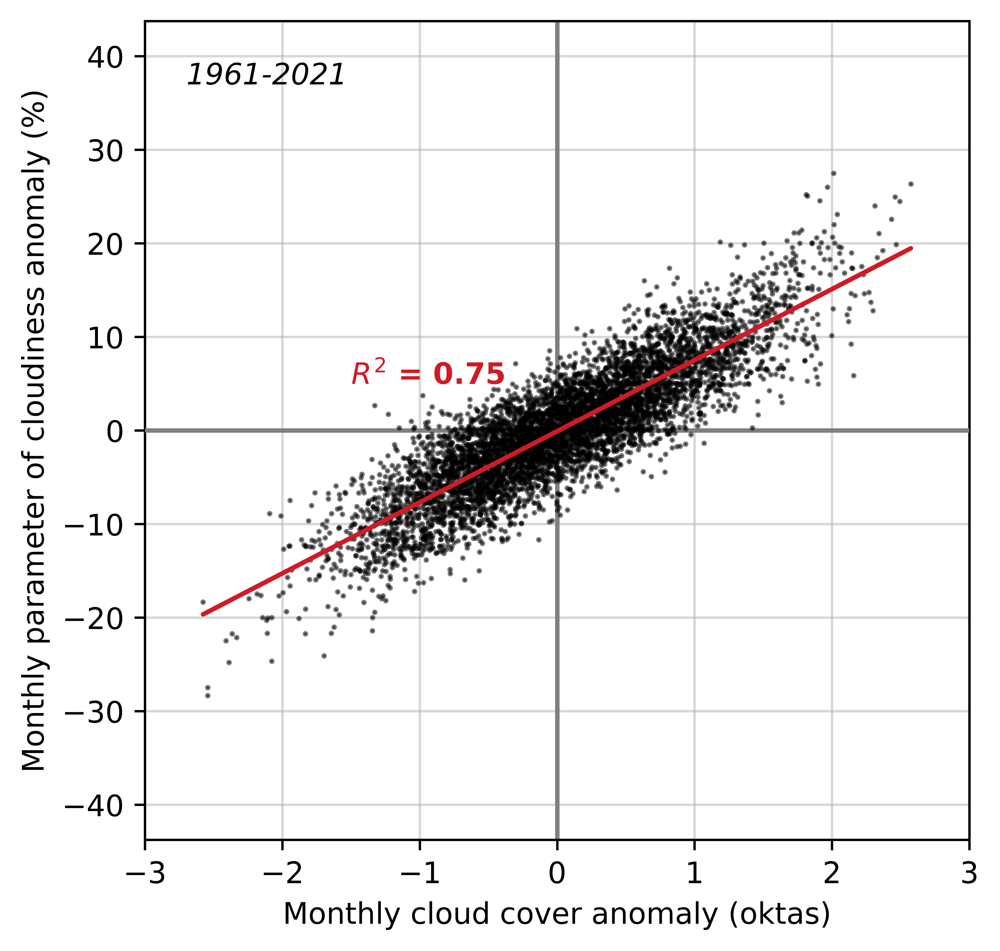



CHANGE WORKING DIRECTORY TO: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


In [17]:
#grafico PC

print(f"CHANGE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print(f"PLOT FIG 2 b")
f_cor_PC_media_anomalias_paper(medias_mensuales_anomalias_smn, PC_mensuales_anomalias, estaciones_ordenadas)

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE WORKING DIRECTORY TO: {0}".format(cwd))


In [18]:
#imprimo r2 de cada estacion entre medias mensuales y los guardo en una tabla
r_cuadrado_CI_TCC_estaciones = {}
def f_cor_CI_media_anomalias_paper_valores(medias_dict, CI_dict, estaciones):
    for i, id_estacion in enumerate(estaciones_ordenadas.keys()):
        nombre_estacion = estaciones[id_estacion]

        #datos
        x_i = medias_dict[id_estacion][0].values
        y_i = CI_dict[id_estacion][0].values

        #calculo recta de regresion
        idx = np.isfinite(x_i) & np.isfinite(y_i)
        m, b = np.polyfit(x_i[idx], y_i[idx], 1) #m = slope, b=intercept

        #calculo R2
        correlation = np.corrcoef(x_i[idx], y_i[idx])[0,1]
        r_squared = correlation**2

        r_cuadrado_CI_TCC_estaciones[nombre_estacion] = r_squared
        

f_cor_CI_media_anomalias_paper_valores(medias_mensuales_anomalias_smn, CI_mensuales_anomalias, estaciones_ordenadas)
print(r_cuadrado_CI_TCC_estaciones)

#lo paso a dataframe y lo guardo
r_cuadrado_CI_TCC_estaciones_df = pd.DataFrame([r_cuadrado_CI_TCC_estaciones])
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE r_cuadrado_CI_TCC_estaciones_df as r_cuadrado_CI_TCC_estaciones_df.csv")
r_cuadrado_CI_TCC_estaciones_df.to_csv("r_cuadrado_CI_TCC_estaciones_df.csv")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


{'Roque Saenz Peña': 0.9551454480139954, 'Resistencia': 0.9496137727973162, 'Corrientes': 0.9525107075678049, 'Posadas': 0.9578795137814422, 'Oberá': 0.954470097270044, 'Reconquista': 0.957523656438543, 'Paso de los Libres': 0.9564433092833656, 'Montecaseros': 0.9553210058651506, 'Concordia': 0.9548020816110039}
CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE r_cuadrado_CI_TCC_estaciones_df as r_cuadrado_CI_TCC_estaciones_df.csv


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


### Figura 3

### Calculo las frecuencias relativas mensuales de cada okta

Se calcula la frecuencia relativa mensual para todos los meses que cuenten con mas del 80% de datos no faltantes. 

In [19]:
data_frecuencias_relativas_mensuales = {} #genero diccionario donde se van a guardar las frecuencias relativas mensuales

#para cada id_omm_ordenado
for id_omm in ides_omm_ordenado:
    frecuencia_relativa_mensual = f_frecuencia_oktas_por_mes(id_omm, datos_smn[id_omm])[1]
    #lo acomodo en diccionarios
    data_frecuencias_relativas_mensuales[id_omm] = frecuencia_relativa_mensual

print("Se generaro diccionario con data frames de frecuencias relativas mensuales de cada okta para cada estacion")
print("Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:")
print("-----------------") 
print("Frecuencias relativas mensuales:")
print(data_frecuencias_relativas_mensuales[87166].iloc[0:3])
print("-----------------") 

#lo paso a dataframe y lo guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

#guardo la informacion de cada estacion en un csv
for codigo in ides_omm_ordenado:
    print(f"SAVE TCC_monthly_relative_frequency_of_each_okta_value_{codigo} as TCC_monthly_relative_frequency_of_each_okta_value_{codigo}.csv")
    globals()[f"TCC_monthly_relative_frequency_of_each_okta_value_{codigo}"] = data_frecuencias_relativas_mensuales[codigo]
    #guardo dataframe
    globals()[f"TCC_monthly_relative_frequency_of_each_okta_value_{codigo}"].to_csv(f"TCC_monthly_relative_frequency_of_each_okta_value_{codigo}.csv")
    
print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


Se generaro diccionario con data frames de frecuencias relativas mensuales de cada okta para cada estacion
Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:
-----------------
Frecuencias relativas mensuales:
                    0          1          2          3         4          5  \
fecha                                                                         
1961-11-01   8.000000  12.000000   8.000000  12.000000  4.000000   8.000000   
1961-12-01  19.354839  19.354839  12.903226   9.677419  6.451613  12.903226   
1962-01-01        NaN        NaN        NaN        NaN       NaN        NaN   

                    6          7         8  
fecha                                       
1961-11-01  24.000000  20.000000  4.000000  
1961-12-01   6.451613   6.451613  6.451613  
1962-01-01        NaN        NaN       NaN  
-----------------
CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE TCC_

### Calculo la media climatológica de las frecuencias relativas mensuales de cada okta

In [20]:
climatologia_frecuencias_relativas_mensuales = {} #genero diccionario donde se van a guardar las climatologias de frecuencias relativas mensuales

for id_omm in ides_omm_ordenado:
    frecuencia_relativa_mensual = data_frecuencias_relativas_mensuales[id_omm]
    frecuencia_relativa_mensual.index = pd.to_datetime(frecuencia_relativa_mensual.index)
    frecuencia_relativa_mensual_fechas_climatologia = frecuencia_relativa_mensual.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    frecuencia_relativa_mensual_climatologia = frecuencia_relativa_mensual_fechas_climatologia.groupby(frecuencia_relativa_mensual_fechas_climatologia.index.month).mean() 
    #Lo guardo en diccionario: climatologia_frecuencias_relativas_mensuales
    climatologia_frecuencias_relativas_mensuales[id_omm] = frecuencia_relativa_mensual_climatologia
    #Si sumo la frecuencia media de cada okta en cada mes suma suma 100%. Es decir: tomo enero y sumo la frecuencia relativa de cada okta. Y así *
    for i in range(0,12):
        if sum(frecuencia_relativa_mensual_climatologia.iloc[i]) > 98: continue
        else: print(f"Para la estacion: {id_omm}. La suma de las frecuencias en el mes {i+1}no es mayor a 98")

print("Se generaro diccionario con data frames de frecuencias relativas mensuales climatologicas de cada okta para cada estacion")
print("Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:")
print("-----------------") 
print("Frecuencias relativas mensuales:")
print(climatologia_frecuencias_relativas_mensuales[87166])
print("-----------------") 

#guardo la informacion de cada estacion en un csv
#lo paso a dataframe y lo guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

for codigo in ides_omm_ordenado:
    print(f"SAVE TCC_monthly_relative_frequency_of_each_okta_value_climatology_{codigo} as TCC_monthly_relative_frequency_of_each_okta_value_climatology_{codigo}.csv")
    globals()[f"TCC_monthly_relative_frequency_of_each_okta_value_climatology_{codigo}"] = climatologia_frecuencias_relativas_mensuales[codigo]
    #guardo dataframe
    globals()[f"TCC_monthly_relative_frequency_of_each_okta_value_climatology_{codigo}"].to_csv(f"TCC_monthly_relative_frequency_of_each_okta_value_climatology_{codigo}.csv")
    
print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


Se generaro diccionario con data frames de frecuencias relativas mensuales climatologicas de cada okta para cada estacion
Cada elemento de ese diccionario (un elemento por estacion) tiene esta pinta:
-----------------
Frecuencias relativas mensuales:
               0          1          2          3          4          5  \
fecha                                                                     
1       8.406647  16.617791  13.782991  11.925709  11.730205  10.752688   
2       7.822063  17.446634  14.804448  11.374832  11.050157   9.064786   
3      10.948192  20.527859  13.587488   8.797654   9.775171  11.436950   
4      16.767677  12.222222   8.888889   8.585859   9.797980  10.909091   
5      15.835777  12.609971   9.872923  11.632454   8.895406  10.263930   
6      12.929293  10.606061   8.181818   7.979798   7.676768  11.515152   
7      20.723363   9.970674  11.045943   8.504399   9.188661   9.286413   
8      23.264907  11.241447  10.263930   7.331378   9.090909  10.557185   

### Calculo la media regional de la media climatológica de las frecuencias mensuales de cada okta

In [21]:
climatologia_frecuencias_relativas_mensuales_media_espacial = (climatologia_frecuencias_relativas_mensuales[ides_omm_ordenado[0]]+climatologia_frecuencias_relativas_mensuales[ides_omm_ordenado[1]]+climatologia_frecuencias_relativas_mensuales[ides_omm_ordenado[2]]+climatologia_frecuencias_relativas_mensuales[ides_omm_ordenado[3]]+climatologia_frecuencias_relativas_mensuales[ides_omm_ordenado[4]]+climatologia_frecuencias_relativas_mensuales[ides_omm_ordenado[5]]+climatologia_frecuencias_relativas_mensuales[ides_omm_ordenado[6]]+climatologia_frecuencias_relativas_mensuales[ides_omm_ordenado[7]]+climatologia_frecuencias_relativas_mensuales[ides_omm_ordenado[8]])/9

### Grafico

In [22]:
def f_barplot_oktas_separadas_climatologia_media_espacial(frecuencias,
                                         colores = f_paletas_colores.paleta_3_colores_divergentes,
                                         anio_inicio=1983, anio_final=2016):
    
    meses = ['J', 'F', 'M', 'A', 'M', "J", "J", "A", "S", "O","N", "D"] #inicial meses
    oktas = [0, 1, 2, 3, 4, 5, 6, 7, 8]
    fig, ax = plt.subplots(3, 3, figsize=[7, 6], dpi=1000)
    fig.patch.set_facecolor('white')
    ylim = 22
    colores = ["#3c3c3c", "#3c3c3c", "#3c3c3c"] #unify the colors

    for i in range(0, 3):
                for j in range(0, 3):
                    
                    ax[i, j].bar(frecuencias.index,np.array(frecuencias).transpose()[3*i+j], 
                                 color = colores[i], width = 0.9, zorder = 2)
                    ax[i, j].set_ylim((0,ylim))
                    ax[i, j].set_yticks(np.arange(0,ylim+1, ylim//5))
                    ax[i, j].set_title(f"Okta = {oktas[3*i+j]}", size = 11)
                
                    if j == 0: #solo para los del lateral izquierdo pongo el ylabel
                        ax[i, j].set_ylabel("Frequency %")
                    else:
                        ax[i, j].set_yticklabels([])
                    if i == 2: #solo para los de abajo pongo el xlabel
                        ax[i, j].set_xlabel("Month")
                        
                        ax[i,j].set_xticks(frecuencias.index)
                        ax[i,j].set_xticklabels(meses)
                        #ax[i,j].set_xticklabels(frecuencias.index)
                    else:
                        ax[i,j].set_xticks(frecuencias.index)
                        ax[i, j].set_xticklabels([])
                    ax[i,j].grid(axis = "y", alpha=0.5, zorder = 1)
    
    fig.tight_layout()
    plt.savefig(f"figura3_paper_climatologia_frecuencia_relativa_barplot_oktas_separadas_NEA.png") 
    plt.show()    

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


PLOT FIGURE 3


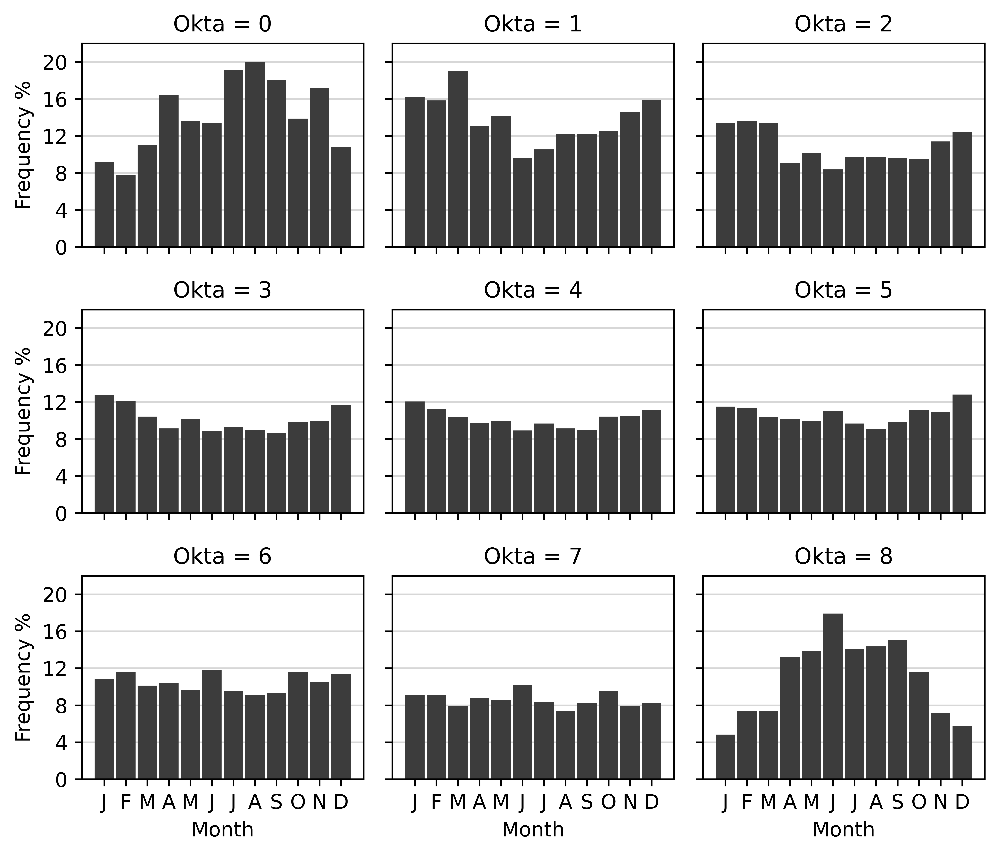



CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


In [23]:
#grafico
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("PLOT FIGURE 3")
f_barplot_oktas_separadas_climatologia_media_espacial(frecuencias = climatologia_frecuencias_relativas_mensuales_media_espacial,
                                     colores = f_paletas_colores.paleta_3_colores_divergentes,
                                     anio_inicio = fecha_inicio_climatologia_str[0:4], 
                                     anio_final = fecha_final_climatologia_str[0:4])
print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


### Make the same plot but one panel per month 


In [24]:
frecuencias = climatologia_frecuencias_relativas_mensuales_media_espacial
i=1
j=1
np.array(frecuencias)[3*i+j]
frecuencias.transpose().index

RangeIndex(start=0, stop=9, step=1)

In [25]:
def f_barplot_oktas_separadas_climatologia_media_espacial_panelesmensuales(frecuencias,
                                         colores = f_paletas_colores.paleta_3_colores_divergentes,
                                         anio_inicio=1983, anio_final=2016):
    
    meses = ['Jan', 'Feb', 'Mar', 'Apr', 'May', "Jun", "Jul", "Aug", "Sep", "Oct","Nov", "Dec"] #inicial meses
    oktas = [0, 1, 2, 3, 4, 5, 6, 7, 8]
    fig, ax = plt.subplots(4, 3, figsize=[6, 7], dpi=1000)
    fig.patch.set_facecolor('white')
    ylim = 22
    colores = ["#3c3c3c", "#3c3c3c", "#3c3c3c", "#3c3c3c"] #unify the colors

    for i in range(0, 4):
                for j in range(0, 3):
                    
                    ax[i, j].bar(frecuencias.transpose().index,np.array(frecuencias)[3*i+j], 
                                 color = colores[i], width = 0.9, zorder = 2)
                    ax[i, j].set_ylim((0,ylim))
                    ax[i, j].set_yticks(np.arange(0,ylim+1, ylim//5))
                    ax[i, j].set_title(f"{meses[3*i+j]}", size = 11)
                
                    if j == 0: #solo para los del lateral izquierdo pongo el ylabel
                        ax[i, j].set_ylabel("Frequency %")
                    else:
                        ax[i, j].set_yticklabels([])
                    if i == 3: #solo para los de abajo pongo el xlabel
                        ax[i, j].set_xlabel("Okta")
                        
                        ax[i,j].set_xticks(oktas)
                        ax[i,j].set_xticklabels(oktas)
                        #ax[i,j].set_xticklabels(frecuencias.index)
                    else:
                        ax[i,j].set_xticks(oktas)
                        ax[i, j].set_xticklabels([])
                    ax[i,j].grid(axis = "y", alpha=0.5, zorder = 1)
    
    fig.tight_layout()
    plt.savefig(f"figura3_paper_climatologia_frecuencia_relativa_barplot_oktas_separadas_NEA_panelesmensuales.png") 
    plt.show()    

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


PLOT FIGURE 3


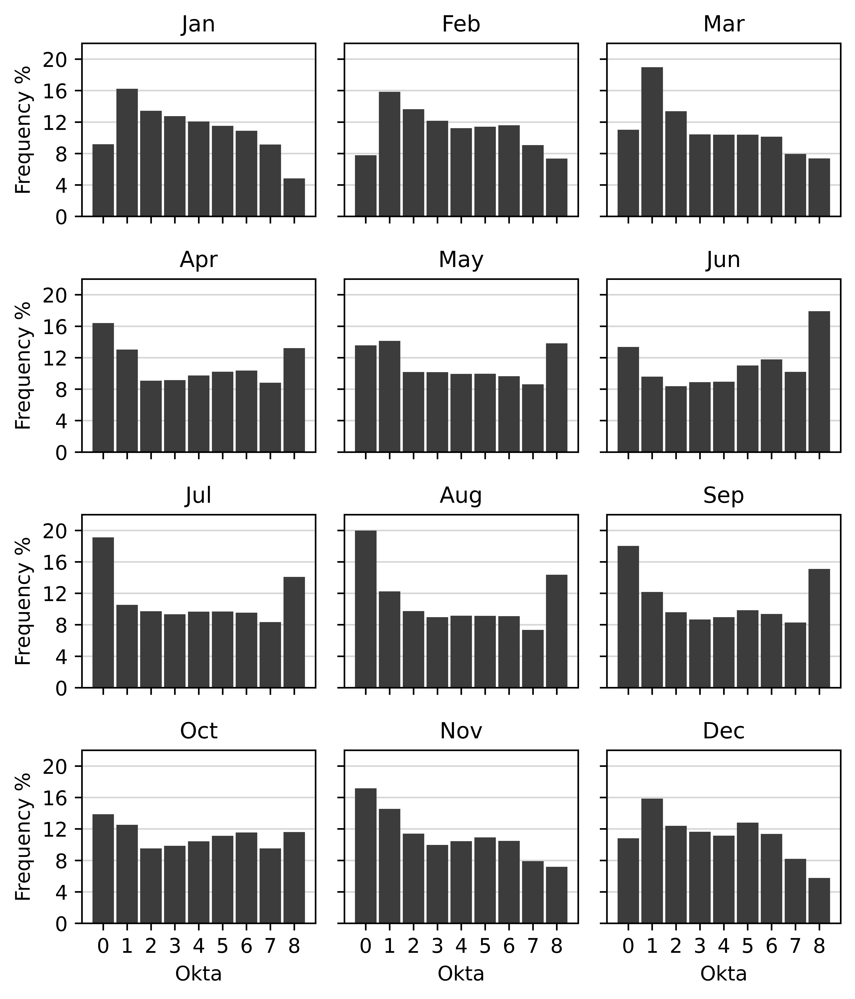



CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


In [26]:
#grafico
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("PLOT FIGURE 3")
f_barplot_oktas_separadas_climatologia_media_espacial_panelesmensuales(frecuencias = climatologia_frecuencias_relativas_mensuales_media_espacial,
                                     colores = f_paletas_colores.paleta_3_colores_divergentes,
                                     anio_inicio = fecha_inicio_climatologia_str[0:4], 
                                     anio_final = fecha_final_climatologia_str[0:4])
print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


### Figure 3.b (not shown in paper)

### Calculo climatologia de las medias mensuales de nubosidad SMN

In [27]:
climatologia_medias_mensuales_smn_media_regional = (climatologia_medias_mensuales_smn[ides_omm_ordenado[0]]+climatologia_medias_mensuales_smn[ides_omm_ordenado[1]]+climatologia_medias_mensuales_smn[ides_omm_ordenado[2]]+climatologia_medias_mensuales_smn[ides_omm_ordenado[3]]+climatologia_medias_mensuales_smn[ides_omm_ordenado[4]]+climatologia_medias_mensuales_smn[ides_omm_ordenado[5]]+climatologia_medias_mensuales_smn[ides_omm_ordenado[6]]+climatologia_medias_mensuales_smn[ides_omm_ordenado[7]]+climatologia_medias_mensuales_smn[ides_omm_ordenado[8]])/9

### Calculo climatologia media mensual media regional de CA ISCCP-H

Lo hago en la region delimitada en la figura 1: 

* lon=slice(299, 306) --> lon: [299.5, 300.5, 301.5, 302.5, 303.5, 304.5, 305.5]
* lat=slice(-32,-25) --> lat: [-31.5, -30.5, -29.5, -28.5, -27.5, -26.5, -25.5]

Primero hago la climatologia (media mensual climatológica) para cada punto y luego los promedio

In [28]:
#calculo la media climatologica mensual para todos los puntos
isccp_mensual_climatologia = {mes: isccp_mensual.cldamt[pd.DatetimeIndex(isccp_mensual.time.values).month == mes].mean(dim = ["time"], skipna=True) for mes in range(1,13)}

#calculo el promedio regional
isccp_mensual_climatologia_media_regional = [float(isccp_mensual_climatologia[mes].mean(skipna=True).values) for mes in range(1,13)]

#lo convierto a data frame para que tenga la misma pinta que el de smn
isccp_mensual_climatologia_media_regional = pd.DataFrame(isccp_mensual_climatologia_media_regional)
isccp_mensual_climatologia_media_regional.index = [1,2,3,4,5,6,7,8,9,10,11,12]

### Grafico climatologia de las medias mensuales de nubosidad SMN y ISCCP-H

####### Manejo de directorios #######


se para en el directorio llamado: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper




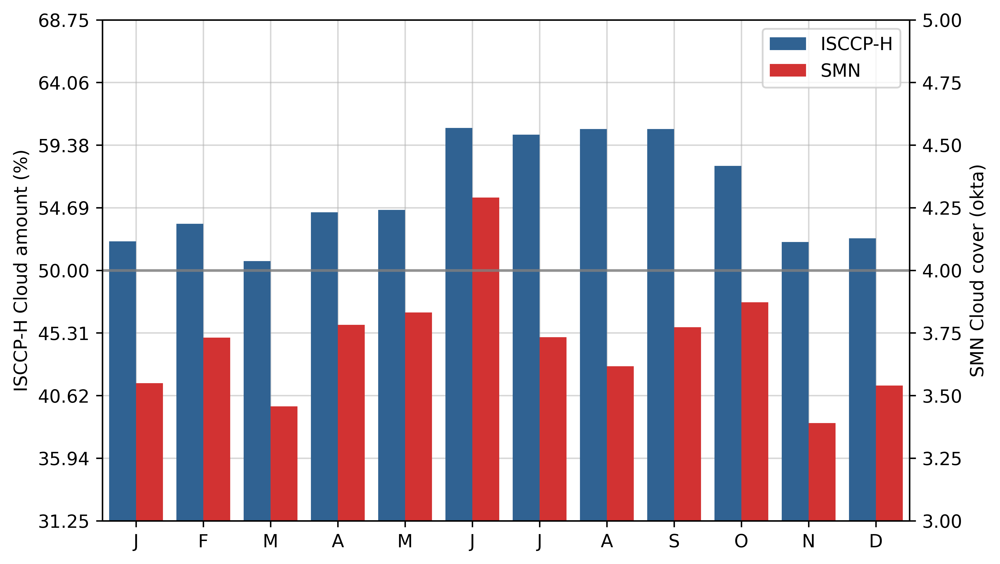



Vuelvo a directorio principal. Ahora el directorio de trabajo es: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


####### Fin de manejo de directorios #######


In [29]:
#grafico
print("####### Manejo de directorios #######")
print("\n")
print(f"se para en el directorio llamado: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

f_barplot_media_mensual_ISCCP_y_SMN_climatologia_media_espacial(isccp_mensual_climatologia_media_regional, climatologia_medias_mensuales_smn_media_regional)
print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("Vuelvo a directorio principal. Ahora el directorio de trabajo es: {0}".format(cwd))
print("\n")
print("####### Fin de manejo de directorios #######")



### Figure 4

[-60.5, -54.5, -31.5, -25.5]

In [30]:
# Calculo media anual en periodo climatológico de SMN

climatologia_anual_medias_mensuales_smn = {} 
#para cada id_omm_ordenado
for id_omm in ides_omm_ordenado:
    #calculo climatologia
    media_mensual_df = medias_mensuales_smn[id_omm]
    media_mensual_df.index = pd.to_datetime(media_mensual_df.index)
    media_mensual_fechas_climatologia = media_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    media_mensual_climatologia_anual = media_mensual_fechas_climatologia.mean() 
    #Lo guardo en diccionario: climatologia_anual_medias_mensuales_smn
    climatologia_anual_medias_mensuales_smn[id_omm] = media_mensual_climatologia_anual
    

In [31]:
#%% Lista puntos smn que efectivamente uso
#me quedo solo con los puntos de estaciones que efectivamente uso
lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)
lista_puntos_smn_ordenados
list(estaciones_ordenadas.values())[0]

'Roque Saenz Peña'

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE FIGURE 4.11


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


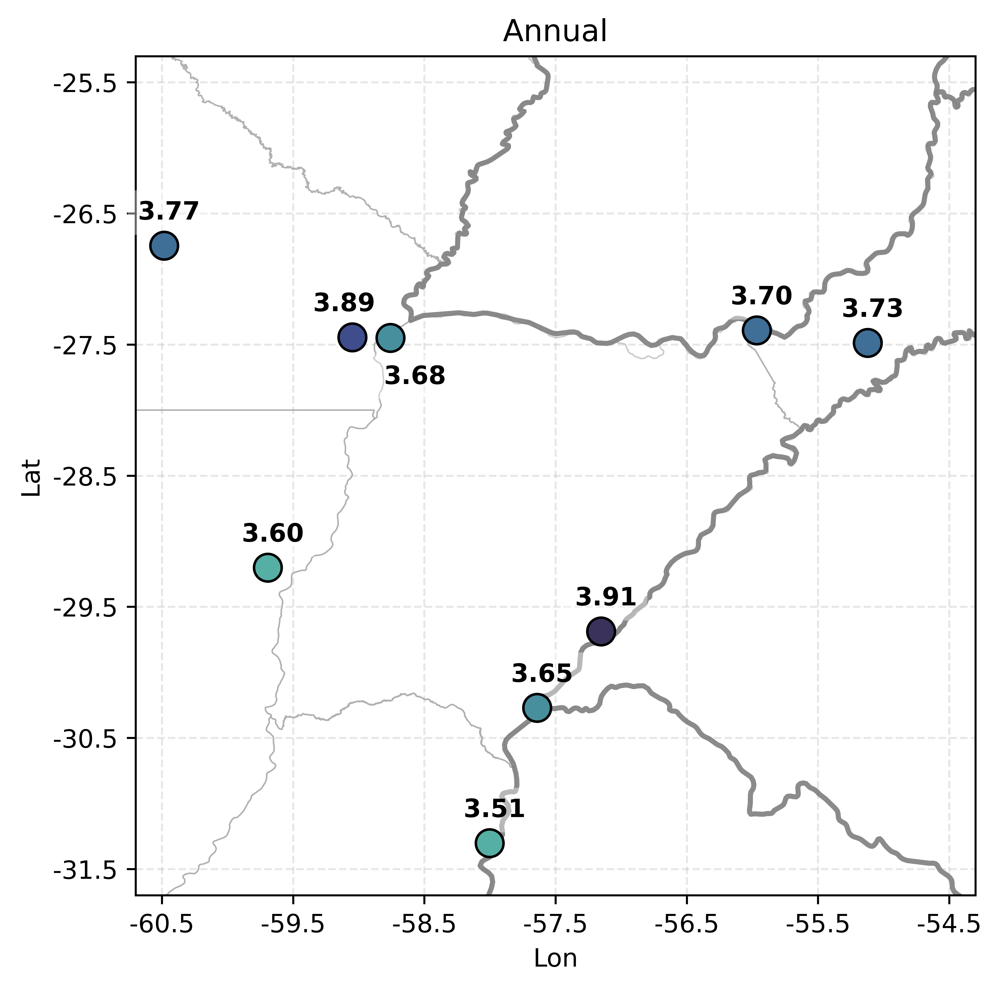

In [32]:
from f_mis_shapes import df_paises, df_provincias
import geopandas as gpd
from shapely.geometry import Point
import cartopy.crs as ccrs
import cmocean 
import matplotlib as mpl

valor_minimo = 3.2
valor_maximo = 4.1
xticks_min = -60.5
xticks_max = -54.5
yticks_min = -31.5
yticks_max = -25.5
espacio_entre_lat_lon = 1
medias_anuales_estaciones_ordenadas = [climatologia_anual_medias_mensuales_smn[i].values[0] for i in ides_omm_ordenado]

#defino puntos a marcar
geometry_3 = [Point(xy) for xy in lista_puntos_smn_ordenados] #lista con puntos 2
geodata3 = gpd.GeoDataFrame(lista_puntos_smn_ordenados, geometry = geometry_3)
geodata3["valores"] = medias_anuales_estaciones_ordenadas

fig1 = plt.figure(figsize = [9.6, 6], dpi = 900)   
fig1.patch.set_facecolor('white')
ax = fig1.add_subplot(111, projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

#agrego geometrias de fondo: provincias y paises
ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

##esto para discretizar la paleta:

#
mi_cmap = cmocean.cm.deep # define the colormap  rain
# extract all colors from the .rain map
mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
# create the new map
mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', mi_cmaplist, mi_cmap.N)
# define the bins and normalize
bounds = np.linspace(valor_minimo, valor_maximo, 10)
norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
##fin de discretizado de paleta

#grafico puntos
#geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
 #             markersize = 200, cmap=cmocean.cm.rain, zorder=3,legend=True, ax = ax) #limites de 0 a 8

geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
              markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, edgecolor = "k") #limites de 0 a 8

#agrego etiquetas con valores
list_smn_etiquetas = [(lon-0.2-360, lat+0.25) for lon, lat in lista_puntos_smn_ordenados]
for i, clave in enumerate(medias_anuales_estaciones_ordenadas):
    if list(estaciones_ordenadas.values())[i] != "Corrientes" and list(estaciones_ordenadas.values())[i] != "Resistencia":
        if len(str(round(clave,2))) == 4:
           etiq = str(round(clave,2))
        elif len(str(round(clave,2))) == 3:
           etiq = str(round(clave,2)) + str(0)
        t = ax.annotate(etiq, (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
    elif list(estaciones_ordenadas.values())[i] == "Corrientes":
        if len(str(round(clave,2))) == 4:
           etiq = str(round(clave,2))
        elif len(str(round(clave,2))) == 3:
           etiq = str(round(clave,2)) + str(0)
        t = ax.annotate(etiq, (list_smn_etiquetas[i][0]+0.15,list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
    else:
        if len(str(round(clave,2))) == 4:
           etiq = str(round(clave,2))
        elif len(str(round(clave,2))) == 3:
           etiq = str(round(clave,2)) + str(0)
        t = ax.annotate(etiq,(list_smn_etiquetas[i][0]-0.1,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
    
    t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

#agrego titulo a colorbar
#trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
#ann = ax.annotate('Okta', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

#seteo ejes
ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
ax.set_xticklabels(np.arange(xticks_min, xticks_max+1))
plt.xticks(np.arange(xticks_min, xticks_max+1))
ax.set_xlabel("Lon")
ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
ax.set_yticklabels(np.arange(yticks_min, yticks_max+1))
plt.yticks(np.arange(yticks_min, yticks_max+1))
ax.set_ylabel("Lat")

plt.title("Annual")
plt.grid(linestyle="--", alpha=0.3)

#la guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE FIGURE 4.11")
plt.savefig("figura4_11_prueba.png")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


### Hago esto por estacion

In [33]:
# Calculo medias estacionales en periodo climatológico de SMN
climatologia_estacion_medias_mensuales_smn = {} 
#para cada id_omm_ordenado
for id_omm in ides_omm_ordenado:
    #calculo climatologia
    media_mensual_df = medias_mensuales_smn[id_omm]
    media_mensual_df.index = pd.to_datetime(media_mensual_df.index)
    media_mensual_fechas_climatologia = media_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    media_mensual_climatologia_DJF = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 12) | (media_mensual_fechas_climatologia.index.month == 1) | (media_mensual_fechas_climatologia.index.month == 2)]).mean()
    media_mensual_climatologia_MAM = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 3) | (media_mensual_fechas_climatologia.index.month == 4) | (media_mensual_fechas_climatologia.index.month == 5)]).mean()
    media_mensual_climatologia_JJA = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 6) | (media_mensual_fechas_climatologia.index.month == 7) | (media_mensual_fechas_climatologia.index.month == 8)]).mean()
    media_mensual_climatologia_SON = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 9) | (media_mensual_fechas_climatologia.index.month == 10) | (media_mensual_fechas_climatologia.index.month == 11)]).mean()
    media_mensual_climatologia_estacional = {"DJF": media_mensual_climatologia_DJF, "MAM":media_mensual_climatologia_MAM, "JJA":media_mensual_climatologia_JJA, "SON":media_mensual_climatologia_SON}
    climatologia_estacion_medias_mensuales_smn[id_omm] = media_mensual_climatologia_estacional



CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE FIGURE 4.12


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


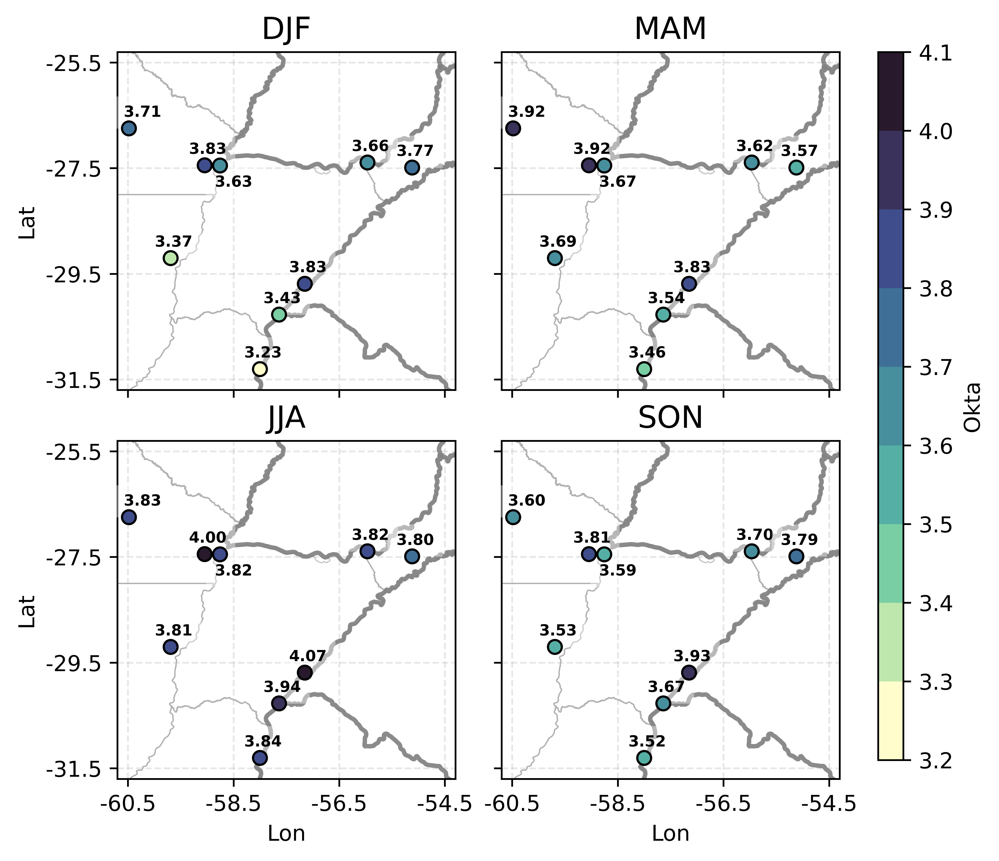

In [34]:
estaciones = ["DJF", "MAM", "JJA", "SON"]
posicion = [221, 222, 223, 224]
medias_DJF_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["DJF"].values[0] for i in ides_omm_ordenado]
medias_MAM_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["MAM"].values[0] for i in ides_omm_ordenado]
medias_JJA_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["JJA"].values[0] for i in ides_omm_ordenado]
medias_SON_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["SON"].values[0] for i in ides_omm_ordenado]
medias_estaciones_ordenadas_list = [medias_DJF_estaciones_ordenadas,medias_MAM_estaciones_ordenadas,medias_JJA_estaciones_ordenadas,medias_SON_estaciones_ordenadas]

valor_minimo = 3.2
valor_maximo = 4.1
xticks_min = -60.5
xticks_max = -54.5
yticks_min = -31.5
yticks_max = -25.5
espacio_entre_lat_lon = 1
#fig1, ax = plt.subplots(2, 2, figsize=[9, 7], dpi=600)
fig1 = plt.figure(figsize = [8, 6], dpi = 900) 
fig1.patch.set_facecolor('white')
for i in range(0,4):
    ax = fig1.add_subplot(posicion[i], projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

    #agrego geometrias de fondo: provincias y paises
    ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
    ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

    #defino puntos a marcar
    geometry_3 = [Point(xy) for xy in lista_puntos_smn_ordenados] #lista con puntos 2
    geodata3 = gpd.GeoDataFrame(lista_puntos_smn_ordenados, geometry = geometry_3)
    geodata3["valores"] = medias_estaciones_ordenadas_list[i]

    mi_cmap = cmocean.cm.deep # define the colormap  rain
    # extract all colors from the .rain map
    mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
    # create the new map
    mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
        'Custom cmap', mi_cmaplist, mi_cmap.N)
    # define the bins and normalize
    bounds = np.linspace(valor_minimo, valor_maximo, 10)
    norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
    ##fin de discretizado de paleta

    #grafico puntos
    #geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
    #              markersize = 200, cmap=cmocean.cm.rain, zorder=3,legend=True, ax = ax) #limites de 0 a 8

    geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                  markersize = 40, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, edgecolor = "k") #limites de 0 a 8

    #agrego etiquetas con valores
    list_smn_etiquetas = [(lon-0.3-360, lat+0.30) for lon, lat in lista_puntos_smn_ordenados]
    for j, clave in enumerate(medias_estaciones_ordenadas_list[i]):
        if list(estaciones_ordenadas.values())[j] != "Resistencia" and list(estaciones_ordenadas.values())[j] != "Corrientes" and list(estaciones_ordenadas.values())[j] != "Roque Saenz Peña":
            if len(str(round(clave,2))) == 4:
               etiq = str(round(clave,2))
            elif len(str(round(clave,2))) == 3:
               etiq = str(round(clave,2)) + str(0)
            t = ax.annotate(etiq, (list_smn_etiquetas[j][0],list_smn_etiquetas[j][1]-0.08), size = 7,weight='bold', zorder = 3)
        elif list(estaciones_ordenadas.values())[j] == "Corrientes":
            if len(str(round(clave,2))) == 4:
               etiq = str(round(clave,2))
            elif len(str(round(clave,2))) == 3:
               etiq = str(round(clave,2)) + str(0)
            t = ax.annotate(etiq, (list_smn_etiquetas[j][0]+0.2,list_smn_etiquetas[j][1]-0.7), size = 7,weight='bold', zorder = 3)
        elif list(estaciones_ordenadas.values())[j] == "Roque Saenz Peña":
            if len(str(round(clave,2))) == 4:
               etiq = str(round(clave,2))
            elif len(str(round(clave,2))) == 3:
               etiq = str(round(clave,2)) + str(0)
            t = ax.annotate(etiq, (list_smn_etiquetas[j][0]+0.2,list_smn_etiquetas[j][1]-0.08), size = 7,weight='bold', zorder = 3)
        
        else:
            if len(str(round(clave,2))) == 4:
               etiq = str(round(clave,2))
            elif len(str(round(clave,2))) == 3:
               etiq = str(round(clave,2)) + str(0)
            t = ax.annotate(etiq, (list_smn_etiquetas[j][0],list_smn_etiquetas[j][1]-0.08) , size = 7,weight='bold', zorder = 3)
        t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

    #agrego titulo a colorbar
    #trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
    #ann = ax.annotate('Okta', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

    #seteo ejes
    ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
    plt.xticks(np.arange(xticks_min, xticks_max+1, 2))
    if i == 0 or i == 1: #saco levels de x para los dos graficos de arriba
        ax.set_xticklabels([])
    else:
        ax.set_xticklabels(np.arange(xticks_min, xticks_max+1, 2))
        ax.set_xlabel("Lon")
    
    
    ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
    plt.yticks(np.arange(yticks_min, yticks_max+1, 2))
    if i == 1 or i == 3: #saco levels de x para los dos graficos de la derecha
        ax.set_yticklabels([])
    else:
        ax.set_yticklabels(np.arange(yticks_min, yticks_max+1, 2))
        ax.set_ylabel("Lat")
    ax.grid(linestyle="--", alpha=0.3)
    ax.set_title(estaciones[i], size= 14)
    
#fig1.subplots_adjust(right=0.8)
fig1.subplots_adjust(wspace=-0.35,hspace=0.15)
cbar_ax = fig1.add_axes([0.83, 0.13, 0.02, 0.75])

sm = plt.cm.ScalarMappable(cmap=mi_cmap2, norm=norm)
# fake up the array of the scalar mappable. Urgh...
sm._A = []
fig1.colorbar(sm, cax=cbar_ax,label = "Okta")

#la guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE FIGURE 4.12")
plt.savefig("figura4_12.png")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))
            

### satelite

In [35]:
#uso datos de isccp que tienen una lon y lat mas para cada lado, para que se pueda interpolar en los bordes
#del grafico
climatologia_anual_isccp=isccp_mensual_grande.cldamt.mean(dim="time")

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE FIGURE 4.21


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


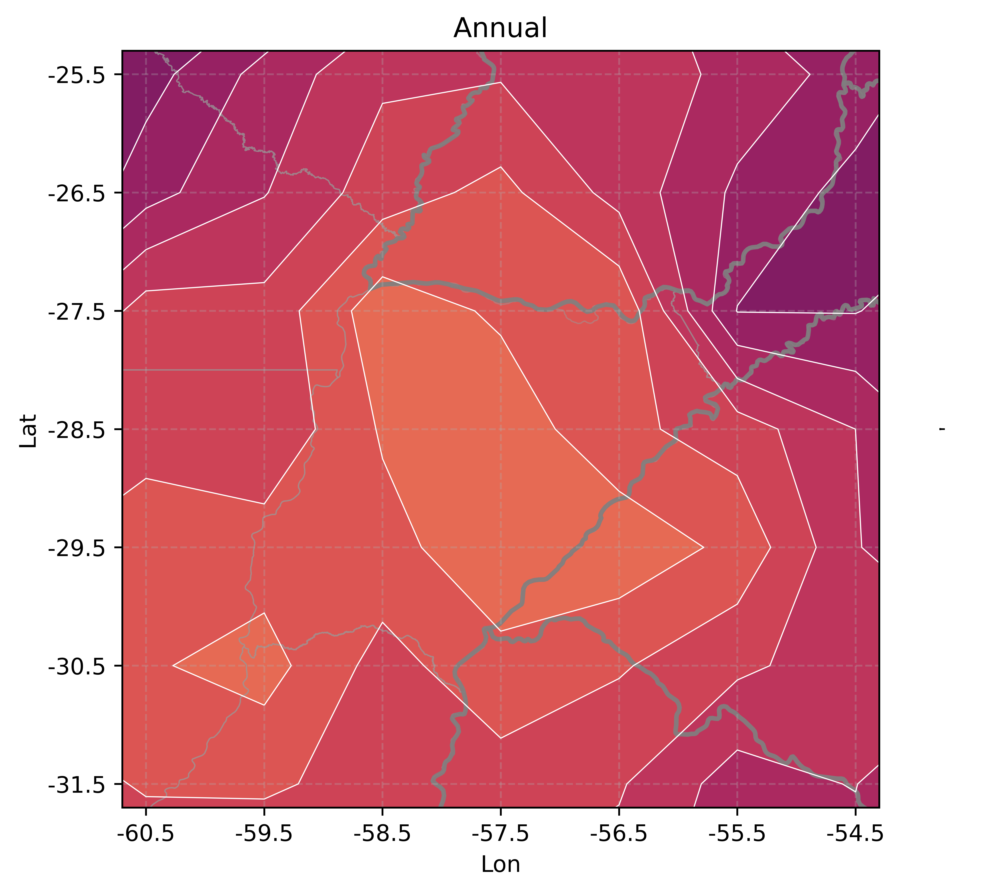

In [36]:
import geopandas
from cartopy.io import shapereader
from shapely.geometry.multipolygon import MultiPolygon
import cmocean
import pandas as pd
import xarray as xr
import numpy as np
from shapely.geometry import mapping, Polygon
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import pymannkendall as mk
from f_mis_shapes import df_paises, df_provincias

plt.close()

xrdata = climatologia_anual_isccp
valor_minimo = 47
valor_maximo = 65
delta_valor = 1

xticks_min = -60.5
xticks_max = -54.5
yticks_min = -31.5
yticks_max = -25.5
espacio_entre_lat_lon = 1

# selecciono region
#data_region = xrdata.loc[dict(lon=slice(360+lon_min, 360+lon_max),lat=slice(lat_min, lat_max))]
data_region = xrdata

#data = xrdata.loc[dict(lon=slice(360+lon_min, 360+lon_max),lat=slice(lat_min, lat_max))]
   
# ploteo 
fig3 = plt.figure(figsize=[9.6, 6], dpi=900)  #8.5, 5.5
fig3.patch.set_facecolor('white')            
ax = fig3.add_subplot(111, projection=ccrs.PlateCarree(central_longitude=0))

data_region.plot.contourf(ax=ax,levels=np.arange(valor_minimo, valor_maximo, delta_valor),extend='neither',
                                     transform=ccrs.PlateCarree(), cbar_kwargs = {'shrink':0.0001, "label":" ", "ticks": []},cmap=cmocean.cm.matter)

data_region.plot.contour(ax=ax,levels=np.arange(valor_minimo, valor_maximo, delta_valor),extend='neither',
                                     linewidths=0.5, transform=ccrs.PlateCarree(),colors='white')

ax.set_facecolor('tab:gray')

ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.6', linewidth = 0.6, alpha = 0.5)
ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.5', linewidth = 2, alpha = 0.7)

#ax.add_geometries(df_provincias(), crs=ccrs.PlateCarree(), facecolor='none',edgecolor='0.5', linewidth=0.7, alpha=0.9)
#ax.add_geometries(df_paises(), crs=ccrs.PlateCarree(), facecolor='none',edgecolor='0.4', alpha=0.9)
#ax.coastlines(color='0.3')

#seteo ejes
ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
ax.set_xticklabels(np.arange(xticks_min, xticks_max+1))
plt.xticks(np.arange(xticks_min, xticks_max+1))
ax.set_xlabel("Lon")
ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
ax.set_yticklabels(np.arange(yticks_min, yticks_max+1))
plt.yticks(np.arange(yticks_min, yticks_max+1))
ax.set_ylabel("Lat")

plt.title("Annual")
plt.grid(linestyle="--", alpha=0.3)

#la guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE FIGURE 4.21")
plt.savefig("figura4_21.png")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))

plt.show()

### por estacion

In [37]:
# Calculo medias estacionales en periodo climatológico de SMN
climatologia_estacion_isccp = {} 
isccp_mensual_DJF = isccp_mensual_grande.cldamt[(pd.to_datetime(isccp_mensual.time.values).month == 12) | (pd.to_datetime(isccp_mensual.time.values).month == 1) | (pd.to_datetime(isccp_mensual.time.values).month == 2)].mean(dim = "time")
isccp_mensual_MAM = isccp_mensual_grande.cldamt[(pd.to_datetime(isccp_mensual.time.values).month == 3) | (pd.to_datetime(isccp_mensual.time.values).month == 4) | (pd.to_datetime(isccp_mensual.time.values).month == 5)].mean(dim = "time")
isccp_mensual_JJA = isccp_mensual_grande.cldamt[(pd.to_datetime(isccp_mensual.time.values).month == 6) | (pd.to_datetime(isccp_mensual.time.values).month == 7) | (pd.to_datetime(isccp_mensual.time.values).month == 8)].mean(dim = "time")
isccp_mensual_SON = isccp_mensual_grande.cldamt[(pd.to_datetime(isccp_mensual.time.values).month == 9) | (pd.to_datetime(isccp_mensual.time.values).month == 10) | (pd.to_datetime(isccp_mensual.time.values).month == 11)].mean(dim = "time")
isccp_climatologia_estacional = {"DJF": isccp_mensual_DJF, "MAM":isccp_mensual_MAM, "JJA":isccp_mensual_JJA, "SON":isccp_mensual_SON}


CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE FIGURE 4.22


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


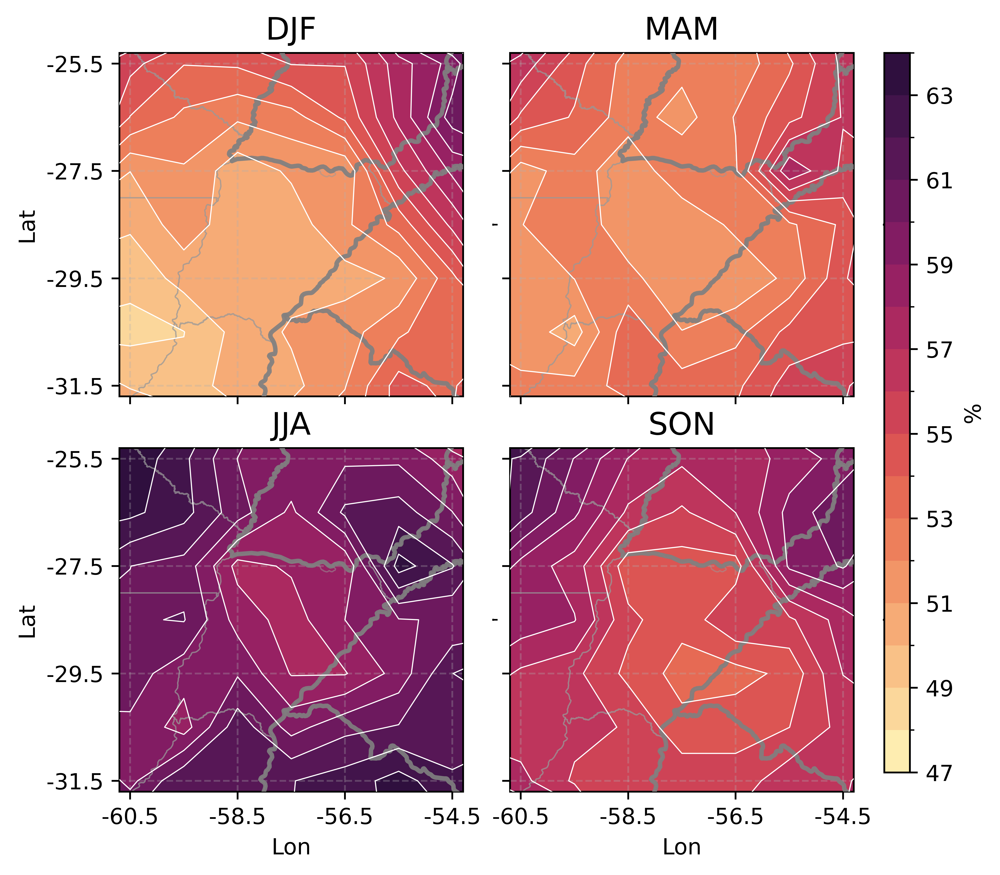

In [38]:
estaciones = ["DJF", "MAM", "JJA", "SON"]
posicion = [221, 222, 223, 224]
isccp_climatologia_estacional_list = list(isccp_climatologia_estacional.values())  

#fig1, ax = plt.subplots(2, 2, figsize=[9, 7], dpi=600)
fig1 = plt.figure(figsize = [8, 6], dpi = 900) 
fig1.patch.set_facecolor('white')
valor_minimo = 47
valor_maximo = 65
delta_valor = 1
xticks_min = -60.5
xticks_max = -54.5
yticks_min = -31.5
yticks_max = -25.5
espacio_entre_lat_lon = 1
for i in range(0,4):
    ax = fig1.add_subplot(posicion[i], projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

    #agrego geometrias de fondo: provincias y paises
    ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 2)
    ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 3)
    
    #grafico contornos
    im = isccp_climatologia_estacional_list[i].plot.contourf(ax=ax,levels=np.arange(valor_minimo, valor_maximo, delta_valor),extend='neither',
                                     transform=ccrs.PlateCarree(), zorder = 1, cbar_kwargs = {'shrink':0.0001, "label":" ", "ticks": []},cmap=cmocean.cm.matter)

    isccp_climatologia_estacional_list[i].plot.contour(ax=ax,levels=np.arange(valor_minimo, valor_maximo, delta_valor),extend='neither',
                                     linewidths=0.5, zorder = 4, transform=ccrs.PlateCarree(),colors='white')

    ax.set_facecolor('tab:gray')
   
    #seteo ejes
    ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
    plt.xticks(np.arange(xticks_min, xticks_max+1, 2))
    if i == 0 or i == 1: #saco levels de x para los dos graficos de arriba
        ax.set_xticklabels([])
        ax.set_xlabel(" ")
    else:
        ax.set_xticklabels(np.arange(xticks_min, xticks_max+1, 2))
        ax.set_xlabel("Lon")
        
    ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
    plt.yticks(np.arange(yticks_min, yticks_max+1, 2))
    if i == 1 or i == 3: #saco levels de x para los dos graficos de la derecha
        ax.set_yticklabels([])
        ax.set_ylabel(" ")
    else:
        ax.set_yticklabels(np.arange(yticks_min, yticks_max+1, 2))
        ax.set_ylabel("Lat")
    ax.grid(linestyle="--", alpha=0.3)
    ax.set_title(estaciones[i], size= 14)
    
#fig1.subplots_adjust(right=0.8)
#agrego colorbar
fig1.subplots_adjust(wspace=-0.35,hspace=0.15)
cbar_ax = fig1.add_axes([0.83, 0.13, 0.02, 0.75])
fig1.colorbar(im, cax=cbar_ax,label = "%")

#la guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE FIGURE 4.22")
plt.savefig("figura4_22.png")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


### Tablas de contingencia

Tablas de contingencia anuales:

* primero para cada estacion y su punto de grilla de satelite más cercano

* luego para la media regional

* convierto % a oktas siguiendo la tabla de boers 2010


In [39]:
#armo funcion que testea y devuelve un coef de contingencia de la tabla de contingencia a partir de ella y de una tabla teorica
def testeo_tabla_contingencia(tabla, tabla_teorica, alpha = 0.05):
    comparacion_casillero = []
    for i in range(0, 9):
        for j in range(0, 9):
            if tabla_teorica[i][j] == 0:
                comparacion_casillero.append(0.0)
            else: 
                comparacion_casillero.append((tabla[i][j]-tabla_teorica[i][j])**2/tabla_teorica[i][j])
    chi_cuadrado_observado = sum(comparacion_casillero)
    numero_filas = 9
    # numero_columnas = 9
    if alpha == 0.1:
        chi_cuadrado_teorico = 74.397 #lo saco de tabla para grados de libertad = (numero_filas - 1)  (numero_columnas - 1) = 8 * 8 = 64 (aproximo por 60 g.l que es lo que hay en la tabla)
    elif alpha == 0.05:
        chi_cuadrado_teorico = 79.082
    elif alpha == 0.01:
        chi_cuadrado_teorico = 88.3794 #lo saco de tabla para grados de libertad = (numero_filas - 1)  (numero_columnas - 1) = 8 * 8 = 64 (aproximo por 60 g.l que es lo que hay en la tabla)
    else:
        print("Solo se pueden ingresar alpha = 0.1 0.05 y 0.01. Se va a computar alpha = 0.05")
        alpha = 0.05
        chi_cuadrado_teorico = 79.082 #lo saco de tabla para grados de libertad = (numero_filas - 1)  (numero_columnas - 1) = 8 * 8 = 64 (aproximo por 60 g.l que es lo que hay en la tabla)    
    n = tabla["count"]["count"] #tamanio de la muestra
    k = numero_filas
    coef_de_contingencia = np.sqrt(chi_cuadrado_observado / (chi_cuadrado_observado + n))
    coef_de_contingencia_maximo = np.sqrt((k - 1) / k)
    coeficiente_de_contingencia_normalizado = coef_de_contingencia / coef_de_contingencia_maximo
    #print("####################################")
    #print("######## EXPLICO TEST #########")
    #print(f"Si Chi_2_observado es mayor que Chi_2_teorico entonces rechazo la siguiente hipótesis nula: \n ---> la tabla observada es igual a la tabla teorica al azar \n a favor de la hipotesis alternativa: \n ---> la tabla observada es distinta a la tabla teorica al azar \n entonces las variables estan relacionadas con un {1-alpha*100} % de confianza")
    #print("####################################")
    #print("######## EN ESTE CASO: #########")
    #print(f"En este caso: \n # Chi_2_observado = {chi_cuadrado_observado} \n # Chi_2_teorico = {chi_cuadrado_teorico} \n # alpha = {alpha}")
    #if chi_cuadrado_observado > chi_cuadrado_teorico:
    #    print(f"Entonces, con un {(1-alpha)*100}% de confianza, se rechaza la hipotesis nula a favor de la alternativa --> LAS VARIABLES ESTAN RELACIONADAS")
    #elif chi_cuadrado_observado <= chi_cuadrado_teorico:
    #    print(f"Entonces, con un {(1-alpha)*100}% de confianza, no se puede rechazar la hipotesis nula a favor de la alternativa --> NO SE PUEDE DECIR QUE LAS VARIABLES ESTEN RELACIONADAS")
    #print("####################################")
    #resumo info en una tabla que pueda guardar
    tabla_testeo_contingencia = pd.DataFrame(index=["Chi_2_observado", "Chi_2_teorico", "Alpha", "Rechaza H0 i.e las variables estan relacionadas", "Mensaje", "Coeficiente de contingencia normalizado"], columns = ["Resultado"])
    tabla_testeo_contingencia["Resultado"]["Chi_2_observado"] = float(str(chi_cuadrado_observado))
    tabla_testeo_contingencia["Resultado"]["Chi_2_teorico"] = float(str(chi_cuadrado_teorico))
    tabla_testeo_contingencia["Resultado"]["Alpha"] = float(str(alpha))
    if chi_cuadrado_observado > chi_cuadrado_teorico:
        tabla_testeo_contingencia["Resultado"]["Rechaza H0 i.e las variables estan relacionadas"] = "SI"
        tabla_testeo_contingencia["Resultado"]["Mensaje"] = f"Con un nivel de significancia {alpha}, se rechaza la hipotesis nula (la tabla de contingencia observada es igual a la tabla teórica al azar) a favor de la hipotesis alternativa (la tabla de contingencia observada es distinta a la tabla teórica al azar). Entonces, las variables están relacionadas con un {(1-alpha)*100}% de confianza"
    elif chi_cuadrado_observado <= chi_cuadrado_teorico:
        tabla_testeo_contingencia["Resultado"]["Rechaza H0 i.e las variables estan relacionadas"] = "NO"
        tabla_testeo_contingencia["Resultado"]["Mensaje"] = f"Con un nivel de significancia {alpha}, no se puede rechazar la hipotesis nula (la tabla de contingencia observada es igual a la tabla teórica al azar) a favor de la hipotesis alternativa (la tabla de contingencia observada es distinta a la tabla teórica al azar). Entonces, no se puede decir que las variables estén relacionadas con un {(1-alpha)*100}% de confianza"
    tabla_testeo_contingencia["Resultado"]["Coeficiente de contingencia normalizado"] = round(coeficiente_de_contingencia_normalizado, 3)
    return tabla_testeo_contingencia

In [40]:
#armo funcion que genera la tabla de contingencia para la estacion ID_estacion a partir de un datafram 
#datos del smn y otro con los datos de satelite del punto mas cercano pasado a okta
def generar_tabla_contingencia(ID_estacion, data_frame_smn, fecha_inicio_str, fecha_final_str, 
                               data_frame_cldamt_punto, lon, lat, alpha = 0.05, 
                               estaciones = False):
    
    instancia_serie_satelital = dataframe_satelite(data_frame_cldamt_punto).genero_serie("cldamt_oktas", fecha_inicio_str, fecha_final_str) #uso clases de c_clases_satelite
    instancia_serie_smn = dataframe_smn(data_frame_smn).genero_serie(0, fecha_inicio_str, fecha_final_str) #uso clases de c_clases_smn
    if instancia_serie_smn.es_diario():
        unico_data_frame = pd.concat([instancia_serie_satelital.paso_hora_a_cero(), instancia_serie_smn.paso_hora_a_cero()], axis = 1)#, join = "inner")
    else:
        unico_data_frame = pd.concat([instancia_serie_satelital.paso_mes_a_uno(), instancia_serie_smn.paso_mes_a_uno()], axis = 1)#, join = "inner")
    unico_data_frame.columns=["ISCCP", "SMN"] #armo un unico dataframe con ambos datos
    
    if estaciones == False: #si el analisis es anual
        #genero dataframe tabla (la tabla de contingencia)
        tabla = pd.DataFrame(0, index=[0, 1, 2, 3, 4, 5, 6, 7, 8, "count"], columns = [0, 1, 2, 3, 4, 5, 6, 7, 8, "count"])
        indices = unico_data_frame.index 
        for fecha in indices: #completo tabla
            if np.sum(pd.isna(unico_data_frame.loc[str(fecha)]).values) == 0 :
                for i in range(0,9):
                    if int(unico_data_frame.loc[str(fecha)]["SMN"]) == i:
                        tabla[i]["count"] += 1
                        for j in range(0,9):
                            if unico_data_frame.loc[str(fecha)]["ISCCP"] == j :
                                tabla["count"][j] += 1
                                tabla[i][j] += 1
        tabla["count"]["count"] = sum (tabla["count"])
        
        #Armo el porcentaje de casos de exito, de exito con diferencia de 1 okta, con diferencia de 2 oktas, con mas de 3 oktas overestimated, y con mas de 3 oktas under
        #esa informacion queda guardada en la variable: tabla_porcentajes
        band_0 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if i==j])/tabla["count"]["count"], 5)
        over_band_1 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j == i+1])/tabla["count"]["count"], 5)
        under_band_1 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j == i-1])/tabla["count"]["count"], 5)
        over_band_2 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j == i+2])/tabla["count"]["count"], 5)
        under_band_2 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j == i-2])/tabla["count"]["count"], 5)
        over_band_3 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j >= i+3])/tabla["count"]["count"], 5)
        under_band_3 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j <= i-3])/tabla["count"]["count"], 5)
        tabla_porcentajes = pd.DataFrame({"band_0": [band_0], "over_band_1" : [over_band_1], 
                                          "over_band_2" : [over_band_2], "over_band_3" : [over_band_3], 
                                          "under_band_1" : [under_band_1], 
                                          "under_band_2" : [under_band_2], 
                                          "under_band_3": [under_band_3]})        
        
        #creo tabla teorica al azar para testear la tabla de contingecia observada
        #esta queda guardada en tabla_teorica
        tabla_teorica = pd.DataFrame(0, index=[0, 1, 2, 3, 4, 5, 6, 7, 8], columns = [0, 1, 2, 3, 4, 5, 6, 7, 8])
        for i in range(0,9):
            for j in range(0,9):
                tabla_teorica[i][j] = tabla[i]["count"]*tabla[j]["count"]/tabla["count"]["count"]
        
        #testeo la tabla con la funcion testeo_tabla_contingencia
        tabla_testeo = testeo_tabla_contingencia(tabla, tabla_teorica, alpha)
        return({"TablaContingencia":tabla, "TablaPorcentajes":tabla_porcentajes, "TablaTesteo":tabla_testeo})
        #guardo todo en un mismo xlsx
        #writer = pd.ExcelWriter(f"tablas_contingencia_{lon}_{lat}_{ID_estacion}.xlsx", engine='xlsxwriter')   
        #tabla.to_excel(writer,sheet_name='Tabla')   
        #tabla_porcentajes.to_excel(writer, sheet_name = "Tabla porcentajes")
        #tabla_teorica.to_excel(writer,sheet_name='Tabla teorica')  
        #tabla_testeo.to_excel(writer,sheet_name='Tabla testeo')  
        #writer.save()
    
    #elif estaciones == True:
        
        #estacion = [["DJF", "MAM"], ["JJA", "SON"]]
        #estacion_meses = [[(12, 1, 2), (3, 4, 5)], [(6, 7, 8), (9, 10, 11)]]
        #
        #tablas = {}
        #tablas_teoricas = {}
        #tablas_testeo = {}
        #
        #band_0 = []
        #over_band_1 = []
        #over_band_2 = []
        #over_band_3 = []
        #under_band_1 = []
        #under_band_2 = []
        #under_band_3 = []
        #
        #for j in range(0, 2):
         #   for i in range(0, 2):
         #       tabla = pd.DataFrame(0, index = [0, 1, 2, 3, 4, 5, 6, 7, 8, "count"], columns = [0, 1, 2, 3, 4, 5, 6, 7, 8, "count"])
         #       
         #       mes1 = estacion_meses[j][i][0]
         #       mes2 = estacion_meses[j][i][1]
         #       mes3 = estacion_meses[j][i][2]
         #       data = pd.concat([unico_data_frame[unico_data_frame.index.month == mes1],
         #                        unico_data_frame[unico_data_frame.index.month == mes2],
         #                        unico_data_frame[unico_data_frame.index.month == mes3]])
         #       indices = data.index
         #       for fecha in indices:
         #           if np.sum(pd.isna(data.loc[str(fecha)]).values) == 0 :
         #               for m in range(0,9):
         #                   if int(data.loc[str(fecha)]["SMN"]) == m:
         #                       tabla[m]["count"] += 1
         #                       for n in range(0,9):
         #                           if data.loc[str(fecha)]["ISCCP"] == n :
         #                               tabla["count"][n] += 1
         #                               tabla[m][n] += 1
         #       tabla["count"]["count"] = sum (tabla["count"])       
         #       
         #       ### Armo el porcentaje de casos de exito, de exito con diferencia de 1 okta, con diferencia de 2 oktas, con mas de 3 oktas overestimated, y con mas de 3 oktas under
         #       band_0.append( round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if i==j])/tabla["count"]["count"], 3))
         #       over_band_1.append( round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j == i+1])/tabla["count"]["count"], 3))
         #       under_band_1.append( round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j == i-1])/tabla["count"]["count"], 3))
         #       over_band_2.append( round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j == i+2])/tabla["count"]["count"], 3))
         #       under_band_2.append( round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j == i-2])/tabla["count"]["count"], 3))
         #       over_band_3.append( round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j >= i+3])/tabla["count"]["count"], 3))
         #       under_band_3.append( round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j <= i-3])/tabla["count"]["count"], 3))
         #       
         #       tabla_teorica = pd.DataFrame(0, index=[0, 1, 2, 3, 4, 5, 6, 7, 8], columns = [0, 1, 2, 3, 4, 5, 6, 7, 8])
         #       for k in range(0,9):
         #           for l in range(0,9):
         #               tabla_teorica[k][l] = tabla[k]["count"]*tabla[l]["count"]/tabla["count"]["count"]
         #               
         #       tablas[estacion[j][i]] = tabla
         #       tablas_teoricas[estacion[j][i]] = tabla_teorica
         #       tablas_testeo[estacion[j][i]] = testeo_tabla_contingencia(tabla, tabla_teorica, alpha )
    
        #tabla_porcentajes = pd.DataFrame({"band_0": band_0, "over_band_1" : over_band_1, "under_band_1" : under_band_1, "over_band_2" : over_band_2, "under_band_2" : under_band_2, "over_band_3" : over_band_3, "under_band_3": under_band_3}, index = ["DJF", "MAM", "JJA", "SON"])        
        
        #guardo todo en un mismo xlsx
        #writer = pd.ExcelWriter(f"tablas_contingencia_estacional_{lon}_{lat}_{ID_estacion}.xlsx", engine='xlsxwriter')   
        #for j in range(0, 2):
        #    for i in range(0, 2):
        #        tablas[estacion[j][i]].to_excel(writer,sheet_name=f'Tabla {estacion[j][i]}')   
        #        tablas_teoricas[estacion[j][i]].to_excel(writer,sheet_name=f'Tabla teorica {estacion[j][i]}')  
        #        tablas_testeo[estacion[j][i]].to_excel(writer,sheet_name=f'Tabla testeo {estacion[j][i]}')  
        #tabla_porcentajes.to_excel(writer, sheet_name = "Tabla porcentajes")
        #writer.save()   


In [41]:
#busco el puntoo mas cercano a cada estacion
def puntos_cercanos(ID_estacion, dict_puntos_smn, lista_puntos_satelital, cantidad_puntos):
    """
    Genera lista con cantidad_puntos tuplas de (lon, lat) mas cercanos a estacion ID_estacion
    
    ID_estacion: ID OMM
    dict_puntos_smn: {estacion: (lon_smn, lat_smn)}
    lista_puntos_satelital: make_grid(lons_satelital, lats_satelital)
    cantidad_puntos: numero de puntos cercanos a estacion que se quieren obtener
    
    Salida: [(lon_sat, lat_sat),...] #donde lon_sat lat_sat son los mas cercanos a punto de estacion ID_estacion
    """

    lon_estacion = dict_puntos_smn[ID_estacion][0]
    lat_estacion = dict_puntos_smn[ID_estacion][1]

    distancia_a_estacion = {punto_sat : np.sqrt ((punto_sat[0]-lon_estacion)**2 + (punto_sat[1]-lat_estacion)**2) for punto_sat in lista_puntos_satelital}
    #lo ordeno
    distancia_a_estacion = {k: v for k, v in sorted(distancia_a_estacion.items(), key=lambda item: item[1])}
    puntos_distancia = list(distancia_a_estacion)[:cantidad_puntos] #tomo los mas cercanos
    return puntos_distancia


In [42]:
#armo las tablas para cada estacion

from f_porc_to_oktas import data_frame_oktas

#acomodo todo en un diccionario
tablas_contingencia_detalle_puntos_cercanos = {}
tablas_contingencia_anuales_estaciones_separadas = {}
for id_omm in list(estaciones_ordenadas.keys()):
    df_data_smn = medias_mensuales_smn[id_omm].round() #redondeo la media mensual en oktas
    data = isccp_mensual
    for punto_cercano in puntos_cercanos(id_omm, dict_puntos_smn, lista_puntos_satelital_mensual, 1): 
        #print(punto_cercano)
        lon = punto_cercano[0]
        lat = punto_cercano[1]
        
        df_data_satelital = data_frame_oktas(data, lon = lon, lat = lat) #satelital en oktas
        df_data_satelital.index = pd.to_datetime(df_data_satelital.index)
        
        tablas_contingencia_detalle_puntos_cercanos[id_omm] = {"lon": lon, "lat": lat}
        tablas_contingencia_anuales_estaciones_separadas[id_omm] = generar_tabla_contingencia(ID_estacion = id_omm, data_frame_smn = df_data_smn, 
                                                                       fecha_inicio_str = fecha_inicio_climatologia_str, 
                                                                       fecha_final_str = fecha_final_climatologia_str, 
                                                                       data_frame_cldamt_punto = df_data_satelital,
                                                                       lon = lon, lat = lat, alpha = 0.05, estaciones = False)
        
        
        

### Tabla 3.b

In [43]:
# ARMO TABLA 4.B: porcentajes en bandas para cada estacion, coeficiente de contingencia y significancia
#genero primera fila
id_omm = ides_omm_ordenado[0]
porcentajes = tablas_contingencia_anuales_estaciones_separadas[id_omm]["TablaPorcentajes"]*100
porcentajes = porcentajes.rename(index={0: id_omm})
coeficiente = tablas_contingencia_anuales_estaciones_separadas[id_omm]["TablaTesteo"].loc["Coeficiente de contingencia normalizado"]
coeficiente = coeficiente.rename(index={"Resultado": id_omm})
sign = tablas_contingencia_anuales_estaciones_separadas[id_omm]["TablaTesteo"].loc["Rechaza H0 i.e las variables estan relacionadas"]
sign = sign.rename(index={"Resultado": id_omm})
tablas_contingencia_por_estacion_resumen = pd.concat([porcentajes, coeficiente, sign], axis = 1)

for id_omm in ides_omm_ordenado[1:]:
    porcentajes = tablas_contingencia_anuales_estaciones_separadas[id_omm]["TablaPorcentajes"]*100
    porcentajes = porcentajes.rename(index={0: id_omm})
    coeficiente = tablas_contingencia_anuales_estaciones_separadas[id_omm]["TablaTesteo"].loc["Coeficiente de contingencia normalizado"]
    coeficiente = coeficiente.rename(index={"Resultado": id_omm})
    sign = tablas_contingencia_anuales_estaciones_separadas[id_omm]["TablaTesteo"].loc["Rechaza H0 i.e las variables estan relacionadas"]
    sign = sign.rename(index={"Resultado": id_omm})
    fila_nueva = pd.concat([porcentajes, coeficiente, sign], axis = 1)
    tablas_contingencia_por_estacion_resumen=tablas_contingencia_por_estacion_resumen.append(fila_nueva)

#tablas_contingencia_por_estacion_resumen
#la guardo como excel
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

# create excel writer
writer = pd.ExcelWriter("Table3b_tabla_contingencia_estaciones.xlsx")
# write dataframe to excel sheet named 'marks'
tablas_contingencia_por_estacion_resumen.to_excel(writer, 'info')
# save the excel file
writer.save()
print(f"SAVE TABLE 3b")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY TO:{0}".format(cwd))

AttributeError: 'DataFrame' object has no attribute 'append'

In [44]:
## hago la tabla de contingencia para la media regional
##esto no se expone en paper

##paso media regional de isccp a oktas

#from f_porc_to_oktas import porc_to_oktas
#isccp_mensual_media_regional = isccp_mensual.cldamt.mean(dim = ["lon", "lat"])
#isccp_mensual_media_regional_oktas = porc_to_oktas(isccp_mensual_media_regional) #satelital en oktas
##df_data_satelital.index = pd.to_datetime(df_data_satelital.index)
#fechas = [dt.datetime.strptime(str(fecha), "%Y-%m-%dT%H:%M:00.000000000") for fecha in isccp_mensual_media_regional.time.values]
#data_frame_isccp_mensual_media_regional=pd.DataFrame([fechas, isccp_mensual_media_regional.values, isccp_mensual_media_regional_oktas]).T
#data_frame_isccp_mensual_media_regional.columns = ["fecha","cldamt","cldamt_oktas"]
#data_frame_isccp_mensual_media_regional.set_index(keys = "fecha", drop = True, inplace = True)    
#
##calculo media regional de media mensual de smn
##medias_mensuales_smn_media_regional = (medias_mensuales_smn[ides_omm_ordenado[0]]+medias_mensuales_smn[ides_omm_ordenado[1]]+medias_mensuales_smn[ides_omm_ordenado[2]]+medias_mensuales_smn[ides_omm_ordenado[3]]+medias_mensuales_smn[ides_omm_ordenado[4]]+medias_mensuales_smn[ides_omm_ordenado[5]]+medias_mensuales_smn[ides_omm_ordenado[6]]+medias_mensuales_smn[ides_omm_ordenado[7]]+medias_mensuales_smn[ides_omm_ordenado[8]])/9
##medias_mensuales_smn_media_regional 
#
##junto dataframes de cada estacion en un unico dataframe:
#medias_mensuales_smn_df_estaciones = pd.concat([medias_mensuales_smn[ides_omm_ordenado[i]] for i in range(0,9)], axis=1)
##y calculo su promedio
#medias_mensuales_smn_media_regional = medias_mensuales_smn_df_estaciones.mean(axis=1, skipna=True) 
#medias_mensuales_smn_media_regional
#
##instancia_serie_satelital = dataframe_satelite(data_frame_isccp_mensual_media_regional).genero_serie("cldamt_oktas", fecha_inicio_str, fecha_final_str) #uso clases de c_clases_satelite
##instancia_serie_smn = dataframe_smn(medias_mensuales_smn_media_regional).genero_serie(0, fecha_inicio_str, fecha_final_str) #uso clases de c_clases_smn
##unico_data_frame = pd.concat([instancia_serie_satelital.paso_mes_a_uno(), instancia_serie_smn.paso_mes_a_uno()], axis = 1)#, join = "inner")
#
#instancia_serie_satelital = data_frame_isccp_mensual_media_regional[fecha_inicio_str: fecha_final_str]["cldamt_oktas"]
#instancia_serie_satelital.index = instancia_serie_satelital.index.to_period("M")
#instancia_serie_smn = medias_mensuales_smn_media_regional[fecha_inicio_str: fecha_final_str]
#instancia_serie_smn.index = instancia_serie_smn.index.to_period("M")
#unico_data_frame = pd.concat([instancia_serie_satelital, instancia_serie_smn], axis = 1)
#unico_data_frame.columns=["ISCCP", "SMN"]
#
##hago tabla de contingencia con media regional
#alpha = 0.05
##instancia_serie_satelital = dataframe_satelite(data_frame_isccp_mensual_media_regional).genero_serie("cldamt_oktas", fecha_inicio_str, fecha_final_str) #uso clases de c_clases_satelite
##instancia_serie_smn = dataframe_smn(medias_mensuales_smn_media_regional).genero_serie(0, fecha_inicio_str, fecha_final_str) #uso clases de c_clases_smn
##unico_data_frame = pd.concat([instancia_serie_satelital.paso_mes_a_uno(), instancia_serie_smn.paso_mes_a_uno()], axis = 1)#, join = "inner")
##unico_data_frame.columns=["ISCCP", "SMN"]
#
#instancia_serie_satelital = data_frame_isccp_mensual_media_regional[fecha_inicio_str: fecha_final_str]["cldamt_oktas"]
#instancia_serie_satelital.index = instancia_serie_satelital.index.to_period("M")
#instancia_serie_smn = medias_mensuales_smn_media_regional[fecha_inicio_str: fecha_final_str]
#instancia_serie_smn.index = instancia_serie_smn.index.to_period("M")
#unico_data_frame = pd.concat([instancia_serie_satelital, instancia_serie_smn], axis = 1)
#unico_data_frame.columns=["ISCCP", "SMN"]
#
#tabla = pd.DataFrame(0, index=[0, 1, 2, 3, 4, 5, 6, 7, 8, "count"], columns = [0, 1, 2, 3, 4, 5, 6, 7, 8, "count"])
#indices = unico_data_frame.index 
#for fecha in indices:
#    if np.sum(pd.isna(unico_data_frame.loc[str(fecha)]).values) == 0 :
#        for i in range(0,9):
#            if int(unico_data_frame.loc[str(fecha)]["SMN"]) == i:
#                tabla[i]["count"] += 1
#                for j in range(0,9):
#                    if unico_data_frame.loc[str(fecha)]["ISCCP"] == j :
#                        tabla["count"][j] += 1
#                        tabla[i][j] += 1
#tabla["count"]["count"] = sum (tabla["count"])
#        
### Armo el porcentaje de casos de exito, de exito con diferencia de 1 okta, con diferencia de 2 oktas, con mas de 3 oktas overestimated, y con mas de 3 oktas under
#band_0 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if i==j])/tabla["count"]["count"], 3)
#over_band_1 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j == i+1])/tabla["count"]["count"], 3)
#under_band_1 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j == i-1])/tabla["count"]["count"], 3)
#over_band_2 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j == i+2])/tabla["count"]["count"], 3)
#under_band_2 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j == i-2])/tabla["count"]["count"], 3)
#over_band_3 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j >= i+3])/tabla["count"]["count"], 3)
#under_band_3 = round(sum([tabla[i][j] for i in range(0,9) for j in range(0,9) if j <= i-3])/tabla["count"]["count"], 3)
#tabla_porcentajes = pd.DataFrame({"band_0": [band_0], "over_band_1" : [over_band_1], "under_band_1" : [under_band_1], "over_band_2" : [over_band_2], "under_band_2" : [under_band_2], "over_band_3" : [over_band_3], "under_band_3": [under_band_3]})        
###
#
##creo tabla teorica al azar para testear la tabla de contingecia observada
#tabla_teorica = pd.DataFrame(0, index=[0, 1, 2, 3, 4, 5, 6, 7, 8], columns = [0, 1, 2, 3, 4, 5, 6, 7, 8])
#for i in range(0,9):
#    for j in range(0,9):
#        tabla_teorica[i][j] = tabla[i]["count"]*tabla[j]["count"]/tabla["count"]["count"]
#
##cargo los resultados de testear la tabla con la tabla teorica
#tabla_testeo = testeo_tabla_contingencia(tabla, tabla_teorica, alpha )

### Tabla 3.a

Hago tabla que incluya todas las estaciones con su respectivo punto de grilla satelital más cercano, para eso sumo las tablas de contingencia de cada estacion

Luego calculo el porcentaje que cae en cada banda

Luego aplico el test para ver su significancia a la tabla final

In [45]:
tabla_anual_todas_las_estaciones = sum([tablas_contingencia_anuales_estaciones_separadas[ide]["TablaContingencia"] for ide in ides_omm_ordenado])

#guardo esta tabla
#la guardo como excel
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

# create excel writer
writer = pd.ExcelWriter("Table3a_tabla_contingencia.xlsx")
# write dataframe to excel sheet named 'marks'
tabla_anual_todas_las_estaciones.to_excel(writer, 'info')
# save the excel file
writer.save()
print(f"SAVE TABLE 3a")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY TO:{0}".format(cwd))

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper




AttributeError: 'XlsxWriter' object has no attribute 'save'

In [46]:
### Armo el porcentaje de casos de exito, de exito con diferencia de 1 okta, con diferencia de 2 oktas, con mas de 3 oktas overestimated, y con mas de 3 oktas under
band_0 = round(sum([tabla_anual_todas_las_estaciones[i][j] for i in range(0,9) for j in range(0,9) if i==j])/tabla_anual_todas_las_estaciones["count"]["count"], 5)
over_band_1 = round(sum([tabla_anual_todas_las_estaciones[i][j] for i in range(0,9) for j in range(0,9) if j == i+1])/tabla_anual_todas_las_estaciones["count"]["count"], 5)
under_band_1 = round(sum([tabla_anual_todas_las_estaciones[i][j] for i in range(0,9) for j in range(0,9) if j == i-1])/tabla_anual_todas_las_estaciones["count"]["count"], 5)
over_band_2 = round(sum([tabla_anual_todas_las_estaciones[i][j] for i in range(0,9) for j in range(0,9) if j == i+2])/tabla_anual_todas_las_estaciones["count"]["count"], 5)
under_band_2 = round(sum([tabla_anual_todas_las_estaciones[i][j] for i in range(0,9) for j in range(0,9) if j == i-2])/tabla_anual_todas_las_estaciones["count"]["count"], 5)
over_band_3 = round(sum([tabla_anual_todas_las_estaciones[i][j] for i in range(0,9) for j in range(0,9) if j >= i+3])/tabla_anual_todas_las_estaciones["count"]["count"], 5)
under_band_3 = round(sum([tabla_anual_todas_las_estaciones[i][j] for i in range(0,9) for j in range(0,9) if j <= i-3])/tabla_anual_todas_las_estaciones["count"]["count"], 5)
#armo df
tabla_porcentajes = pd.DataFrame({"band_0": [band_0], "over_band_1" : [over_band_1], 
                                          "over_band_2" : [over_band_2], "over_band_3" : [over_band_3], 
                                          "under_band_1" : [under_band_1], 
                                          "under_band_2" : [under_band_2], 
                                          "under_band_3": [under_band_3]})*100

#guardo esta tabla
#la guardo como excel
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

# create excel writer
writer = pd.ExcelWriter("Table3a_tabla_porcentajes.xlsx")
# write dataframe to excel sheet named 'marks'
tabla_porcentajes.to_excel(writer, 'info')
# save the excel file
writer.save()
print(f"SAVE TABLE 3a tabla_porcentajes")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY TO:{0}".format(cwd))


CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper




AttributeError: 'XlsxWriter' object has no attribute 'save'

In [47]:
#veo si es estadisticamente distinta a una tabla al azar y calculo el coeficiente de contingencia normalizado
#creo tabla teorica al azar para testear la tabla de contingecia observada
tabla_teorica = pd.DataFrame(0, index=[0, 1, 2, 3, 4, 5, 6, 7, 8], columns = [0, 1, 2, 3, 4, 5, 6, 7, 8])
for i in range(0,9):
    for j in range(0,9):
        tabla_teorica[i][j] = tabla_anual_todas_las_estaciones[i]["count"]*tabla_anual_todas_las_estaciones[j]["count"]/tabla_anual_todas_las_estaciones["count"]["count"]

#cargo los resultados de testear la tabla con la tabla teorica
tabla_testeo = testeo_tabla_contingencia(tabla_anual_todas_las_estaciones, tabla_teorica, alpha = 0.05)

#guardo esta tabla
#la guardo como excel
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

# create excel writer
writer = pd.ExcelWriter("Table3a_tabla_testeo.xlsx")
# write dataframe to excel sheet named 'marks'
tabla_testeo.to_excel(writer, 'info')
# save the excel file
writer.save()
print(f"SAVE TABLE 3a tabla_testeo")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY TO:{0}".format(cwd))

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper




AttributeError: 'XlsxWriter' object has no attribute 'save'

## PARTE 2 CAMBIOS 1983-2016

### Figura 5 y figura 7 

**Serie temporal con tendencia de theil-sen y medias moviles de media regional de monthly Cloud index en % or cloud mean in oktas y media regional de cloud amount %**

Figura5: con series crudas y separadas

Figura7: con series de anomalias estandarizadas y juntas: https://machinelearningmastery.com/normalize-standardize-time-series-data-python/ le resto la media y divido por el desvio. 

In [48]:
#calculo anomalias estandarizadas

############# CI ###############
#hago media regional
#junto dataframes de cada estacion en un unico dataframe:
data_CI_mensuales_df_estaciones = pd.concat([data_CI_mensuales[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)], axis=1)
#y calculo su promedio
CI_mensuales_media_regional = data_CI_mensuales_df_estaciones.mean(axis=1, skipna=True) 

#anomalias estandarizadas: para la serie de CI_mensuales_media_regional.
#A cada mes le resto la media cliamtologica y lo divido por el desvio climatologico de cada mes
#calculo estadisticos
CI_media_regional_medias_mensuales = [np.nanmean(CI_mensuales_media_regional[CI_mensuales_media_regional.index.month == mes][fecha_inicio_climatologia_str: fecha_final_climatologia_str]) for mes in range(1,13)]
CI_media_regional_std_mensuales = [np.nanstd(CI_mensuales_media_regional[CI_mensuales_media_regional.index.month == mes][fecha_inicio_climatologia_str: fecha_final_climatologia_str]) for mes in range(1,13)]
CI_media_regional_estadisticas_mensuales = pd.DataFrame(data=[CI_media_regional_medias_mensuales, CI_media_regional_std_mensuales]).transpose() 
CI_media_regional_estadisticas_mensuales.columns = ["mean", "std"]
CI_media_regional_estadisticas_mensuales.index = np.arange(1,13)

#armo df con anomalias estandarizadas
CI_estandarizado_meses_list = [None]*12 #lista vacia
for mes in range(1,13):
    CI_estandarizado_meses_list[mes-1] = (CI_mensuales_media_regional[CI_mensuales_media_regional.index.month==mes]-CI_media_regional_estadisticas_mensuales["mean"][mes])/CI_media_regional_estadisticas_mensuales["std"][mes]
CI_mensuales_media_regional_anomalias_estandarizadas = pd.concat(CI_estandarizado_meses_list).sort_index() #ordeno

############# TCC ###############
##Calculo anomalias estandarizadas de TCC Media mensual (oktas) media regional
##absoluto es medias_mensuales_smn_media_regional 

##anomalias estandarizadas
##calculo estadisticos
#medias_mensuales_media_regional_medias_mensuales = [np.nanmean(medias_mensuales_smn_media_regional[medias_mensuales_smn_media_regional.index.month == mes][fecha_inicio_climatologia_str: fecha_final_climatologia_str]) for mes in range(1,13)]
#medias_mensuales_media_regional_std_mensuales = [np.nanstd(medias_mensuales_smn_media_regional[medias_mensuales_smn_media_regional.index.month == mes][fecha_inicio_climatologia_str: fecha_final_climatologia_str]) for mes in range(1,13)]
#medias_mensuales_media_regional_estadisticas_mensuales = pd.DataFrame(data=[medias_mensuales_media_regional_medias_mensuales, medias_mensuales_media_regional_std_mensuales]).transpose() 
#medias_mensuales_media_regional_estadisticas_mensuales.columns = ["mean", "std"]
#medias_mensuales_media_regional_estadisticas_mensuales.index = np.arange(1,13)

##armo df con anomalias estandarizadas
#medias_mensuales_estandarizado_meses_list = [None]*12 #lista vacia
#for mes in range(1,13):
#    medias_mensuales_estandarizado_meses_list[mes-1] = (medias_mensuales_smn_media_regional[medias_mensuales_smn_media_regional.index.month==mes]-medias_mensuales_media_regional_estadisticas_mensuales["mean"][mes])/CI_media_regional_estadisticas_mensuales["std"][mes]
#medias_mensuales_smn_media_regional_anomalias_estandarizadas = pd.concat(medias_mensuales_estandarizado_meses_list).sort_index() #ordeno

############# ISCCP ###############
#absoluto
isccp_mensual_media_regional = isccp_mensual.cldamt.mean(dim = ["lon", "lat"])
df_data_satelital.index = pd.to_datetime(df_data_satelital.index)
fechas = [dt.datetime.strptime(str(fecha), "%Y-%m-%dT%H:%M:00.000000000") for fecha in isccp_mensual_media_regional.time.values]
data_frame_isccp_mensual_media_regional=pd.DataFrame([fechas, isccp_mensual_media_regional.values]).T
data_frame_isccp_mensual_media_regional.columns = ["fecha","cldamt"]
data_frame_isccp_mensual_media_regional.set_index(keys = "fecha", drop = True, inplace = True)    
isccp_mensual_media_regional = pd.DataFrame(data_frame_isccp_mensual_media_regional["cldamt"])

#calculo estadisticos
isccp_media_regional_medias_mensuales = [np.nanmean(isccp_mensual_media_regional[isccp_mensual_media_regional.index.month == mes][fecha_inicio_climatologia_str: fecha_final_climatologia_str]) for mes in range(1,13)]
isccp_media_regional_std_mensuales = [np.nanstd(isccp_mensual_media_regional[isccp_mensual_media_regional.index.month == mes][fecha_inicio_climatologia_str: fecha_final_climatologia_str]) for mes in range(1,13)]
isccp_media_regional_estadisticas_mensuales = pd.DataFrame(data=[isccp_media_regional_medias_mensuales, isccp_media_regional_std_mensuales]).transpose() 
isccp_media_regional_estadisticas_mensuales.columns = ["mean", "std"]
isccp_media_regional_estadisticas_mensuales.index = np.arange(1,13)

#armo df con anomalias estandarizadas
isccp_mensual_media_regional_list = [None]*12 #lista vacia
for mes in range(1,13):
    isccp_mensual_media_regional_list[mes-1] = (isccp_mensual_media_regional[isccp_mensual_media_regional.index.month==mes]-isccp_media_regional_estadisticas_mensuales["mean"][mes])/isccp_media_regional_estadisticas_mensuales["std"][mes]
isccp_mensual_media_regional_anomalias_estandarizadas = pd.concat(isccp_mensual_media_regional_list).sort_index() #ordeno

In [49]:
#from f_procesamiento_nubosidad_observada_anomalias import tendencia_theil_sen

#def f_grafico_serie_anomalias_de_medias_mensuales_de_nubosidad(medias_anomalias,
#                                                               fecha_inicio_str = "1983-12-15", 
#                                                               fecha_final_str = "2016-11-15", 
#                                                               nombre_variable = "cldamt"):
#      
#    fig = plt.figure(num=1, figsize=(8, 5), dpi=900)
#    ax = plt.gca()
#    media_mensual_anomalias_data = medias_anomalias.loc[fecha_inicio_str:fecha_final_str]
#    plt.plot(media_mensual_anomalias_data, color = "k")
#    ylim = 31.25
#    plt.ylim((-ylim,ylim))
#    plt.yticks(np.arange(-ylim,ylim+1, 10))
#    plt.ylabel("%")
#    plt.xlabel("Date")  
#    plt.tight_layout()
#    return(fig)

#if periodo_satelite: #periodo comun con satelite (Diciembre 1983 a Noviembre 2016)
#fecha_inicio_str = "1983-12"
#fecha_final_str = "2016-11"

#f_grafico_serie_anomalias_de_medias_mensuales_de_nubosidad(medias_mensuales_anomalias_smn_media_regional,
#                                                               fecha_inicio_str = fecha_inicio_str, 
#                                                               fecha_final_str = fecha_final_str,
#                                                               nombre_variable = 0, unidad = "okta")
#plt.show()

#f_grafico_serie_anomalias_de_medias_mensuales_de_nubosidad(CI_mensuales_anomalias_media_regional,
#                                                               fecha_inicio_str = fecha_inicio_str, 
#                                                               fecha_final_str = fecha_final_str,
#                                                               nombre_variable = 0, unidad = "%")
#plt.show()

#f_grafico_serie_anomalias_de_medias_mensuales_de_nubosidad(isccp_mensual_anomalias_media_regional,
#                                                               fecha_inicio_str = fecha_inicio_str, 
#                                                               fecha_final_str = fecha_final_str,
#                                                               nombre_variable = "cldamt", unidad = "%")

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE PLOT 7


CHANGE THE WORKING DIRECTORY TO:/home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


<function matplotlib.pyplot.show(close=None, block=None)>

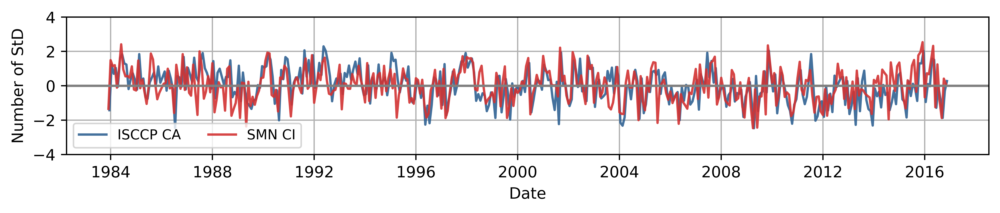

In [50]:
#Figure 7: Grafico anomalias estandarizadas

#datos
isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data = isccp_mensual_media_regional_anomalias_estandarizadas.loc[fecha_inicio_str[0:7]:fecha_final_str[0:7]]
CI_mensuales_anomalias_estandarizadas_media_regional_data = CI_mensuales_media_regional_anomalias_estandarizadas.loc[fecha_inicio_str[0:7]:fecha_final_str[0:7]]

#figura
fig = plt.figure(num=1, figsize=(9, 2), dpi=900)
fig.patch.set_facecolor('white')
plt.subplot(1, 1, 1)
plt.plot(isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data, color = "#306292", linewidth = 1.5, alpha = 0.9)
plt.plot(CI_mensuales_anomalias_estandarizadas_media_regional_data, color = "#D23232", linewidth = 1.5, alpha = 0.9)
ylim = 4
plt.ylim((-ylim,ylim))
plt.ylabel("Number of StD")
plt.xlabel("Date")  
plt.axhline(y=0, color='grey', linestyle='-')
plt.legend(["ISCCP CA", "SMN CI"], loc ="lower left", ncol=2, prop={'size': 8.8})
plt.grid()
plt.tight_layout()

#guardo este grafico

print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

# 
plt.savefig("Figure7.png")

print(f"SAVE PLOT 7")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY TO:{0}".format(cwd))

plt.show

In [51]:
##Grafico anomalias estandarizadas para poster

#fig = plt.figure(num=1, figsize=(9, 4), dpi=1000)
#isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data = isccp_mensual_media_regional_anomalias_estandarizadas.loc[fecha_inicio_str[0:7]:fecha_final_str[0:7]]
#CI_mensuales_anomalias_estandarizadas_media_regional_data = CI_mensuales_media_regional_anomalias_estandarizadas.loc[fecha_inicio_str[0:7]:fecha_final_str[0:7]]
#plt.subplot(2, 1, 1)
#plt.plot(isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data, color = "#306292", linewidth = 1.5, alpha = 0.9)
#plt.plot(CI_mensuales_anomalias_estandarizadas_media_regional_data, color = "#D23232", linewidth = 1.5, alpha = 0.9)
#ylim = 4
#plt.ylim((-ylim,ylim))
#plt.ylabel("Anomalías \nestandarizadas")
#plt.xlabel("Fecha")  
#plt.axhline(y=0, color='grey', linestyle='-')
#plt.legend(["ISCCP CN", "SMN CI"], loc ="lower left", ncol=2, prop={'size': 8.8})
#plt.grid()
#plt.tight_layout()
#plt.show

In [52]:
#Calculo la correlación entre las series estandarizadas anteriores (anuales)
#tabla 5 fila 1

x = isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data.values
x = np.reshape(x, (len(x)))
x = np.array(x, dtype=float)
y = CI_mensuales_anomalias_estandarizadas_media_regional_data.values
y = np.array(y, dtype=float)

#calculo recta de regresion
idx = np.isfinite(x) & np.isfinite(y)
m, b = np.polyfit(x[idx], y[idx], 1) #m = slope, b=intercept

#calculo R2
correlation = np.corrcoef(x[idx], y[idx])[0,1]
r2_anual = correlation**2

#para ver si estan correlacionadas significativamente:
from scipy.stats.stats import pearsonr
#calculation correlation coefficient and p-value between x and y
pvalor_anual = pearsonr(x[idx], y[idx])[1]
#Two-tailed p-value: 1.627164224876644e-73
#And since the corresponding p-value is less than .05, 
#we conclude that there is a statistically significant association between the two variables.

## Hago gráfico de dispersion
#plt.figure(num=1, figsize=(5, 5), dpi=600) #genero figura
#ax = plt.gca()    
#ax.scatter(x, y, c ="k", alpha = 1, marker = ".", s= 20, zorder = 4)
#ax.plot(x, m*x + b, c = "#D01B25", zorder = 5)
#ax.text(-1.6, 1.5, '$R^2$ = %0.3f' % r2_anual, c= "#D01B25", fontweight = 800, zorder = 6)
#ax.hlines(0, xmin = -3, xmax = 3, color = "grey", alpha = 0.8, zorder = 3)
#ax.vlines(0, ymin = -3, ymax = 3, color = "grey", alpha = 0.8, zorder = 2)
#ax.grid(alpha = 0.5, zorder = 1)
#ax.set_xlabel('ISCCP CA (Number of StD)')
#ax.set_ylabel('SMN CI (Number of StD)') 
#ax.annotate("1983-2016", (-2.9, 2.8), size = 10, style='italic', zorder = 7)

In [53]:
#calculo coef de corr por estacion
#tabla 5 fila 2-5

CI_mensuales_anomalias_estandarizadas_media_regional_data_DJF = CI_mensuales_anomalias_estandarizadas_media_regional_data[(CI_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 12) | 
                                                         (CI_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 1) |
                                                         (CI_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 2) ]

CI_mensuales_anomalias_estandarizadas_media_regional_data_MAM = CI_mensuales_anomalias_estandarizadas_media_regional_data[(CI_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 3) | 
                                                         (CI_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 4) |
                                                         (CI_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 5) ]

CI_mensuales_anomalias_estandarizadas_media_regional_data_JJA = CI_mensuales_anomalias_estandarizadas_media_regional_data[(CI_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 6) | 
                                                         (CI_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 7) |
                                                         (CI_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 8) ]

CI_mensuales_anomalias_estandarizadas_media_regional_data_SON = CI_mensuales_anomalias_estandarizadas_media_regional_data[(CI_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 9) | 
                                                         (CI_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 10) |
                                                         (CI_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 11) ]

isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data_DJF = isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data[(isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 12) | 
                                                         (isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 1) |
                                                         (isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 2) ]

isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data_MAM = isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data[(isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 3) | 
                                                         (isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 4) |
                                                         (isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 5) ]

isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data_JJA = isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data[(isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 6) | 
                                                         (isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 7) |
                                                         (isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 8) ]

isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data_SON = isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data[(isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 9) | 
                                                         (isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 10) |
                                                         (isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data.index.month == 11) ]

#para ver si estan correlacionadas significativamente:
from scipy.stats.stats import pearsonr

#calculation correlation coefficient and p-value between x and y
xDJF = isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data_DJF.values
xDJF = np.reshape(xDJF, (len(xDJF)))
xDJF = np.array(xDJF, dtype=float)
yDJF = CI_mensuales_anomalias_estandarizadas_media_regional_data_DJF.values
yDJF = np.array(yDJF, dtype=float)
idxDJF = np.isfinite(xDJF) & np.isfinite(yDJF)
r2_DJF = pearsonr(xDJF[idxDJF], yDJF[idxDJF])[0] ** 2
pv_DJF = pearsonr(xDJF[idxDJF], yDJF[idxDJF])[1]

#calculation correlation coefficient and p-value between x and y
xMAM = isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data_MAM.values
xMAM = np.reshape(xMAM, (len(xMAM)))
xMAM = np.array(xMAM, dtype=float)
yMAM = CI_mensuales_anomalias_estandarizadas_media_regional_data_MAM.values
yMAM = np.array(yMAM, dtype=float)
idxMAM = np.isfinite(xMAM) & np.isfinite(yMAM)
r2_MAM = pearsonr(xMAM[idxMAM], yMAM[idxMAM])[0] ** 2
pv_MAM = pearsonr(xMAM[idxMAM], yMAM[idxMAM])[1]

#calculation correlation coefficient and p-value between x and y
xJJA = isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data_JJA.values
xJJA = np.reshape(xJJA, (len(xJJA)))
xJJA = np.array(xJJA, dtype=float)
yJJA = CI_mensuales_anomalias_estandarizadas_media_regional_data_JJA.values
yJJA = np.array(yJJA, dtype=float)
idxJJA = np.isfinite(xJJA) & np.isfinite(yJJA)
r2_JJA = pearsonr(xJJA[idxJJA], yJJA[idxJJA])[0] ** 2
pv_JJA = pearsonr(xJJA[idxJJA], yJJA[idxJJA])[1]

#calculation correlation coefficient and p-value between x and y
xSON = isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data_SON.values
xSON = np.reshape(xSON, (len(xSON)))
xSON = np.array(xSON, dtype=float)
ySON = CI_mensuales_anomalias_estandarizadas_media_regional_data_SON.values
ySON = np.array(ySON, dtype=float)
idxSON = np.isfinite(xSON) & np.isfinite(ySON)
r2_SON = pearsonr(xSON[idxSON], ySON[idxSON])[0] ** 2
pv_SON = pearsonr(xSON[idxSON], ySON[idxSON])[1]


In [54]:
#Hago graficos de dispersion y calculo la correlación entre las series estandarizadas anteriores para DJF
#x = isccp_mensual_mensuales_anomalias_estandarizadas_media_regional_data_DJF.values
#x = np.reshape(x, (len(x)))
#x = np.array(x, dtype=float)
#y = CI_mensuales_anomalias_estandarizadas_media_regional_data_DJF.values
#y = np.array(y, dtype=float)

##calculo recta de regresion
#idx = np.isfinite(x) & np.isfinite(y)
#m, b = np.polyfit(x[idx], y[idx], 1) #m = slope, b=intercept

##calculo R2
#correlation = np.corrcoef(x[idx], y[idx])[0,1]
#r_squared = correlation**2

##grafico
#plt.figure(num=1, figsize=(5, 5), dpi=600) #genero figura
#ax = plt.gca()    
#ax.scatter(x, y, c ="k", alpha = 1, marker = ".", s= 20, zorder = 4)
#ax.plot(x, m*x + b, c = "#D01B25", zorder = 5)
#ax.text(-1.6, 1.5, '$R^2$ = %0.3f' % r_squared, c= "#D01B25", fontweight = 800, zorder = 6)
#ax.hlines(0, xmin = -3, xmax = 3, color = "grey", alpha = 0.8, zorder = 3)
#ax.vlines(0, ymin = -3, ymax = 3, color = "grey", alpha = 0.8, zorder = 2)
#ax.grid(alpha = 0.5, zorder = 1)
#ax.set_xlabel('ISCCP CA (Number of StD)')
#ax.set_ylabel('SMN CI (Number of StD)') 
#ax.annotate("1983-2016", (-2.9, 2.8), size = 10, style='italic', zorder = 7)
#plt.title("DJF")

In [55]:
#ARMO TABLA 5
tabla_r2_CI_ISCCP_estandarizado = pd.DataFrame(data=[[r2_anual,r2_DJF, r2_MAM, r2_JJA, r2_SON],[pvalor_anual, pv_DJF, pv_MAM, pv_JJA, pv_SON]], index=["R2", "p-value"]).transpose()
tabla_r2_CI_ISCCP_estandarizado.index = ["ANNUAL","DJF","MAM","JJA","SON"]
print(tabla_r2_CI_ISCCP_estandarizado)

#LA GUARDO
#la guardo como excel
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

# create excel writer
writer = pd.ExcelWriter("Table5_CI_CA_correlations.xlsx")
# write dataframe to excel sheet named 'marks'
tabla_porcentajes.to_excel(writer, 'info')
# save the excel file
writer.save()
print(f"SAVE TABLE 5 tabla_r2_CI_ISCCP_estandarizado")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY TO:{0}".format(cwd))


              R2       p-value
ANNUAL  0.566510  1.627164e-73
DJF     0.729223  2.858092e-29
MAM     0.676501  1.656057e-25
JJA     0.342193  2.041725e-10
SON     0.560871  4.958619e-19
CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper




AttributeError: 'XlsxWriter' object has no attribute 'save'

In [56]:
import pymannkendall as mk
import scipy

#defino funcion que calcula tendencia_theil_sen
def tendencia_theil_sen(serie, fuente = "ISCCP"):
    if fuente == "ISCCP_2":
        valores = serie.values[np.isfinite(serie.values)]
        fechas = np.arange(0, len(serie), 1)[np.isfinite(serie.values)]
    elif fuente == "ISCCP":
        valores = serie.values
        fechas = np.arange(0, len(serie), 1)
    elif fuente == "SMN":
        valores = serie.values[np.isfinite(serie.values)]
        #fechas = np.arange(0, len(serie), 1)[np.isfinite(serie.values)]
        fechas = np.arange(0, len(valores), 1)
        
    # si el vector es todo de nan entonces que no calcule la tendencia, y que devuelva nan
    if valores.size <= 1:
        tendencia = np.nan
        significativo = np.nan
        
    # si el vector tiene valores distintos de nan calcula tendencia y significancia con 95%
    elif valores.size > 1:
        coef = scipy.stats.mstats.theilslopes(y=valores, x=fechas, alpha=0.95)
        tendencia = coef[0]  # dada entre un intervalo de tiempo. A esta salida si quiero tendencia decadal e ingrese datos de toda la serie mensual lo multiplico por 10*12 y si quiero por decada y vienen dados por un dato anual se multiplica por 10
        coord_origen = coef[1]
        
        ##Hago el test con el z estadistico para alpha = 0.95
        #z_test = mk.original_test(valores, alpha = 0.05)[3]
        #if abs(z_test) >= 1.96:
         #   significativo_95 = True
        #elif abs(z_test) < 1.96:
         #   significativo_95 = False
        
        ##Hago el test con el p-value para y determino si es significativo con alpha = 0.95 o alpha=0.90
        pvalue_test = mk.original_test(valores)[2]
        
        if pvalue_test <= 0.01:
            significativo_99 = True
            significativo_95 = True
            significativo_90 = True
        elif pvalue_test <= 0.05:
            significativo_99 = False
            significativo_95 = True
            significativo_90 = True
        elif pvalue_test <= 0.1:
            significativo_99 = False
            significativo_95 = False
            significativo_90 = True
        else:
            significativo_99 = False
            significativo_95 = False
            significativo_90 = False
        
    return(coord_origen, tendencia, significativo_99, significativo_95, significativo_90, pvalue_test)

#serie=isccp_mensual_mensuales_media_regional_data["cldamt"]
#tendencia_theil_sen(serie, fuente = "ISCCP")
#serie_2 = CI_mensuales_anomalias_estandarizadas_media_regional_data
#tendencia_theil_sen(serie_2, fuente = "ISCCP_2")

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE PLOT 5


CHANGE THE WORKING DIRECTORY TO:/home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


<function matplotlib.pyplot.show(close=None, block=None)>

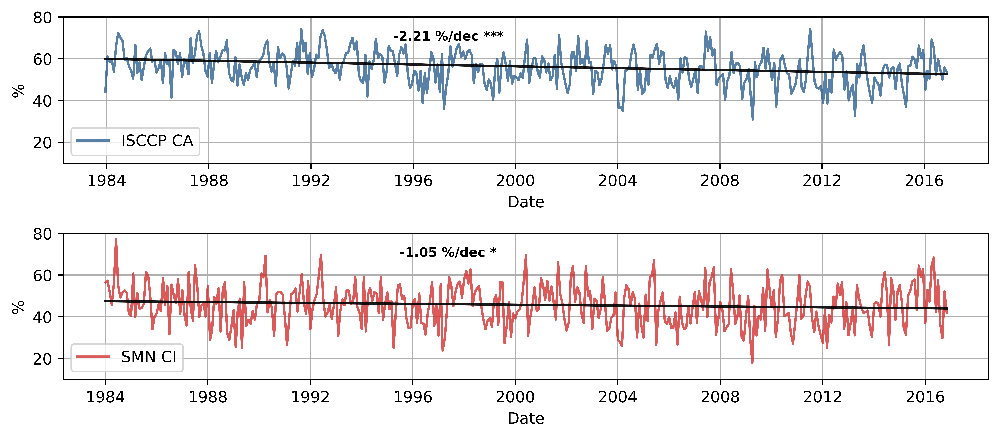

In [57]:
#FIGURE 5 variables crudas con tendencias 

#data
isccp_mensual_mensuales_media_regional_data = isccp_mensual_media_regional.loc[fecha_inicio_str:fecha_final_str]
CI_mensuales_media_regional_data = CI_mensuales_media_regional.loc[fecha_inicio_str:fecha_final_str]

#plot
fig = plt.figure(num=1, figsize=(9, 4), dpi=900)
fig.patch.set_facecolor('white')
plt.subplot(2, 1, 1)

#isccp
plt.plot(isccp_mensual_mensuales_media_regional_data, color = "#306292", linewidth = 1.5, alpha = 0.8)
plt.ylim((10,80))
plt.ylabel("%")
plt.xlabel("Date")  
plt.axhline(y=0, color='grey', linestyle='-')
plt.legend(["ISCCP CA"], loc ="lower left")
plt.grid()
plt.tight_layout()
#incorporo tendencia de theil sen
tendencia_isccp_sen = tendencia_theil_sen(isccp_mensual_mensuales_media_regional_data["cldamt"], fuente = "ISCCP")
pendiente_isccp_sen = tendencia_isccp_sen[1]
origen_isccp_sen = tendencia_isccp_sen[0]
significativo_isccp_sen_99 = tendencia_isccp_sen[2]
significativo_isccp_sen_95 = tendencia_isccp_sen[3]
significativo_isccp_sen_90 = tendencia_isccp_sen[4]
grafico_tendencia_isccp_sen = origen_isccp_sen + pendiente_isccp_sen * np.arange(0, len(isccp_mensual_mensuales_media_regional_data.index), 1)
if significativo_isccp_sen_99 == True:
    plt.text(10000, 70.5, f"{round(pendiente_isccp_sen*10*12, 2)} %/dec ***",color="k", 
                     ha="center", va = "center", fontsize =  'small',
                     weight='bold') #horizontalalignment='center', verticalalignment='center'
elif significativo_isccp_sen_99 == False and significativo_isccp_sen_95 == True:
    plt.text(10000, 70.5, f"{round(pendiente_isccp_sen*10*12, 2)} %/dec **",color="k", 
                     ha="center", va = "center", fontsize =  'small',
                     weight='bold') #horizontalalignment='center', verticalalignment='center'
elif significativo_isccp_sen_99 == False and significativo_isccp_sen_95 == False and significativo_isccp_sen_90 == True:
    plt.text(10000, 70.5, f"{round(pendiente_isccp_sen*10*12, 2)} %/dec *",color="k", 
                     ha="center", va = "center", fontsize =  'small',
                     weight='bold') #horizontalalignment='center', verticalalignment='center'
else:
    plt.text(10000, 70.5, f"{round(pendiente_isccp_sen*10*12, 2)} %/dec",color="k", 
                     ha="center", va = "center", fontsize =  'small',
                     weight='bold') #horizontalalignment='center', verticalalignment='center'
plt.plot(isccp_mensual_mensuales_media_regional_data.index, 
             grafico_tendencia_isccp_sen,color = "k", alpha = 0.9)

#ci
plt.subplot(2, 1, 2)
plt.plot(CI_mensuales_media_regional_data, color = "#D23232", linewidth = 1.5, alpha = 0.8)
plt.ylim((10,80))
plt.ylabel("%")
plt.xlabel("Date")  
plt.axhline(y=0, color='grey', linestyle='-')
plt.legend(["SMN CI"], loc ="lower left")
plt.grid()
plt.tight_layout()
#tendencia theil sen
tendencia_smn_sen = tendencia_theil_sen(CI_mensuales_media_regional_data, fuente = "SMN")
pendiente_smn_sen = tendencia_smn_sen[1]
origen_smn_sen = tendencia_smn_sen[0]
significativo_smn_sen_99 = tendencia_smn_sen[2]
significativo_smn_sen_95 = tendencia_smn_sen[3]
significativo_smn_sen_90 = tendencia_smn_sen[4]
grafico_tendencia_smn_sen = origen_smn_sen + pendiente_smn_sen * np.arange(0, len(CI_mensuales_media_regional_data.index), 1)
if significativo_smn_sen_99 == True:
    plt.text(10000, 70.5, f"{round(pendiente_smn_sen*10*12, 2)} %/dec ***",color="k", 
                     ha="center", va = "center", fontsize =  'small',
                     weight='bold') #horizontalalignment='center', verticalalignment='center'
elif significativo_smn_sen_99 == False and significativo_smn_sen_95 == True:
    plt.text(10000, 70.5, f"{round(pendiente_smn_sen*10*12, 2)} %/dec **",color="k", 
                     ha="center", va = "center", fontsize =  'small',
                     weight='bold') #horizontalalignment='center', verticalalignment='center'
elif significativo_smn_sen_99 == False and significativo_smn_sen_95 == False and significativo_smn_sen_90 == True:
    plt.text(10000, 70.5, f"{round(pendiente_smn_sen*10*12, 2)} %/dec *",color="k", 
                     ha="center", va = "center", fontsize =  'small',
                     weight='bold') #horizontalalignment='center', verticalalignment='center'
else:
    plt.text(10000, 70.5, f"{round(pendiente_smn_sen*10*12, 2)} %/dec",color="k", 
                     ha="center", va = "center", fontsize =  'small',
                     weight='bold') #horizontalalignment='center', verticalalignment='center'
plt.plot(CI_mensuales_media_regional_data.index, 
             grafico_tendencia_smn_sen,color = "k", alpha = 0.9)

#guardo grafico
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")
 
plt.savefig("Figure5.png")
print(f"SAVE PLOT 5")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY TO:{0}".format(cwd))

plt.show

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE PLOT 8


CHANGE THE WORKING DIRECTORY TO:/home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


<function matplotlib.pyplot.show(close=None, block=None)>

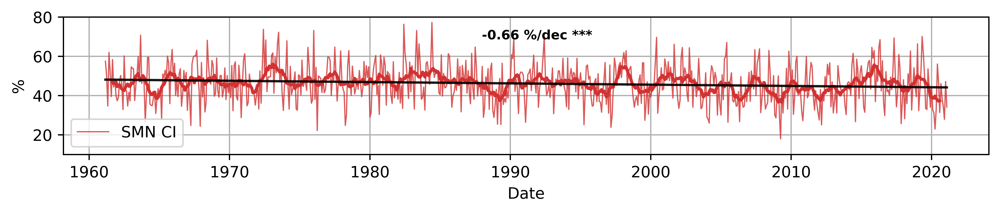

In [58]:
#Figura 8 desde March 1961 a February 2021
#grafico variable cruda con tendencia y media movil de 12 meses para el periodo mas largo 1961-2020 solo para SMN CI

#datos
CI_mensuales_media_regional_data_2 = CI_mensuales_media_regional.loc[fecha_inicio_str_2:fecha_final_str_2]
#calculo media mobil de 12 meses
from f_procesamiento_nubosidad_observada_anomalias import promedio_movil
ventana = 12
CI_mensuales_media_regional_data_2_media_movil = promedio_movil(CI_mensuales_media_regional_data_2, ventana)

#plot
fig = plt.figure(num=1, figsize=(9, 2), dpi=900)
fig.patch.set_facecolor('white')
plt.subplot(1, 1, 1)
plt.plot(CI_mensuales_media_regional_data_2, color = "#D23232", linewidth = 0.8, alpha = 0.8)
plt.plot(CI_mensuales_media_regional_data_2.index, CI_mensuales_media_regional_data_2_media_movil, color = "#D23232", linewidth = 2, alpha = 1)
plt.ylim((10,80))
plt.ylabel("%")
plt.xlabel("Date")  
plt.axhline(y=0, color='grey', linestyle='-')
plt.legend(["SMN CI"], loc ="lower left")
plt.grid()
plt.tight_layout()
#calculo tendencia
tendencia_smn_sen = tendencia_theil_sen(CI_mensuales_media_regional_data_2, fuente = "SMN")
pendiente_smn_sen = tendencia_smn_sen[1]
origen_smn_sen = tendencia_smn_sen[0]
significativo_smn_sen_99 = tendencia_smn_sen[2]
significativo_smn_sen_95 = tendencia_smn_sen[3]
significativo_smn_sen_90 = tendencia_smn_sen[4]
grafico_tendencia_smn_sen = origen_smn_sen + pendiente_smn_sen * np.arange(0, len(CI_mensuales_media_regional_data_2.index), 1)
if significativo_smn_sen_99 == True:
    plt.text(8000, 70.5, f"{round(pendiente_smn_sen*10*12, 2)} %/dec ***",color="k", 
                     ha="center", va = "center", fontsize =  'small',
                     weight='bold') #horizontalalignment='center', verticalalignment='center'
elif significativo_smn_sen_99 == False and significativo_smn_sen_95 == True:
    plt.text(8000, 70.5, f"{round(pendiente_smn_sen*10*12, 2)} %/dec **",color="k", 
                     ha="center", va = "center", fontsize =  'small',
                     weight='bold') #horizontalalignment='center', verticalalignment='center'
elif significativo_smn_sen_99 == False and significativo_smn_sen_95 == False and significativo_smn_sen_90 == True:
    plt.text(8000, 70.5, f"{round(pendiente_smn_sen*10*12, 2)} %/dec *",color="k", 
                     ha="center", va = "center", fontsize =  'small',
                     weight='bold') #horizontalalignment='center', verticalalignment='center'
else:
    plt.text(8000, 70.5, f"{round(pendiente_smn_sen*10*12, 2)} %/dec",color="k", 
                     ha="center", va = "center", fontsize =  'small',
                     weight='bold') #horizontalalignment='center', verticalalignment='center'
plt.plot(CI_mensuales_media_regional_data_2.index, 
             grafico_tendencia_smn_sen,color = "k", alpha = 0.9)

#guardo este grafico

print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

# 
plt.savefig("Figure8.png")
print(f"SAVE PLOT 8")
print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY TO:{0}".format(cwd))

plt.show

#### Running trends

Reference: Fig 5: https://wires.onlinelibrary.wiley.com/doi/full/10.1002/wcc.652 


In [59]:
serie = CI_mensuales_media_regional
serie["1961-01": "1991-12"]
#valores = serie.values[np.isfinite(serie.values)]
#valores

1961-01-01    46.774194
1961-02-01    66.071429
1961-03-01    57.526882
1961-04-01    50.000000
1961-05-01    34.677419
                ...    
1991-08-01    51.971326
1991-09-01    60.555556
1991-10-01    46.774194
1991-11-01    41.296296
1991-12-01    56.989247
Freq: MS, Length: 372, dtype: float64

In [60]:
import pymannkendall as mk
import scipy

#defino funcion que calcula tendencia_theil_sen para distintos periodos
def running_tendencia_theil_sen(serie, fecha_inicio, fecha_final, fuente = "ISCCP"):
    """
    fecha_inicio = "yyyy-mm"
    fecha_final = "yyyy-mm"
    """
    if fuente == "ISCCP_2":
        seriei= serie.copy()
        seriei = seriei[fecha_inicio: fecha_final]
        valores = seriei.values[np.isfinite(seriei.values)]
        fechas = np.arange(0, len(seriei), 1)[np.isfinite(seriei.values)]
    elif fuente == "ISCCP":
        seriei= serie.copy()
        seriei = seriei[fecha_inicio: fecha_final]
        valores = seriei.values
        fechas = np.arange(0, len(seriei), 1)
    elif fuente == "SMN":
        seriei= serie.copy()
        seriei = seriei[fecha_inicio: fecha_final]
        valores = seriei.values[np.isfinite(seriei.values)]
        #fechas = np.arange(0, len(serie), 1)[np.isfinite(serie.values)]
        fechas = np.arange(0, len(valores), 1)
        
    # si el vector es todo de nan entonces que no calcule la tendencia, y que devuelva nan
    if valores.size <= 1:
        tendencia = np.nan
        pvalue_test = np.nan
        
    # si el vector tiene valores distintos de nan calcula tendencia y significancia con 95%
    elif valores.size > 1:
        coef = scipy.stats.mstats.theilslopes(y=valores, x=fechas, alpha=0.95)
        tendencia = coef[0]  # dada entre un intervalo de tiempo. A esta salida si quiero tendencia decadal e ingrese datos de toda la serie mensual lo multiplico por 10*12 y si quiero por decada y vienen dados por un dato anual se multiplica por 10
        coord_origen = coef[1]

        ##Hago el test con el p-value para y determino si es significativo con alpha = 0.95 o alpha=0.90
        pvalue_test = mk.original_test(valores)[2]
        
        ##Hago el test con el z estadistico para alpha = 0.95
        #z_test = mk.original_test(valores, alpha = 0.05)[3]
        #if abs(z_test) >= 1.96:
         #   significativo_95 = True
        #elif abs(z_test) < 1.96:
         #   significativo_95 = False
        
        
        
    salida = {"fecha_inicio": fecha_inicio, "fecha_final": fecha_final, "tendencia": tendencia, "p-valor": pvalue_test}
    return(salida)



In [61]:
#calculo tendencias y acomodo salidas en un xarray
#terminar esto
#las hago de: marzo anio 0 a febrero anio f
from datetime import datetime

anios_inicio = np.arange(1961, 1993, 1)
anios_final = np.arange(1990, 2022, 1)
fechas_inicio = [datetime(anio,3,1) for anio in anios_inicio]
fechas_final = [datetime(anio,3,1) for anio in anios_final]

running_tendencias = []
running_sign_99 = []
running_sign_95 = []
running_sign_90 = []
start_years = []
end_years = []
for fecha_inicio in fechas_inicio:
    for fecha_final in fechas_final:
        tendencia_i = running_tendencia_theil_sen(serie, datetime.strftime(fecha_inicio, "%Y-%m"), 
                                                  datetime.strftime(fecha_final, "%Y-%m"), fuente = "SMN")
        fecha_inicio_year = fecha_inicio.year
        fecha_final_year = fecha_final.year
        start_years.append(fecha_inicio_year)
        end_years.append(fecha_final_year)
        running_tendencias.append(tendencia_i["tendencia"]*12*10) # %/decade
        if tendencia_i["p-valor"] <= 0.01:
            running_sign_99.append(1)
            running_sign_95.append(np.nan) #only to mark sig 99% in this case
            running_sign_90.append(np.nan)
        elif (tendencia_i["p-valor"] <= 0.05) and (tendencia_i["p-valor"] > 0.01):
            running_sign_99.append(np.nan)
            running_sign_95.append(1) #only to mark sig 95% in this case
            running_sign_90.append(np.nan)
        elif (tendencia_i["p-valor"] <= 0.1) and (tendencia_i["p-valor"] > 0.05):
            running_sign_99.append(np.nan)
            running_sign_95.append(np.nan) #only to mark sig 90% in this case
            running_sign_90.append(1)
        else:
            running_sign_99.append(np.nan)
            running_sign_95.append(np.nan) #only to mark sig 90% in this case
            running_sign_90.append(np.nan)


running_tendencias = np.array(running_tendencias).reshape(len(list(set(start_years))), len(list(set(start_years))))
        
running_tendencias_xarray = xr.DataArray(
    data = running_tendencias,
    dims=["StartYear", "EndYear"],
    coords=dict(
        StartYear=list(set(start_years)),
        EndYear=list(set(end_years))
    ),
    attrs=dict(
        description="Theil-Sen Tendency",
        units="%/dec", #check
    ),
)


running_sign_99 = np.array(running_sign_99).reshape(len(list(set(start_years))), len(list(set(start_years))))
        
running_sign_99_xarray = xr.DataArray(
    data = running_sign_99,
    dims=["StartYear", "EndYear"],
    coords=dict(
        StartYear=list(set(start_years)),
        EndYear=list(set(end_years))
    ),
    attrs=dict(
        description="Theil-Sen Tendency significancia 99%",
        units="True or False", #check
    ),
)

running_sign_95 = np.array(running_sign_95).reshape(len(list(set(start_years))), len(list(set(start_years))))
        
running_sign_95_xarray = xr.DataArray(
    data = running_sign_95,
    dims=["StartYear", "EndYear"],
    coords=dict(
        StartYear=list(set(start_years)),
        EndYear=list(set(end_years))
    ),
    attrs=dict(
        description="Theil-Sen Tendency significancia 95%",
        units="True or Fakse", #check
    ),
)

running_sign_90 = np.array(running_sign_90).reshape(len(list(set(start_years))), len(list(set(start_years))))
        
running_sign_90_xarray = xr.DataArray(
    data = running_sign_90,
    dims=["StartYear", "EndYear"],
    coords=dict(
        StartYear=list(set(start_years)),
        EndYear=list(set(end_years))
    ),
    attrs=dict(
        description="Theil-Sen Tendency significancia 90%",
        units="True or True", #check
    ),
)

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE FIGURE RUNNING TENDENCIES


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


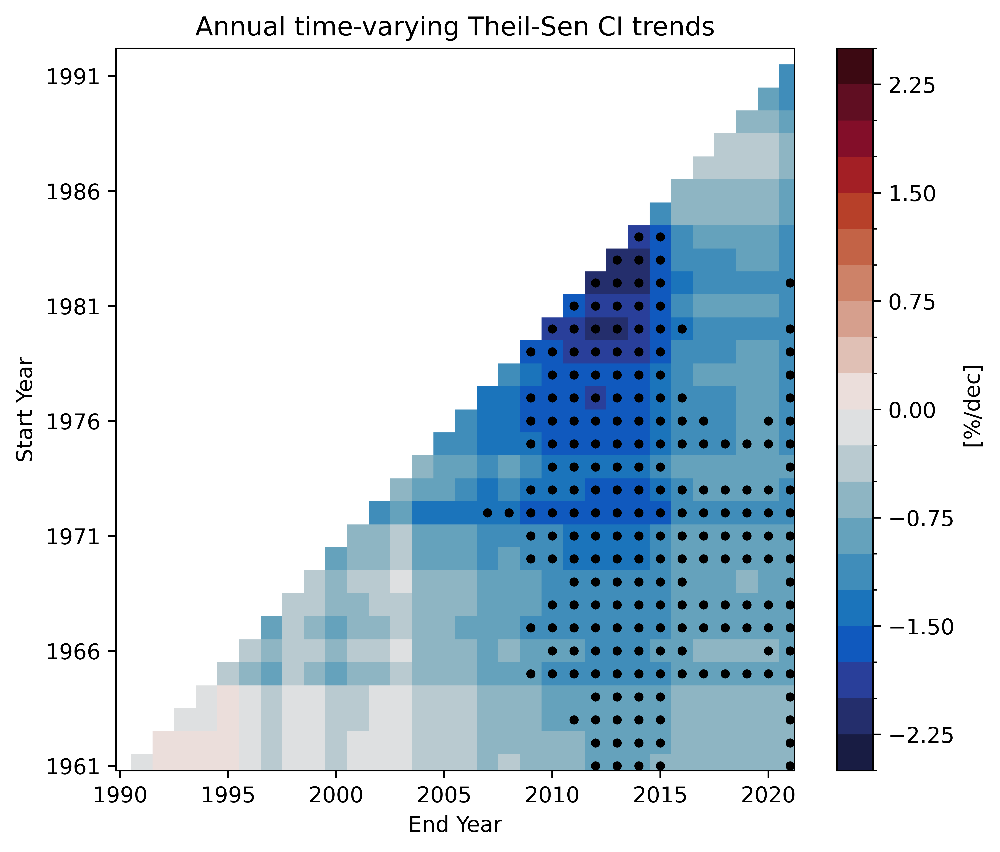

In [128]:
plt.close()
condition = (running_tendencias_xarray["EndYear"] >= 30 + running_tendencias_xarray["StartYear"])
running_tendencias_xarray = running_tendencias_xarray.where(condition, drop=True)
running_sign_99_xarray = running_sign_99_xarray.where(condition, drop=True)
running_sign_95_xarray = running_sign_95_xarray.where(condition, drop=True)
running_sign_90_xarray = running_sign_90_xarray.where(condition, drop=True)

xrdata = running_tendencias_xarray

valor_minimo = -2.5
valor_maximo = 2.5
delta_valor = 0.1

xticks_min = 1990
xticks_max = 2021
yticks_min = 1961
yticks_max = 1992
espacio_entre_anios = 5

# ploteo 
fig3 = plt.figure(figsize=[7, 6], dpi=900)  #8.5, 5.5
fig3.patch.set_facecolor('white')            
ax = fig3.add_subplot(111)

###esto para discretizar la paleta:
##
mi_cmap = cmocean.cm.balance # define the colormap  diff al reves
## extract all colors from the .rain map
mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
## create the new map
mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', mi_cmaplist, mi_cmap.N)
## define the bins and normalize
bounds = np.linspace(valor_minimo, valor_maximo, 21)
norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
##fin de discretizado de paleta

xrdata.plot(ax=ax,levels=np.arange(valor_minimo, valor_maximo, delta_valor),
            cmap=mi_cmap2, norm =norm,extend='neither')

# grafico puntos en los lugares donde es significativo
# Get the coordinates where the values are 1 in running_sign_95_xarray
coords = np.where(running_sign_99_xarray == 1.)
coords2 = (running_sign_99_xarray.StartYear[coords[0]], running_sign_99_xarray.EndYear[coords[1]])
# Overlay the scatter plot of 1 values on top
ax.scatter(coords2[1], coords2[0], marker='o', s= 10, color='black', label='Value 1')

coords3 = np.where(running_sign_95_xarray == 1.)
coords4 = (running_sign_95_xarray.StartYear[coords[0]], running_sign_95_xarray.EndYear[coords[1]])
# Overlay the scatter plot of 1 values on top
ax.scatter(coords4[1], coords4[0], marker='o', s= 10, color='black', label='Value 1')

#running_sign_99_xarray.plot.scatter(x = "EndYear", y = "StartYear")
# grafico puntos en los lugares donde es significativo
#running_sign_99_xarray.plot(ax=ax)
#running_sign_99_xarray.plot.contourf(ax=ax, levels=[0, 1], hatches=['..'], alpha=0, add_colorbar=False)
#running_sign_95_xarray.plot.contourf(ax=ax, levels=[0, 1], hatches=['//'], alpha=0, add_colorbar=False)
#running_sign_90_xarray.plot.contourf(ax=ax, levels=[0, 1], hatches=['++'], alpha=0, add_colorbar=False)

ax.set_facecolor('white')

#seteo ejes
ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
ax.set_xticklabels(np.arange(xticks_min, xticks_max+1,espacio_entre_anios))
plt.xticks(np.arange(xticks_min, xticks_max+1,espacio_entre_anios))
ax.set_xlabel("End Year")
ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
ax.set_yticklabels(np.arange(yticks_min, yticks_max+1, espacio_entre_anios))
plt.yticks(np.arange(yticks_min, yticks_max+1,espacio_entre_anios))
ax.set_ylabel("Start Year")

plt.title("Annual time-varying Theil-Sen CI trends")

#la guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE FIGURE RUNNING TENDENCIES")
plt.savefig("figuraRunningTendencies.png")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))

plt.show()

In [61]:
####running theil-sen tendencies with CA ISCCP


In [62]:
#calculo tendencias y acomodo salidas en un xarray
#terminar esto
#las hago de: marzo anio 0 a febrero anio f
from datetime import datetime

serie = isccp_mensual_mensuales_media_regional_data["cldamt"]
anios_inicio = np.arange(1983, 1986, 1)
anios_final = np.arange(2013, 2016, 1)
fechas_inicio = [datetime(anio,3,1) for anio in anios_inicio]
fechas_final = [datetime(anio,3,1) for anio in anios_final]

running_tendencias = []
running_sign_99 = []
running_sign_95 = []
running_sign_90 = []
start_years = []
end_years = []
for fecha_inicio in fechas_inicio:
    for fecha_final in fechas_final:
        tendencia_i = running_tendencia_theil_sen(serie, datetime.strftime(fecha_inicio, "%Y-%m"), 
                                                  datetime.strftime(fecha_final, "%Y-%m"), fuente = "ISCCP")
        fecha_inicio_year = fecha_inicio.year
        fecha_final_year = fecha_final.year
        start_years.append(fecha_inicio_year)
        end_years.append(fecha_final_year)
        running_tendencias.append(tendencia_i["tendencia"]*12*10) # %/decade
        if tendencia_i["p-valor"] <= 0.01:
            running_sign_99.append(1)
            running_sign_95.append(np.nan) #only to mark sig 99% in this case
            running_sign_90.append(np.nan)
        elif (tendencia_i["p-valor"] <= 0.05) and (tendencia_i["p-valor"] > 0.01):
            running_sign_99.append(np.nan)
            running_sign_95.append(1) #only to mark sig 95% in this case
            running_sign_90.append(np.nan)
        elif (tendencia_i["p-valor"] <= 0.1) and (tendencia_i["p-valor"] > 0.05):
            running_sign_99.append(np.nan)
            running_sign_95.append(np.nan) #only to mark sig 90% in this case
            running_sign_90.append(1)
        else:
            running_sign_99.append(np.nan)
            running_sign_95.append(np.nan) #only to mark sig 90% in this case
            running_sign_90.append(np.nan)


running_tendencias = np.array(running_tendencias).reshape(len(list(set(start_years))), len(list(set(start_years))))

mi_lista_start_years = list(set(start_years))
mi_lista_start_years.sort()

running_tendencias_xarray = xr.DataArray(
    data = running_tendencias,
    dims=["StartYear", "EndYear"],
    coords=dict(
        StartYear=mi_lista_start_years,
        EndYear=list(set(end_years))
    ),
    attrs=dict(
        description="Theil-Sen Tendency",
        units="%/dec", #check
    ),
)


running_sign_99 = np.array(running_sign_99).reshape(len(list(set(start_years))), len(list(set(start_years))))
        
running_sign_99_xarray = xr.DataArray(
    data = running_sign_99,
    dims=["StartYear", "EndYear"],
    coords=dict(
        StartYear=mi_lista_start_years,
        EndYear=list(set(end_years))
    ),
    attrs=dict(
        description="Theil-Sen Tendency significancia 99%",
        units="True or False", #check
    ),
)

running_sign_95 = np.array(running_sign_95).reshape(len(list(set(start_years))), len(list(set(start_years))))
        
running_sign_95_xarray = xr.DataArray(
    data = running_sign_95,
    dims=["StartYear", "EndYear"],
    coords=dict(
        StartYear=mi_lista_start_years,
        EndYear=list(set(end_years))
    ),
    attrs=dict(
        description="Theil-Sen Tendency significancia 95%",
        units="True or Fakse", #check
    ),
)

running_sign_90 = np.array(running_sign_90).reshape(len(list(set(start_years))), len(list(set(start_years))))
        
running_sign_90_xarray = xr.DataArray(
    data = running_sign_90,
    dims=["StartYear", "EndYear"],
    coords=dict(
        StartYear=mi_lista_start_years,
        EndYear=list(set(end_years))
    ),
    attrs=dict(
        description="Theil-Sen Tendency significancia 90%",
        units="True or True", #check
    ),
)

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE FIGURE RUNNING TENDENCIES


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


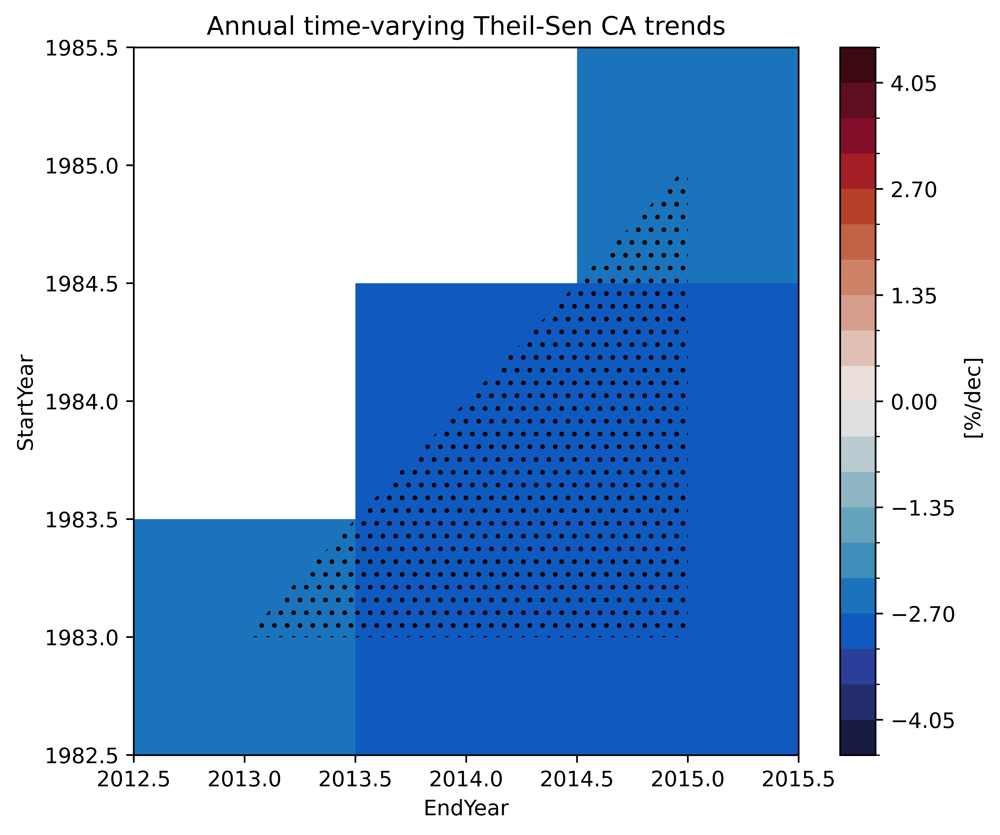

In [63]:
plt.close()
condition = (running_tendencias_xarray["EndYear"] >= 30 + running_tendencias_xarray["StartYear"])
running_tendencias_xarray = running_tendencias_xarray.where(condition, drop=True)
running_sign_99_xarray = running_sign_99_xarray.where(condition, drop=True)
running_sign_95_xarray = running_sign_95_xarray.where(condition, drop=True)
running_sign_90_xarray = running_sign_90_xarray.where(condition, drop=True)

xrdata = running_tendencias_xarray

valor_minimo = -4.5
valor_maximo = 4.5
delta_valor = 0.1

xticks_min = 2013
xticks_max = 2016
yticks_min = 1983
yticks_max = 1987
espacio_entre_anios = 1

# ploteo 
fig3 = plt.figure(figsize=[7, 6], dpi=900)  #8.5, 5.5
fig3.patch.set_facecolor('white')            
ax = fig3.add_subplot(111)

###esto para discretizar la paleta:
##
mi_cmap = cmocean.cm.balance # define the colormap  diff al reves
## extract all colors from the .rain map
mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
## create the new map
mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', mi_cmaplist, mi_cmap.N)
## define the bins and normalize
bounds = np.linspace(valor_minimo, valor_maximo, 21)
norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
##fin de discretizado de paleta

xrdata.plot(ax=ax,levels=np.arange(valor_minimo, valor_maximo, delta_valor),
            cmap=mi_cmap2, norm =norm,extend='neither')
# grafico puntos en los lugares donde es significativo
#running_sign_99_xarray.plot(ax=ax)
running_sign_99_xarray.plot.contourf(ax=ax, levels=[0, 1], hatches=['..'], alpha=0, add_colorbar=False)
running_sign_95_xarray.plot.contourf(ax=ax, levels=[0, 1], hatches=['//'], alpha=0, add_colorbar=False)
#running_sign_90_xarray.plot.contourf(ax=ax, levels=[0, 1], hatches=['++'], alpha=0, add_colorbar=False)

ax.set_facecolor('white')

#seteo ejes
#ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
#ax.set_xticklabels(np.arange(xticks_min, xticks_max+1,espacio_entre_anios))
#plt.xticks(np.arange(xticks_min, xticks_max+1,espacio_entre_anios))
#ax.set_xlabel("End Year")
#ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
#ax.set_yticklabels(np.arange(yticks_min, yticks_max+1, espacio_entre_anios))
#plt.yticks(np.arange(yticks_min, yticks_max+1,espacio_entre_anios))
#ax.set_ylabel("Start Year")

plt.title("Annual time-varying Theil-Sen CA trends")

#la guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE FIGURE RUNNING TENDENCIES")
plt.savefig("figuraRunningTendenciesISCCP.png")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))

plt.show()

In [64]:
#variables crudas con tendencias PARA POSTER

#fig = plt.figure(num=1, figsize=(9, 4), dpi=1000)
#plt.subplot(2, 1, 1)
#plt.plot(CI_mensuales_media_regional_data_2, color = "#D23232", linewidth = 0.8, alpha = 0.8)
#plt.plot(CI_mensuales_media_regional_data_2.index, CI_mensuales_media_regional_data_2_media_movil, color = "#D23232", linewidth = 2, alpha = 1)
#
##ylim = 31.25
##ylim = 4
##plt.ylim((-ylim,ylim))
#plt.ylim((10,80))
##plt.yticks(np.arange(-ylim,ylim+1, 7.8125))
##plt.yticks(np.arange(-ylim,ylim+1, 1))
##plt.ylabel("%")
#plt.ylabel("%")
#plt.xlabel("Fecha")  
#plt.axhline(y=0, color='grey', linestyle='-')
#plt.legend(["SMN CI"], loc ="lower left")
#plt.grid()
#plt.tight_layout()
#
#tendencia_smn_sen = tendencia_theil_sen(CI_mensuales_media_regional_data_2, fuente = "SMN")
#pendiente_smn_sen = tendencia_smn_sen[1]
#origen_smn_sen = tendencia_smn_sen[0]
#significativo_smn_sen_99 = tendencia_smn_sen[2]
#significativo_smn_sen_95 = tendencia_smn_sen[3]
#significativo_smn_sen_90 = tendencia_smn_sen[4]
#
#grafico_tendencia_smn_sen = origen_smn_sen + pendiente_smn_sen * np.arange(0, len(CI_mensuales_media_regional_data_2.index), 1)
#if significativo_smn_sen_99 == True:
#    plt.text(8000, 70.5, f"{round(pendiente_smn_sen*10*12, 2)} %/dec ***",color="k", 
#                     ha="center", va = "center", fontsize =  'small',
#                     weight='bold') #horizontalalignment='center', verticalalignment='center'
#elif significativo_smn_sen_99 == False and significativo_smn_sen_95 == True:
#    plt.text(8000, 70.5, f"{round(pendiente_smn_sen*10*12, 2)} %/dec **",color="k", 
#                     ha="center", va = "center", fontsize =  'small',
#                     weight='bold') #horizontalalignment='center', verticalalignment='center'
#elif significativo_smn_sen_99 == False and significativo_smn_sen_95 == False and significativo_smn_sen_90 == True:
#    plt.text(8000, 70.5, f"{round(pendiente_smn_sen*10*12, 2)} %/dec *",color="k", 
#                     ha="center", va = "center", fontsize =  'small',
#                     weight='bold') #horizontalalignment='center', verticalalignment='center'
#else:
#    plt.text(8000, 70.5, f"{round(pendiente_smn_sen*10*12, 2)} %/dec",color="k", 
#                     ha="center", va = "center", fontsize =  'small',
#                     weight='bold') #horizontalalignment='center', verticalalignment='center'
        
##grafico tendencia lineal por thail-sen
#plt.plot(CI_mensuales_media_regional_data_2.index, 
#             grafico_tendencia_smn_sen,color = "k", alpha = 0.9)

#plt.show

In [65]:
#Table 4. Calculo tendencias por estaciones

#calculo serie de medias estacionales de la media regional
#smn
#absoluto
#hago medias estacionales y luego hago la media regional de esas series
def calculo_medias_estaciones_smn(serie, estacion = "DJF"):
    serie_fechas = pd.to_datetime(serie.index)
    medias_estacion_list =  [] #donde se van acomodando los datos
    for anio in serie_fechas.year.unique():#iterar sobre los anios
        data_anio = serie[serie.index.year == anio]
        #data_anio = xrdata.sel[dict(time = xrdata.time[serie_fechas.year == anio])]
        if estacion == "DJF":
            try:
                data_anio_previo = serie[serie.index.year == anio-1]
                Dec = data_anio_previo[data_anio_previo.index.month == 12]
                Jan = data_anio[data_anio.index.month == 1]
                Feb = data_anio[data_anio.index.month == 2]
                data_estacion = pd.concat([Dec, Jan, Feb])             
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan
        elif estacion == "MAM":
            try:
                Mar = data_anio[data_anio.index.month ==  3]
                Abr = data_anio[data_anio.index.month ==  4]
                May = data_anio[data_anio.index.month ==  5]
                data_estacion = pd.concat([Mar,Abr,May])                
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan          
        elif estacion == "JJA":
            try:
                Jun = data_anio[data_anio.index.month == 6]
                Jul = data_anio[data_anio.index.month == 7]
                Ag = data_anio[data_anio.index.month == 8]
                data_estacion = pd.concat([Jun, Jul, Ag])                  
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)        
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan   
        elif estacion == "SON":
            try:
                Sep = data_anio[data_anio.index.month == 9]
                Oct = data_anio[data_anio.index.month == 10]
                Nov = data_anio[data_anio.index.month == 11]
                data_estacion = pd.concat([Sep,Oct,Nov])                  
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan        
    #xr_medias_estacion = xr.concat(xr_medias_estacion_list, dim = "time")
    medias_estacion_df = pd.DataFrame(medias_estacion_list)
    medias_estacion_df.index = serie_fechas.year.unique()
    return medias_estacion_df
#medias_mensuales_smn_media_regional[medias_mensuales_smn_media_regional.index.month==12]

################ periodo 1983-2016 ################
ci_series_medias_estacionales_DJF_estaciones_ordenadas = [calculo_medias_estaciones_smn(data_CI_mensuales[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "DJF") for i in ides_omm_ordenado]
ci_series_medias_estacionales_MAM_estaciones_ordenadas = [calculo_medias_estaciones_smn(data_CI_mensuales[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "MAM") for i in ides_omm_ordenado]
ci_series_medias_estacionales_JJA_estaciones_ordenadas = [calculo_medias_estaciones_smn(data_CI_mensuales[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "JJA") for i in ides_omm_ordenado]
ci_series_medias_estacionales_SON_estaciones_ordenadas = [calculo_medias_estaciones_smn(data_CI_mensuales[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "SON") for i in ides_omm_ordenado]
ci_series_medias_estacionales_estaciones_ordenadas_list = [ci_series_medias_estacionales_DJF_estaciones_ordenadas,
                                                        ci_series_medias_estacionales_MAM_estaciones_ordenadas,
                                                        ci_series_medias_estacionales_JJA_estaciones_ordenadas,
                                                        ci_series_medias_estacionales_SON_estaciones_ordenadas]
#ci_series_medias_estacionales_estaciones_ordenadas_list #4 ELEMENTOS: 1: DJF, 2:MAM, 3:JJA, 4:SON cada elemento una lista con tantos elementos copmo estaciones_ordenadas (en ese orden ;))

ci_smn_series_medias_estacionales_media_regional_DJF = pd.concat(ci_series_medias_estacionales_estaciones_ordenadas_list[0], axis = 1).mean(axis = 1, skipna = True)
ci_smn_series_medias_estacionales_media_regional_MAM = pd.concat(ci_series_medias_estacionales_estaciones_ordenadas_list[1], axis = 1).mean(axis = 1, skipna = True)
ci_smn_series_medias_estacionales_media_regional_JJA = pd.concat(ci_series_medias_estacionales_estaciones_ordenadas_list[2], axis = 1).mean(axis = 1, skipna = True)
ci_smn_series_medias_estacionales_media_regional_SON = pd.concat(ci_series_medias_estacionales_estaciones_ordenadas_list[3], axis = 1).mean(axis = 1, skipna = True)

#calculo la tendencia de theil-sen
ci_smn_series_medias_estacionales_media_regional_DJF_tendencia_1983_2016 = tendencia_theil_sen(ci_smn_series_medias_estacionales_media_regional_DJF, "ISCCP_2")
ci_smn_series_medias_estacionales_media_regional_MAM_tendencia_1983_2016 = tendencia_theil_sen(ci_smn_series_medias_estacionales_media_regional_MAM, "ISCCP_2")
ci_smn_series_medias_estacionales_media_regional_JJA_tendencia_1983_2016 = tendencia_theil_sen(ci_smn_series_medias_estacionales_media_regional_JJA, "ISCCP_2")
ci_smn_series_medias_estacionales_media_regional_SON_tendencia_1983_2016 = tendencia_theil_sen(ci_smn_series_medias_estacionales_media_regional_SON, "ISCCP_2")

tabla_tendencias_ci_1983_2016 =  pd.DataFrame({"DJF": [ci_smn_series_medias_estacionales_media_regional_DJF_tendencia_1983_2016[1],ci_smn_series_medias_estacionales_media_regional_DJF_tendencia_1983_2016[5]],
                                              "MAM": [ci_smn_series_medias_estacionales_media_regional_MAM_tendencia_1983_2016[1],ci_smn_series_medias_estacionales_media_regional_MAM_tendencia_1983_2016[5]],
                                              "JJA": [ci_smn_series_medias_estacionales_media_regional_JJA_tendencia_1983_2016[1],ci_smn_series_medias_estacionales_media_regional_JJA_tendencia_1983_2016[5]],
                                              "SON": [ci_smn_series_medias_estacionales_media_regional_SON_tendencia_1983_2016[1],ci_smn_series_medias_estacionales_media_regional_SON_tendencia_1983_2016[5]]}).transpose()
tabla_tendencias_ci_1983_2016.columns = ["CI_1983_2016_tendencia","CI_1983_2016_p_valor"]
tabla_tendencias_ci_1983_2016["CI_1983_2016_tendencia"] = tabla_tendencias_ci_1983_2016["CI_1983_2016_tendencia"]*10
tabla_tendencias_ci_1983_2016.columns = ["CI_1983_2016_tendencia %/dec","CI_1983_2016_p_valor"]

In [66]:
tabla_tendencias_ci_1983_2016

,CI_1983_2016_tendencia %/dec,CI_1983_2016_p_valor
DJF,-1.009291,0.411530
MAM,-1.839708,0.177654
JJA,-0.602184,0.285018
SON,-0.907436,0.313869


In [67]:
#hago lo mismo que antes pero para el periodo 1961-2020
#uso datos de marzo 1961 a febrero 2021 para tener estaciones completas 

ci_series_medias_estacionales_DJF_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(data_CI_mensuales[i][fecha_inicio_str_2: fecha_final_str_2], estacion = "DJF") for i in ides_omm_ordenado]
ci_series_medias_estacionales_MAM_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(data_CI_mensuales[i][fecha_inicio_str_2: fecha_final_str_2], estacion = "MAM") for i in ides_omm_ordenado]
ci_series_medias_estacionales_JJA_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(data_CI_mensuales[i][fecha_inicio_str_2: fecha_final_str_2], estacion = "JJA") for i in ides_omm_ordenado]
ci_series_medias_estacionales_SON_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(data_CI_mensuales[i][fecha_inicio_str_2: fecha_final_str_2], estacion = "SON") for i in ides_omm_ordenado]
ci_series_medias_estacionales_estaciones_ordenadas_list_2 = [ci_series_medias_estacionales_DJF_estaciones_ordenadas_2,
                                                        ci_series_medias_estacionales_MAM_estaciones_ordenadas_2,
                                                        ci_series_medias_estacionales_JJA_estaciones_ordenadas_2,
                                                        ci_series_medias_estacionales_SON_estaciones_ordenadas_2]

ci_smn_series_medias_estacionales_media_regional_DJF_2 = pd.concat(ci_series_medias_estacionales_estaciones_ordenadas_list_2[0], axis = 1).mean(axis = 1, skipna = True)
ci_smn_series_medias_estacionales_media_regional_MAM_2 = pd.concat(ci_series_medias_estacionales_estaciones_ordenadas_list_2[1], axis = 1).mean(axis = 1, skipna = True)
ci_smn_series_medias_estacionales_media_regional_JJA_2 = pd.concat(ci_series_medias_estacionales_estaciones_ordenadas_list_2[2], axis = 1).mean(axis = 1, skipna = True)
ci_smn_series_medias_estacionales_media_regional_SON_2 = pd.concat(ci_series_medias_estacionales_estaciones_ordenadas_list_2[3], axis = 1).mean(axis = 1, skipna = True)

#calculo la tendencia de theil-sen
ci_smn_series_medias_estacionales_media_regional_DJF_tendencia_1961_2021 = tendencia_theil_sen(ci_smn_series_medias_estacionales_media_regional_DJF_2, "ISCCP_2")
ci_smn_series_medias_estacionales_media_regional_MAM_tendencia_1961_2021 = tendencia_theil_sen(ci_smn_series_medias_estacionales_media_regional_MAM_2, "ISCCP_2")
ci_smn_series_medias_estacionales_media_regional_JJA_tendencia_1961_2021 = tendencia_theil_sen(ci_smn_series_medias_estacionales_media_regional_JJA_2, "ISCCP_2")
ci_smn_series_medias_estacionales_media_regional_SON_tendencia_1961_2021 = tendencia_theil_sen(ci_smn_series_medias_estacionales_media_regional_SON_2, "ISCCP_2")

tabla_tendencias_ci_1961_2021 =  pd.DataFrame({"DJF": [ci_smn_series_medias_estacionales_media_regional_DJF_tendencia_1961_2021[1],ci_smn_series_medias_estacionales_media_regional_DJF_tendencia_1961_2021[5]],
                                              "MAM": [ci_smn_series_medias_estacionales_media_regional_MAM_tendencia_1961_2021[1],ci_smn_series_medias_estacionales_media_regional_MAM_tendencia_1961_2021[5]],
                                              "JJA": [ci_smn_series_medias_estacionales_media_regional_JJA_tendencia_1961_2021[1],ci_smn_series_medias_estacionales_media_regional_JJA_tendencia_1961_2021[5]],
                                              "SON": [ci_smn_series_medias_estacionales_media_regional_SON_tendencia_1961_2021[1],ci_smn_series_medias_estacionales_media_regional_SON_tendencia_1961_2021[5]]}).transpose()
tabla_tendencias_ci_1961_2021.columns = ["CI_1961_2021_tendencia","CI_1961_2021_p_valor"]
tabla_tendencias_ci_1961_2021["CI_1961_2021_tendencia"] = tabla_tendencias_ci_1961_2021["CI_1961_2021_tendencia"]*10
tabla_tendencias_ci_1961_2021.columns = ["CI_1961_2021_tendencia %/dec","CI_1961_2021_p_valor"]

In [68]:
tabla_tendencias_ci_1961_2021

,CI_1961_2021_tendencia %/dec,CI_1961_2021_p_valor
DJF,-1.087698,0.024360
MAM,-0.226966,0.632405
JJA,-0.841146,0.043197
SON,-0.431512,0.304493


In [69]:
#cargo funciones para calcular la tendencia de satelite de theil sen
from f_procesamiento_satelite import cldamt_tipo, calculo_media_isccp, calculo_desvio_isccp, calculo_tendencia_isccp_theil_sen, calculo_medias_estaciones

isccp_serie_medias_estacionales_DJF = calculo_medias_estaciones(xrdata = isccp_mensual["cldamt"], estacion = "DJF")
isccp_serie_medias_estacionales_DJF_media_regional = isccp_serie_medias_estacionales_DJF.mean(dim = ["lat","lon"], skipna = True, keep_attrs = True)
isccp_serie_medias_estacionales_DJF_media_regional_tendencia = tendencia_theil_sen(isccp_serie_medias_estacionales_DJF_media_regional, "ISCCP_2")

isccp_serie_medias_estacionales_MAM = calculo_medias_estaciones(xrdata = isccp_mensual["cldamt"], estacion = "MAM")
isccp_serie_medias_estacionales_MAM_media_regional = isccp_serie_medias_estacionales_MAM.mean(dim = ["lat","lon"], skipna = True, keep_attrs = True)
isccp_serie_medias_estacionales_MAM_media_regional_tendencia = tendencia_theil_sen(isccp_serie_medias_estacionales_MAM_media_regional, "ISCCP_2")

isccp_serie_medias_estacionales_JJA = calculo_medias_estaciones(xrdata = isccp_mensual["cldamt"], estacion = "JJA")
isccp_serie_medias_estacionales_JJA_media_regional = isccp_serie_medias_estacionales_JJA.mean(dim = ["lat","lon"], skipna = True, keep_attrs = True)
isccp_serie_medias_estacionales_JJA_media_regional_tendencia = tendencia_theil_sen(isccp_serie_medias_estacionales_JJA_media_regional, "ISCCP_2")

isccp_serie_medias_estacionales_SON = calculo_medias_estaciones(xrdata = isccp_mensual["cldamt"], estacion = "SON")
isccp_serie_medias_estacionales_SON_media_regional = isccp_serie_medias_estacionales_SON.mean(dim = ["lat","lon"], skipna = True, keep_attrs = True)
isccp_serie_medias_estacionales_SON_media_regional_tendencia = tendencia_theil_sen(isccp_serie_medias_estacionales_SON_media_regional, "ISCCP_2")

#Armo tabla con tendencia
tabla_tendencias_ISCCP_media_regional_estaciones = pd.DataFrame([[isccp_serie_medias_estacionales_DJF_media_regional_tendencia[1]*10,
             isccp_serie_medias_estacionales_MAM_media_regional_tendencia[1]*10,
             isccp_serie_medias_estacionales_JJA_media_regional_tendencia[1]*10,
             isccp_serie_medias_estacionales_SON_media_regional_tendencia[1]*10],
             [isccp_serie_medias_estacionales_DJF_media_regional_tendencia[5],
             isccp_serie_medias_estacionales_MAM_media_regional_tendencia[5],
             isccp_serie_medias_estacionales_JJA_media_regional_tendencia[5],
             isccp_serie_medias_estacionales_SON_media_regional_tendencia[5]]], 
             index = ["ISCCP_1983_2016_Tendencia (%/dec)", "ISCCP_1983_2016_p-value"]).transpose()
tabla_tendencias_ISCCP_media_regional_estaciones.index = ["DJF", "MAM", "JJA", "SON"]

In [70]:
tabla_tendencias_ISCCP_media_regional_estaciones

,ISCCP_1983_2016_Tendencia (%/dec),ISCCP_1983_2016_p-value
DJF,-2.438647,0.006698
MAM,-4.102075,0.000966
JJA,-1.652088,0.167894
SON,-2.333858,0.011550


In [74]:
#Armo tabla 4
tabla_tendencias = pd.concat([tabla_tendencias_ISCCP_media_regional_estaciones,tabla_tendencias_ci_1983_2016,tabla_tendencias_ci_1961_2021], axis = 1)

#la guardo como excel
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

# create excel writer
writer = pd.ExcelWriter("Table4_CI_CA_tendencies.xlsx")
# write dataframe to excel sheet named 'marks'
tabla_tendencias.to_excel(writer)#, 'info')
# save the excel file
#writer.save()
print(f"SAVE TABLE 4 tabla_tendencias")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY TO:{0}".format(cwd))


CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE TABLE 4 tabla_tendencias


CHANGE THE WORKING DIRECTORY TO:/home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


In [75]:
tabla_tendencias

,ISCCP_1983_2016_Tendencia (%/dec),ISCCP_1983_2016_p-value,CI_1983_2016_tendencia %/dec,CI_1983_2016_p_valor,CI_1961_2021_tendencia %/dec,CI_1961_2021_p_valor
DJF,-2.438647,0.006698,-1.009291,0.411530,-1.087698,0.024360
MAM,-4.102075,0.000966,-1.839708,0.177654,-0.226966,0.632405
JJA,-1.652088,0.167894,-0.602184,0.285018,-0.841146,0.043197
SON,-2.333858,0.011550,-0.907436,0.313869,-0.431512,0.304493


In [76]:
##graficos de las series estacionales 
#serie_anios = pd.date_range(fecha_inicio_str,fecha_final_str).year.unique()
#fig = plt.figure(num=1, figsize=(9, 4), dpi=600)
#plt.subplot(2, 1, 1)
#plt.plot(serie_anios,isccp_serie_medias_estacionales_DJF_media_regional, linewidth = 1.5, alpha = 0.8)
#plt.plot(serie_anios,isccp_serie_medias_estacionales_MAM_media_regional, linewidth = 1.5, alpha = 0.8)
#plt.plot(serie_anios,isccp_serie_medias_estacionales_JJA_media_regional, linewidth = 1.5, alpha = 0.8)
#plt.plot(serie_anios,isccp_serie_medias_estacionales_SON_media_regional, linewidth = 1.5, alpha = 0.8)
#plt.ylim((10,80))
#plt.ylabel("%")
#plt.xlabel("Date")  
#plt.axhline(y=0, color='grey', linestyle='-')
##Si es significativo con 99% agrego un *** 95%: ** 90%: * 
#if isccp_serie_medias_estacionales_DJF_media_regional_tendencia[2] == True:
#    sign_DJF = "***"
#elif isccp_serie_medias_estacionales_DJF_media_regional_tendencia[2] == False and isccp_serie_medias_estacionales_DJF_media_regional_tendencia[3] == True:
#    sign_DJF = "**"
#elif isccp_serie_medias_estacionales_DJF_media_regional_tendencia[2] == False and isccp_serie_medias_estacionales_DJF_media_regional_tendencia[3] == False and isccp_serie_medias_estacionales_DJF_media_regional_tendencia[4] == True:
#    sign_DJF = "*"    
#else:
#    sign_DJF = ""    
#if isccp_serie_medias_estacionales_MAM_media_regional_tendencia[2] == True:
#    sign_MAM = "***"
#elif isccp_serie_medias_estacionales_MAM_media_regional_tendencia[2] == False and isccp_serie_medias_estacionales_MAM_media_regional_tendencia[3] == True:
#    sign_MAM = "**"
#elif isccp_serie_medias_estacionales_MAM_media_regional_tendencia[2] == False and isccp_serie_medias_estacionales_MAM_media_regional_tendencia[3] == False and isccp_serie_medias_estacionales_MAM_media_regional_tendencia[4] == True:
#    sign_MAM = "*"    
#else:
#    sign_MAM = ""
#if isccp_serie_medias_estacionales_JJA_media_regional_tendencia[2] == True:
#    sign_JJA = "***"
#elif isccp_serie_medias_estacionales_JJA_media_regional_tendencia[2] == False and isccp_serie_medias_estacionales_JJA_media_regional_tendencia[3] == True:
#    sign_JJA = "**"
#elif isccp_serie_medias_estacionales_JJA_media_regional_tendencia[2] == False and isccp_serie_medias_estacionales_JJA_media_regional_tendencia[3] == False and isccp_serie_medias_estacionales_JJA_media_regional_tendencia[4] == True:
#    sign_JJA = "*"    
#else:
#    sign_JJA = " "
#if isccp_serie_medias_estacionales_SON_media_regional_tendencia[2] == True:
#    sign_SON = "*"
#elif isccp_serie_medias_estacionales_SON_media_regional_tendencia[2] == False and isccp_serie_medias_estacionales_SON_media_regional_tendencia[3] == True:
#    sign_SON = "**"
#elif isccp_serie_medias_estacionales_SON_media_regional_tendencia[2] == False and isccp_serie_medias_estacionales_SON_media_regional_tendencia[3] == False and isccp_serie_medias_estacionales_SON_media_regional_tendencia[4] == True:
#    sign_SON = "*"    
#else:
#    sign_SON = ""    
#plt.legend([f"DJF: {round(isccp_serie_medias_estacionales_DJF_media_regional_tendencia[1]*10, 2)} %/dec {sign_DJF}",
#            f"MAM: {round(isccp_serie_medias_estacionales_MAM_media_regional_tendencia[1]*10, 2)} %/dec {sign_MAM}",
#            f"JJA: {round(isccp_serie_medias_estacionales_JJA_media_regional_tendencia[1]*10, 2)} %/dec {sign_JJA}",
#            f"SON: {round(isccp_serie_medias_estacionales_SON_media_regional_tendencia[1]*10, 2)} %/dec {sign_SON}"],
#            title="ISCCP CA ", loc ="lower left", prop={'size': 8})
#plt.grid()
#plt.tight_layout()
#
#plt.subplot(2, 1, 2)
#plt.plot(ci_smn_series_medias_estacionales_media_regional_DJF, linewidth = 1.5, alpha = 0.8)
#plt.plot(ci_smn_series_medias_estacionales_media_regional_MAM, linewidth = 1.5, alpha = 0.8)
#plt.plot(ci_smn_series_medias_estacionales_media_regional_JJA, linewidth = 1.5, alpha = 0.8)
#plt.plot(ci_smn_series_medias_estacionales_media_regional_SON, linewidth = 1.5, alpha = 0.8)
#plt.ylim((10,80))
#plt.ylabel("%")
#plt.xlabel("Date")  
#plt.axhline(y=0, color='grey', linestyle='-')
##Si es significativo con 99% agrego un *** 95%: ** 90%: * 
#if ci_smn_series_medias_estacionales_media_regional_DJF_tendencia[2] == True:
#    sign_DJF_CI = "***"
#elif ci_smn_series_medias_estacionales_media_regional_DJF_tendencia[2] == False and ci_smn_series_medias_estacionales_media_regional_DJF_tendencia[3] == True:
#    sign_DJF_CI = "**"
#elif ci_smn_series_medias_estacionales_media_regional_DJF_tendencia[2] == False and ci_smn_series_medias_estacionales_media_regional_DJF_tendencia[3] == False and ci_smn_series_medias_estacionales_media_regional_DJF_tendencia[4] == True:
#    sign_DJF_CI = "*"
#else:
#    sign_DJF_CI = ""    
#if ci_smn_series_medias_estacionales_media_regional_MAM_tendencia[2] == True:
#    sign_MAM_CI = "***"
#elif ci_smn_series_medias_estacionales_media_regional_MAM_tendencia[2] == False and ci_smn_series_medias_estacionales_media_regional_MAM_tendencia[3] == True:
#    sign_MAM_CI = "**"
#elif ci_smn_series_medias_estacionales_media_regional_MAM_tendencia[2] == False and ci_smn_series_medias_estacionales_media_regional_MAM_tendencia[3] == False and ci_smn_series_medias_estacionales_media_regional_MAM_tendencia[4] == True:
#    sign_MAM_CI = "*"
#else:
#    sign_MAM_CI = ""
#if ci_smn_series_medias_estacionales_media_regional_JJA_tendencia[2] == True:
#    sign_JJA_CI = "***"
#elif ci_smn_series_medias_estacionales_media_regional_JJA_tendencia[2] == False and ci_smn_series_medias_estacionales_media_regional_JJA_tendencia[3] == True:
#    sign_JJA_CI = "**"
#elif ci_smn_series_medias_estacionales_media_regional_JJA_tendencia[2] == False and ci_smn_series_medias_estacionales_media_regional_JJA_tendencia[3] == False and ci_smn_series_medias_estacionales_media_regional_JJA_tendencia[4] == True:
#    sign_JJA_CI = "*"
#else:
#    sign_JJA_CI = ""
#if ci_smn_series_medias_estacionales_media_regional_SON_tendencia[2] == True:
#    sign_SON_CI = "***"
#elif ci_smn_series_medias_estacionales_media_regional_SON_tendencia[2] == False and ci_smn_series_medias_estacionales_media_regional_SON_tendencia[3] == True:
#    sign_SON_CI = "**"
#elif ci_smn_series_medias_estacionales_media_regional_SON_tendencia[2] == False and ci_smn_series_medias_estacionales_media_regional_SON_tendencia[3] == False and ci_smn_series_medias_estacionales_media_regional_SON_tendencia[4] == True:
#    sign_SON_CI = "*"
#else:
#    sign_SON_CI = ""   
#plt.legend([f"DJF: {round(ci_smn_series_medias_estacionales_media_regional_DJF_tendencia[1]*10, 2)} %/dec {sign_DJF_CI}",
#            f"MAM: {round(ci_smn_series_medias_estacionales_media_regional_MAM_tendencia[1]*10, 2)} %/dec {sign_MAM_CI}",
#            f"JJA: {round(ci_smn_series_medias_estacionales_media_regional_JJA_tendencia[1]*10, 2)} %/dec {sign_JJA_CI}",
#            f"SON: {round(ci_smn_series_medias_estacionales_media_regional_SON_tendencia[1]*10, 2)} %/dec {sign_SON_CI}"],
#           title="SMN CI ", loc ="lower left", prop={'size': 8})
#plt.grid()
#plt.tight_layout()

## Mapas con tendencias CI SMN

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE FIGURE 6.11


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


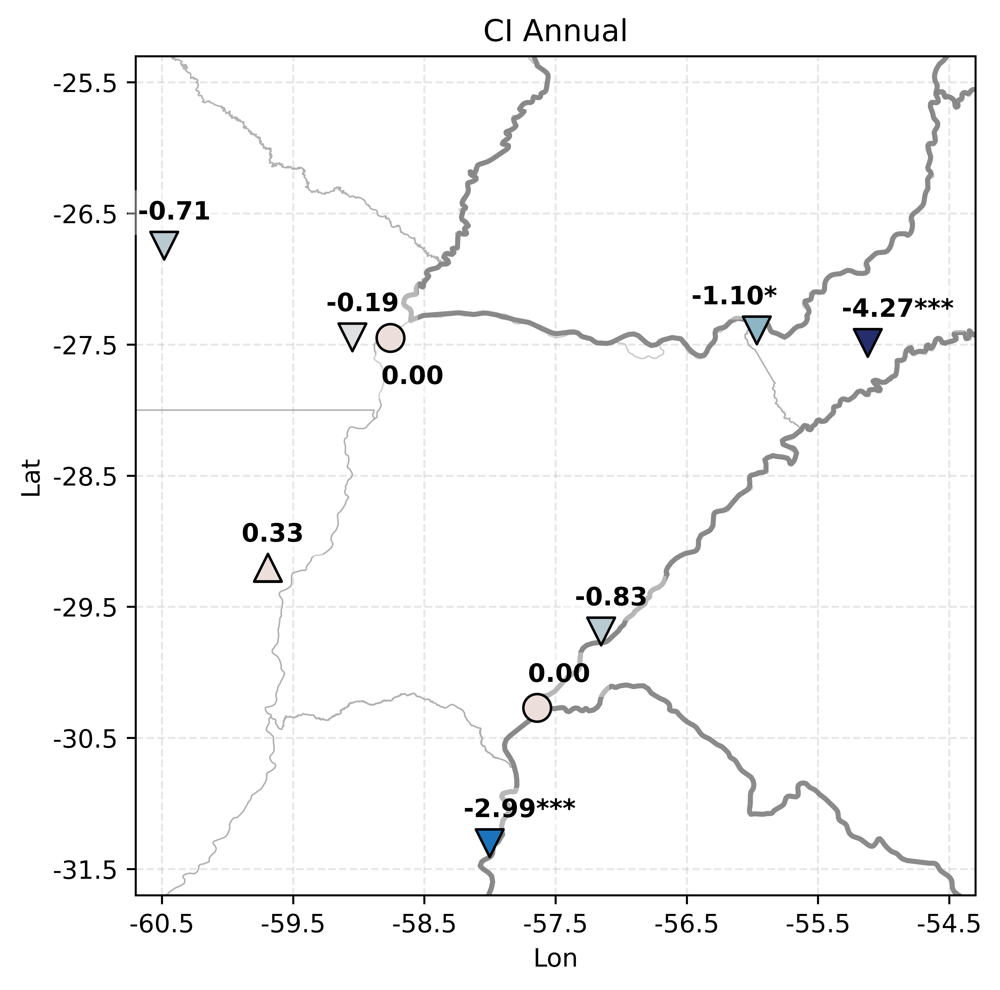

In [77]:
#FIGURE 6.11 Hago mapa con tendencias de CI en estaciones EN PERIODO CLIMATOLOGICO

# Calculo tendencia anual de CI en periodo climatológico de SMN
tendencia_anual_CI_smn = {} 
for id_omm in ides_omm_ordenado: #para cada id_omm_ordenado
    #calculo climatologia
    ci_mensual_df = data_CI_mensuales[id_omm]
    ci_mensual_df.index = pd.to_datetime(ci_mensual_df.index)
    ci_mensual_fechas_climatologia = ci_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    ci_mensual_tendencia_anual_theil_sen = tendencia_theil_sen(ci_mensual_fechas_climatologia, fuente = "SMN")
    tendencia_anual_CI_smn[id_omm] = ci_mensual_tendencia_anual_theil_sen #Lo guardo en diccionario: climatologia_anual_medias_mensuales_smn

#%% Lista puntos smn que efectivamente uso
lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)
#list(estaciones_ordenadas.values())[0]    

#hago lista con valores de tendencia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_CI_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
#distingo entre mayor a cero, menor e igual a cero porque van a tener distinto simbolo
lista_puntos_smn_mayor_a_cero = []
lista_puntos_smn_menor_a_cero = []
lista_puntos_smn_igual_a_cero = []
for i in range(len(lista_puntos_smn_ordenados)):
    if tendencias_anuales_estaciones_ordenadas[i] < 0:  #tendencias_anuales_estaciones_ordenadas[i] < 0
        lista_puntos_smn_menor_a_cero.append(lista_puntos_smn_ordenados[i])
    elif tendencias_anuales_estaciones_ordenadas[i] > 0:
        lista_puntos_smn_mayor_a_cero.append(lista_puntos_smn_ordenados[i])
    else:
        lista_puntos_smn_igual_a_cero.append(lista_puntos_smn_ordenados[i])
valores_menor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor<0]
valores_mayor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor>0]
valores_igual_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor==0]

#hago lista con simbolos de significancia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_CI_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
lista_significancia = []
for est in estaciones_ordenadas.keys():
    if tendencia_anual_CI_smn[est][2] == True:
        lista_significancia.append("***")
    elif tendencia_anual_CI_smn[est][2] == False and tendencia_anual_CI_smn[est][3] == True:
        lista_significancia.append("**")
    elif tendencia_anual_CI_smn[est][2] == False and tendencia_anual_CI_smn[est][3] == False and tendencia_anual_CI_smn[est][4] == True:
        lista_significancia.append("*")
    else:
        lista_significancia.append(" ")

#grafico
from f_mis_shapes import df_paises, df_provincias
import geopandas as gpd
from shapely.geometry import Point
import cartopy.crs as ccrs
import cmocean 
import matplotlib as mpl

valor_minimo = -5
valor_maximo = 5
xticks_min = -60.5
xticks_max = -54.5
yticks_min = -31.5
yticks_max = -25.5
espacio_entre_lat_lon = 1
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_CI_smn[i][1]*10*12 for i in ides_omm_ordenado]

#defino puntos a marcar (distingo entre tendencias positivas, negativas o nulas)
geometry_1 = [Point(xy) for xy in lista_puntos_smn_igual_a_cero] #lista con puntos 2
geodata1 = gpd.GeoDataFrame(lista_puntos_smn_igual_a_cero, geometry = geometry_1)
geodata1["valores"] = valores_igual_a_cero

geometry_2 = [Point(xy) for xy in lista_puntos_smn_mayor_a_cero] #lista con puntos 2
geodata2 = gpd.GeoDataFrame(lista_puntos_smn_mayor_a_cero, geometry = geometry_2)
geodata2["valores"] = valores_mayor_a_cero

geometry_3 = [Point(xy) for xy in lista_puntos_smn_menor_a_cero] #lista con puntos 2
geodata3 = gpd.GeoDataFrame(lista_puntos_smn_menor_a_cero, geometry = geometry_3)
geodata3["valores"] = valores_menor_a_cero

fig1 = plt.figure(figsize =  [9.6, 6], dpi = 900)    #dpi = 600
fig1.patch.set_facecolor('white')
ax = fig1.add_subplot(111, projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

#agrego geometrias de fondo: provincias y paises
ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

###esto para discretizar la paleta:
##
mi_cmap = cmocean.cm.balance # define the colormap  diff al reves
## extract all colors from the .rain map
mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
## create the new map
mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', mi_cmaplist, mi_cmap.N)
## define the bins and normalize
bounds = np.linspace(valor_minimo, valor_maximo, 21)
norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
##fin de discretizado de paleta

#grafico puntos
geodata1.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
              markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
              edgecolor = "k", marker='o') #limites de 0 a 8

geodata2.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
              markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
              edgecolor = "k", marker='^') #limites de 0 a 8

geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
              markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
              edgecolor = "k", marker = "v") #limites de 0 a 8

#agrego etiquetas con valores
list_smn_etiquetas = [(lon-0.2-360, lat+0.25) for lon, lat in lista_puntos_smn_ordenados]
for i, clave in enumerate(tendencias_anuales_estaciones_ordenadas):
    if list(estaciones_ordenadas.values())[i] != "Posadas" and list(estaciones_ordenadas.values())[i] != "Corrientes" and list(estaciones_ordenadas.values())[i] != "Resistencia":
        if round(clave,2) == 0:
            t = ax.annotate(f"0.00{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        elif (clave<0) and (len(str(round(clave,2)))<=4):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        elif (clave>0) and (len(str(round(clave,2)))<=3):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        else:
            t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        
    elif list(estaciones_ordenadas.values())[i] == "Corrientes":
        if round(clave,2) == 0:
            t = ax.annotate(f"0.00{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
        elif (clave<0) and (len(str(round(clave,2)))<=4):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
        elif (clave>0) and (len(str(round(clave,2)))<=3):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
        else:
            t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
    
    elif list(estaciones_ordenadas.values())[i] == "Posadas":
        if round(clave,2) == 0:
            t = ax.annotate(f"0.00{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        elif (clave<0) and (len(str(round(clave,2)))<=4):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0]-0.3,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        elif (clave>0) and (len(str(round(clave,2)))<=3):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0]-0.3,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        else:
            t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0]-0.3,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        
    else:
        if round(clave,2) == 0:
            t = ax.annotate(f"0.00{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)
        elif (clave<0) and (len(str(round(clave,2)))<=4):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)
        elif (clave>0) and (len(str(round(clave,2)))<=3):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)
        else:
            t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)
    
    t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))
##agrego titulo a colorbar
#trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
#ann = ax.annotate('%/dec', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

#seteo ejes
ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
ax.set_xticklabels(np.arange(xticks_min, xticks_max+1))
plt.xticks(np.arange(xticks_min, xticks_max+1))
ax.set_xlabel("Lon")
ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
ax.set_yticklabels(np.arange(yticks_min, yticks_max+1))
plt.yticks(np.arange(yticks_min, yticks_max+1))
ax.set_ylabel("Lat")
plt.title("CI Annual")

plt.grid(linestyle="--", alpha=0.3)

print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE FIGURE 6.11")
plt.savefig("Figure6_11_tendencias_anuales_CI_1983_2016.png")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


In [99]:
p_values_CI_anual_1983_2016 = {estaciones_ordenadas[key]: tendencia_anual_CI_smn[key][5] for key in estaciones_ordenadas.keys()}

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE FIGURE 6.12


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


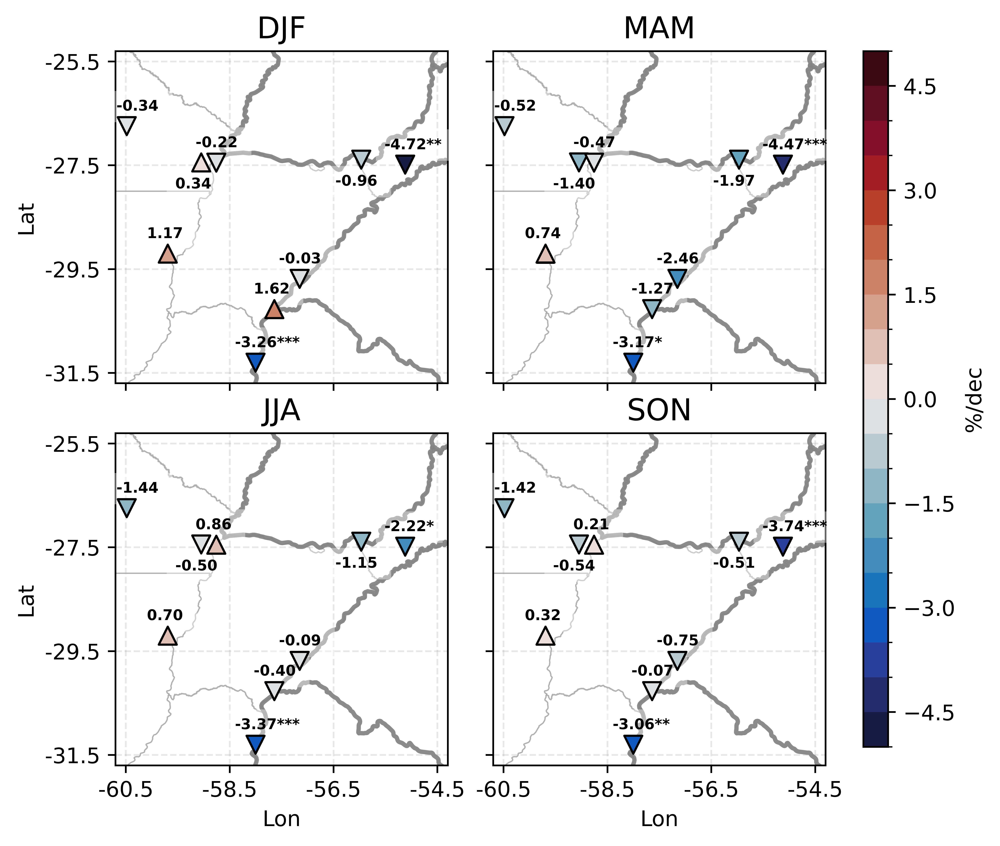

In [100]:
#FIGURE 6.12 tendencias de CI estacionales 1983-2016
estaciones = ["DJF", "MAM", "JJA", "SON"]
posicion = [221, 222, 223, 224]

lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)
lista_puntos_smn_ordenados
list(estaciones_ordenadas.values())[0]    

ci_tendencias_DJF_estaciones_ordenadas = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list[0][i], "SMN")[1]*10 for i in range(len(ides_omm_ordenado))]
ci_tendencias_MAM_estaciones_ordenadas = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list[1][i], "SMN")[1]*10 for i in range(len(ides_omm_ordenado))]
ci_tendencias_JJA_estaciones_ordenadas = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list[2][i], "SMN")[1]*10 for i in range(len(ides_omm_ordenado))]
ci_tendencias_SON_estaciones_ordenadas = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list[3][i], "SMN")[1]*10 for i in range(len(ides_omm_ordenado))]
ci_tendencias_estaciones_ordenadas_list = [ci_tendencias_DJF_estaciones_ordenadas,
                                           ci_tendencias_MAM_estaciones_ordenadas,
                                           ci_tendencias_JJA_estaciones_ordenadas,
                                           ci_tendencias_SON_estaciones_ordenadas]

#significancias
ci_tendencias_DJF_estaciones_ordenadas_significancias = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list[0][i], "SMN") for i in range(len(ides_omm_ordenado))]
ci_tendencias_MAM_estaciones_ordenadas_significancias = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list[1][i], "SMN") for i in range(len(ides_omm_ordenado))]
ci_tendencias_JJA_estaciones_ordenadas_significancias = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list[2][i], "SMN") for i in range(len(ides_omm_ordenado))]
ci_tendencias_SON_estaciones_ordenadas_significancias = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list[3][i], "SMN") for i in range(len(ides_omm_ordenado))]
ci_tendencias_estaciones_ordenadas_list_significancias = [ci_tendencias_DJF_estaciones_ordenadas_significancias,
                                           ci_tendencias_MAM_estaciones_ordenadas_significancias,
                                           ci_tendencias_JJA_estaciones_ordenadas_significancias,
                                           ci_tendencias_SON_estaciones_ordenadas_significancias]

valor_minimo = -5
valor_maximo = 5
xticks_min = -60.5
xticks_max = -54.5
yticks_min = -31.5
yticks_max = -25.5
espacio_entre_lat_lon = 1
#fig1, ax = plt.subplots(2, 2, figsize=[9, 7], dpi=600)
fig1 = plt.figure(figsize = [8, 6], dpi = 900) 
fig1.patch.set_facecolor('white')
for i in range(0,4):    
    ###########
    #distingo entre mayor a cero, menor e igual a cero porque van a tener distinto simbolo
    lista_puntos_smn_mayor_a_cero = []
    lista_puntos_smn_menor_a_cero = []
    lista_puntos_smn_igual_a_cero = []
    for j in range(len(lista_puntos_smn_ordenados)):
        if ci_tendencias_estaciones_ordenadas_list[i][j] < 0:
            lista_puntos_smn_menor_a_cero.append(lista_puntos_smn_ordenados[j])
        elif ci_tendencias_estaciones_ordenadas_list[i][j] > 0:
            lista_puntos_smn_mayor_a_cero.append(lista_puntos_smn_ordenados[j])
        elif ci_tendencias_estaciones_ordenadas_list[i][j] == 0:
            lista_puntos_smn_igual_a_cero.append(lista_puntos_smn_ordenados[j])

    valores_menor_a_cero = [valor for valor in ci_tendencias_estaciones_ordenadas_list[i] if valor<0]
    valores_mayor_a_cero = [valor for valor in ci_tendencias_estaciones_ordenadas_list[i] if valor>0]
    valores_igual_a_cero = [valor for valor in ci_tendencias_estaciones_ordenadas_list[i] if valor==0]

    #hago lista con simbolos de significancia
    lista_significancia = []
    for est in range(0, len(estaciones_ordenadas.keys())):
        if ci_tendencias_estaciones_ordenadas_list_significancias[i][est][2] == True:
            lista_significancia.append("***")
        elif ci_tendencias_estaciones_ordenadas_list_significancias[i][est][2] == False and ci_tendencias_estaciones_ordenadas_list_significancias[i][est][3] == True:
            lista_significancia.append("**")
        elif ci_tendencias_estaciones_ordenadas_list_significancias[i][est][2] == False and ci_tendencias_estaciones_ordenadas_list_significancias[i][est][3] == False and ci_tendencias_estaciones_ordenadas_list_significancias[i][est][4] == True:
            lista_significancia.append("*")
        else:
            lista_significancia.append(" ")
    ###########
    
    ax = fig1.add_subplot(posicion[i], projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

    #agrego geometrias de fondo: provincias y paises
    ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
    ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

    #defino puntos a marcar los distingo por tendencia positiva negativa o nula
    
    geometry_1 = [Point(xy) for xy in lista_puntos_smn_igual_a_cero] #lista con puntos 2
    geodata1 = gpd.GeoDataFrame(lista_puntos_smn_igual_a_cero, geometry = geometry_1)
    geodata1["valores"] = valores_igual_a_cero

    geometry_2 = [Point(xy) for xy in lista_puntos_smn_mayor_a_cero] #lista con puntos 2
    geodata2 = gpd.GeoDataFrame(lista_puntos_smn_mayor_a_cero, geometry = geometry_2)
    geodata2["valores"] = valores_mayor_a_cero

    geometry_3 = [Point(xy) for xy in lista_puntos_smn_menor_a_cero] #lista con puntos 2
    geodata3 = gpd.GeoDataFrame(lista_puntos_smn_menor_a_cero, geometry = geometry_3)
    geodata3["valores"] = valores_menor_a_cero


    mi_cmap = cmocean.cm.balance # define the colormap  rain
    # extract all colors from the .rain map
    mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
    # create the new map
    mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
        'Custom cmap', mi_cmaplist, mi_cmap.N)
    # define the bins and normalize
    bounds = np.linspace(valor_minimo, valor_maximo, 21)
    norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
    ##fin de discretizado de paleta

    #grafico puntos
    #geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
    #              markersize = 200, cmap=cmocean.cm.rain, zorder=3,legend=True, ax = ax) #limites de 0 a 8

    geodata1.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                      markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                  edgecolor = "k", marker = "o") #limites de 0 a 8
    
    geodata2.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                      markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                  edgecolor = "k", marker = '^') #limites de 0 a 8
    
    geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                      markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                  edgecolor = "k", marker = "v") #limites de 0 a 8

    #agrego etiquetas con valores
    list_smn_etiquetas = [(lon-0.3-360, lat+0.30) for lon, lat in lista_puntos_smn_ordenados]
    for j, clave in enumerate(ci_tendencias_estaciones_ordenadas_list[i]):
        if list(estaciones_ordenadas.values())[j] != "Resistencia" and list(estaciones_ordenadas.values())[j] != "Posadas" and list(estaciones_ordenadas.values())[j] != "Roque Saenz Peña":
            if round(clave,2) == 0:
                t = ax.annotate(f"0.00{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            elif (clave<0) and (len(str(round(clave,2)))<=4):
                t = ax.annotate(f"{round(clave,2)}0{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            elif (clave>0) and (len(str(round(clave,2)))<=3):
                t = ax.annotate(f"{round(clave,2)}0{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
        
        elif list(estaciones_ordenadas.values())[j] == "Roque Saenz Peña":
            if round(clave,2)== 0:
                t = ax.annotate(f"0.00{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            elif (clave<0) and (len(str(round(clave,2)))<=4):
                t = ax.annotate(f"{round(clave,2)}0{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            elif (clave>0) and (len(str(round(clave,2)))<=3):
                t = ax.annotate(f"{round(clave,2)}0{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
        
        else:
            if round(clave,2)== 0:
                t = ax.annotate(f"0.00{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
            elif (clave<0) and (len(str(round(clave,2)))<=4):
                t = ax.annotate(f"{round(clave,2)}0{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
            elif (clave>0) and (len(str(round(clave,2)))<=3):
                t = ax.annotate(f"{round(clave,2)}0{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
        t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

    #agrego titulo a colorbar
    #trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
    #ann = ax.annotate('%/dec', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

    #seteo ejes
    ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
    plt.xticks(np.arange(xticks_min, xticks_max+1, 2))
    if i == 0 or i == 1: #saco levels de x para los dos graficos de arriba
        ax.set_xticklabels([])
    else:
        ax.set_xticklabels(np.arange(xticks_min, xticks_max+1, 2))
        ax.set_xlabel("Lon")
    
    
    ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
    plt.yticks(np.arange(yticks_min, yticks_max+1, 2))
    if i == 1 or i == 3: #saco levels de x para los dos graficos de la derecha
        ax.set_yticklabels([])
    else:
        ax.set_yticklabels(np.arange(yticks_min, yticks_max+1, 2))
        ax.set_ylabel("Lat")
    ax.grid(linestyle="--", alpha=0.3)
    ax.set_title(estaciones[i], size= 14)
    
#fig1.subplots_adjust(right=0.8)
fig1.subplots_adjust(wspace=-0.35,hspace=0.15)
cbar_ax = fig1.add_axes([0.83, 0.13, 0.02, 0.75])

sm = plt.cm.ScalarMappable(cmap=mi_cmap2, norm=norm)
# fake up the array of the scalar mappable. Urgh...
sm._A = []
fig1.colorbar(sm, cax=cbar_ax,label = "%/dec")

print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE FIGURE 6.12")
plt.savefig("Figure6_12_tendencias_estacionales_CI_1983_2016.png")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


In [102]:
#seguir de aca
ci_tendencias_DJF_estaciones_ordenadas_pvalue = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list[0][i], "SMN")[5] for i in range(len(ides_omm_ordenado))]
ci_tendencias_MAM_estaciones_ordenadas_pvalue = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list[1][i], "SMN")[5] for i in range(len(ides_omm_ordenado))]
ci_tendencias_JJA_estaciones_ordenadas_pvalue = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list[2][i], "SMN")[5] for i in range(len(ides_omm_ordenado))]
ci_tendencias_SON_estaciones_ordenadas_pvalue = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list[3][i], "SMN")[5] for i in range(len(ides_omm_ordenado))]
ci_tendencias_estaciones_ordenadas_list_pvalue = [ci_tendencias_DJF_estaciones_ordenadas_pvalue,
                                           ci_tendencias_MAM_estaciones_ordenadas_pvalue,
                                           ci_tendencias_JJA_estaciones_ordenadas_pvalue,
                                           ci_tendencias_SON_estaciones_ordenadas_pvalue]

In [107]:
p_values_CI_DJF_1983_2016 = {estaciones_ordenadas[key]: ci_tendencias_estaciones_ordenadas_list_pvalue[0][i] for i, key in enumerate(estaciones_ordenadas.keys())}
p_values_CI_MAM_1983_2016 = {estaciones_ordenadas[key]: ci_tendencias_estaciones_ordenadas_list_pvalue[1][i] for i, key in enumerate(estaciones_ordenadas.keys())}
p_values_CI_JJA_1983_2016 = {estaciones_ordenadas[key]: ci_tendencias_estaciones_ordenadas_list_pvalue[2][i] for i, key in enumerate(estaciones_ordenadas.keys())}
p_values_CI_SON_1983_2016 = {estaciones_ordenadas[key]: ci_tendencias_estaciones_ordenadas_list_pvalue[3][i] for i, key in enumerate(estaciones_ordenadas.keys())}


In [113]:
p_values_CI_DJF_1983_2016

{'Roque Saenz Peña': 0.7566176419333059,
 'Resistencia': 0.8162147751081346,
 'Corrientes': 0.8524798345806932,
 'Posadas': 0.545656108406517,
 'Oberá': 0.015631030536511492,
 'Reconquista': 0.44771724277486147,
 'Paso de los Libres': 1.0,
 'Montecaseros': 0.4856472470963893,
 'Concordia': 0.004575723489820938}

In [129]:
#seguir de aca
p_annual = pd.DataFrame.from_dict(p_values_CI_anual_1983_2016, orient='index').rename(columns = {0:'Annual'})
p_DJF = pd.DataFrame.from_dict(p_values_CI_DJF_1983_2016, orient='index').rename(columns = {0:'DJF'})
p_MMA = pd.DataFrame.from_dict(p_values_CI_MAM_1983_2016, orient='index').rename(columns = {0:'MAM'})
p_JJA = pd.DataFrame.from_dict(p_values_CI_JJA_1983_2016, orient='index').rename(columns = {0:'JJA'})
p_SON = pd.DataFrame.from_dict(p_values_CI_SON_1983_2016, orient='index').rename(columns = {0:'SON'})

p_values_CI_1983_2016 = pd.concat([p_annual, p_DJF, p_MMA, p_JJA, p_SON], axis=1)

#la guardo como excel
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

# create excel writer
p_values_CI_1983_2016.to_excel("Table_p_values_CI_1983_2016.xlsx")

print(f"SAVE TABLE")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY TO:{0}".format(cwd))



CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE TABLE


CHANGE THE WORKING DIRECTORY TO:/home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE FIGURE 9.11


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


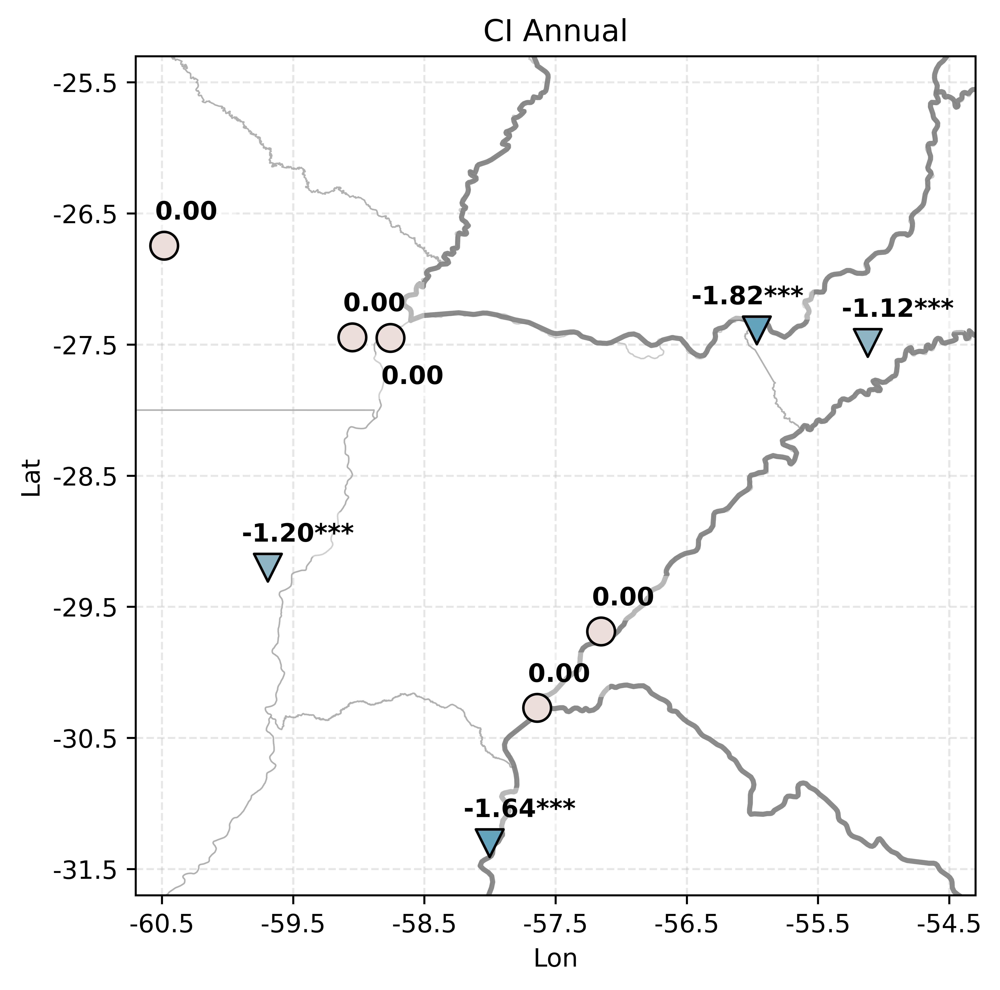

In [98]:
#Figura 9. Repito pero para periodo 1961-2020
#Hago mapa con tendencias en estaciones

# Calculo tendencia anual de CI en periodo climatológico de SMN
tendencia_anual_CI_smn_2 = {} 
#para cada id_omm_ordenado
for id_omm in ides_omm_ordenado:
    #calculo climatologia
    ci_mensual_df = data_CI_mensuales[id_omm]
    ci_mensual_df.index = pd.to_datetime(ci_mensual_df.index)
    ci_mensual_fechas_2 = ci_mensual_df.loc[fecha_inicio_str_2:fecha_final_str_2]
    ci_mensual_tendencia_anual_theil_sen_2 = tendencia_theil_sen(ci_mensual_fechas_2, fuente = "SMN")
    #Lo guardo en diccionario: climatologia_anual_medias_mensuales_smn
    tendencia_anual_CI_smn_2[id_omm] = ci_mensual_tendencia_anual_theil_sen_2

#%% Lista puntos smn que efectivamente uso
#me quedo solo con los puntos de estaciones que efectivamente uso
lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)
lista_puntos_smn_ordenados
list(estaciones_ordenadas.values())[0]    

#hago lista con simbolos de significancia
tendencias_anuales_estaciones_ordenadas_2 = [tendencia_anual_CI_smn_2[i][1]*10*12 for i in estaciones_ordenadas.keys()]

#distingo entre mayor a cero, menor e igual a cero porque van a tener distinto simbolo
lista_puntos_smn_mayor_a_cero = []
lista_puntos_smn_menor_a_cero = []
lista_puntos_smn_igual_a_cero = []
for i in range(len(lista_puntos_smn_ordenados)):
    if tendencias_anuales_estaciones_ordenadas_2[i] < 0:  #tendencias_anuales_estaciones_ordenadas[i] < 0
        lista_puntos_smn_menor_a_cero.append(lista_puntos_smn_ordenados[i])
    elif tendencias_anuales_estaciones_ordenadas_2[i] > 0:
        lista_puntos_smn_mayor_a_cero.append(lista_puntos_smn_ordenados[i])
    else:
        lista_puntos_smn_igual_a_cero.append(lista_puntos_smn_ordenados[i])

valores_menor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas_2 if valor<0]
valores_mayor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas_2 if valor>0]
valores_igual_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas_2 if valor==0]

#hago lista con simbolos de significancia
tendencias_anuales_estaciones_ordenadas_2 = [tendencia_anual_CI_smn_2[i][1]*10*12 for i in estaciones_ordenadas.keys()]
lista_significancia = []
for est in estaciones_ordenadas.keys():
    if tendencia_anual_CI_smn_2[est][2] == True:
        lista_significancia.append("***")
    elif tendencia_anual_CI_smn_2[est][2] == False and tendencia_anual_CI_smn_2[est][3] == True:
        lista_significancia.append("**")
    elif tendencia_anual_CI_smn_2[est][2] == False and tendencia_anual_CI_smn_2[est][3] == False and tendencia_anual_CI_smn_2[est][4] == True:
        lista_significancia.append("*")
    else:
        lista_significancia.append(" ")

from f_mis_shapes import df_paises, df_provincias
import geopandas as gpd
from shapely.geometry import Point
import cartopy.crs as ccrs
import cmocean 
import matplotlib as mpl

valor_minimo = -5
valor_maximo = 5
xticks_min = -60.5
xticks_max = -54.5
yticks_min = -31.5
yticks_max = -25.5
espacio_entre_lat_lon = 1
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_CI_smn_2[i][1]*10*12 for i in ides_omm_ordenado]

#defino puntos a marcar (distingo entre tendencias positivas, negativas o nulas)
geometry_1 = [Point(xy) for xy in lista_puntos_smn_igual_a_cero] #lista con puntos 2
geodata1 = gpd.GeoDataFrame(lista_puntos_smn_igual_a_cero, geometry = geometry_1)
geodata1["valores"] = valores_igual_a_cero

geometry_2 = [Point(xy) for xy in lista_puntos_smn_mayor_a_cero] #lista con puntos 2
geodata2 = gpd.GeoDataFrame(lista_puntos_smn_mayor_a_cero, geometry = geometry_2)
geodata2["valores"] = valores_mayor_a_cero

geometry_3 = [Point(xy) for xy in lista_puntos_smn_menor_a_cero] #lista con puntos 2
geodata3 = gpd.GeoDataFrame(lista_puntos_smn_menor_a_cero, geometry = geometry_3)
geodata3["valores"] = valores_menor_a_cero

fig1 = plt.figure(figsize = [9.6, 6], dpi = 900)    #600
fig1.patch.set_facecolor('white')
ax = fig1.add_subplot(111, projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

#agrego geometrias de fondo: provincias y paises
ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

##esto para discretizar la paleta:

#
mi_cmap = cmocean.cm.balance # define the colormap  diff al reves
# extract all colors from the .rain map
mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
# create the new map
mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', mi_cmaplist, mi_cmap.N)
# define the bins and normalize
bounds = np.linspace(valor_minimo, valor_maximo, 21)
norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
##fin de discretizado de paleta

#grafico puntos
geodata1.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
              markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
              edgecolor = "k", marker='o') #limites de 0 a 8

geodata2.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
              markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
              edgecolor = "k", marker='^') #limites de 0 a 8

geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
              markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
              edgecolor = "k", marker = "v") #limites de 0 a 8



#agrego etiquetas con valores
list_smn_etiquetas = [(lon-0.2-360, lat+0.25) for lon, lat in lista_puntos_smn_ordenados]
for i, clave in enumerate(tendencias_anuales_estaciones_ordenadas_2):
    if list(estaciones_ordenadas.values())[i] != "Posadas" and list(estaciones_ordenadas.values())[i] != "Corrientes" and list(estaciones_ordenadas.values())[i] != "Resistencia":
        if round(clave,2) == 0:
            t = ax.annotate(f"0.00{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        elif (clave<0) and (len(str(round(clave,2)))<=4):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        elif (clave>0) and (len(str(round(clave,2)))<=3):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        else:
            t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        
    elif list(estaciones_ordenadas.values())[i] == "Corrientes":
        if round(clave,2) == 0:
            t = ax.annotate(f"0.00{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
        elif (clave<0) and (len(str(round(clave,2)))<=4):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
        elif (clave>0) and (len(str(round(clave,2)))<=3):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
        else:
            t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
    
    elif list(estaciones_ordenadas.values())[i] == "Posadas":
        if round(clave,2) == 0:
            t = ax.annotate(f"0.00{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        elif (clave<0) and (len(str(round(clave,2)))<=4):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0]-0.3,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        elif (clave>0) and (len(str(round(clave,2)))<=3):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0]-0.3,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        else:
            t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0]-0.3,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        
    else:
        if round(clave,2) == 0:
            t = ax.annotate(f"0.00{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)
        elif (clave<0) and (len(str(round(clave,2)))<=4):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)
        elif (clave>0) and (len(str(round(clave,2)))<=3):
            t = ax.annotate(f"{round(clave,2)}0{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)
        else:
            t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)
    
    t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))
    t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

#agrego titulo a colorbar
#trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
#ann = ax.annotate('%/dec', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

#seteo ejes
ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
ax.set_xticklabels(np.arange(xticks_min, xticks_max+1))
plt.xticks(np.arange(xticks_min, xticks_max+1))
ax.set_xlabel("Lon")
ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
ax.set_yticklabels(np.arange(yticks_min, yticks_max+1))
plt.yticks(np.arange(yticks_min, yticks_max+1))
ax.set_ylabel("Lat")

plt.title("CI Annual")
#plt.title("CI Anual")

plt.grid(linestyle="--", alpha=0.3)

print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE FIGURE 9.11")
plt.savefig("Figure9_11_tendencias_anuales_CI_1961_2021.png")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))



In [108]:
#Figura 9. Repito pero para periodo 1961-2020
#Hago mapa con tendencias en estaciones por estacion

estaciones = ["DJF", "MAM", "JJA", "SON"]
#estaciones = ["DEF", "MAM", "JJA", "SON"]
posicion = [221, 222, 223, 224]

lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)
lista_puntos_smn_ordenados
list(estaciones_ordenadas.values())[0]    

ci_tendencias_DJF_estaciones_ordenadas = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list_2[0][i], "SMN")[1]*10 for i in range(len(ides_omm_ordenado))]
ci_tendencias_MAM_estaciones_ordenadas = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list_2[1][i], "SMN")[1]*10 for i in range(len(ides_omm_ordenado))]
ci_tendencias_JJA_estaciones_ordenadas = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list_2[2][i], "SMN")[1]*10 for i in range(len(ides_omm_ordenado))]
ci_tendencias_SON_estaciones_ordenadas = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list_2[3][i], "SMN")[1]*10 for i in range(len(ides_omm_ordenado))]
ci_tendencias_estaciones_ordenadas_list = [ci_tendencias_DJF_estaciones_ordenadas,
                                           ci_tendencias_MAM_estaciones_ordenadas,
                                           ci_tendencias_JJA_estaciones_ordenadas,
                                           ci_tendencias_SON_estaciones_ordenadas]

#significancias
ci_tendencias_DJF_estaciones_ordenadas_significancias = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list_2[0][i], "SMN") for i in range(len(ides_omm_ordenado))]
ci_tendencias_MAM_estaciones_ordenadas_significancias = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list_2[1][i], "SMN") for i in range(len(ides_omm_ordenado))]
ci_tendencias_JJA_estaciones_ordenadas_significancias = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list_2[2][i], "SMN") for i in range(len(ides_omm_ordenado))]
ci_tendencias_SON_estaciones_ordenadas_significancias = [tendencia_theil_sen(ci_series_medias_estacionales_estaciones_ordenadas_list_2[3][i], "SMN") for i in range(len(ides_omm_ordenado))]
ci_tendencias_estaciones_ordenadas_list_significancias = [ci_tendencias_DJF_estaciones_ordenadas_significancias,
                                           ci_tendencias_MAM_estaciones_ordenadas_significancias,
                                           ci_tendencias_JJA_estaciones_ordenadas_significancias,
                                           ci_tendencias_SON_estaciones_ordenadas_significancias]

valor_minimo = -5
valor_maximo = 5
xticks_min = -60.5
xticks_max = -54.5
yticks_min = -31.5
yticks_max = -25.5
espacio_entre_lat_lon = 1
#fig1, ax = plt.subplots(2, 2, figsize=[9, 7], dpi=600)
fig1 = plt.figure(figsize = [8, 6], dpi = 900) 
fig1.patch.set_facecolor('white')
for i in range(0,4):
    ###########
    #distingo entre mayor a cero, menor e igual a cero porque van a tener distinto simbolo
    lista_puntos_smn_mayor_a_cero = []
    lista_puntos_smn_menor_a_cero = []
    lista_puntos_smn_igual_a_cero = []
    for j in range(len(lista_puntos_smn_ordenados)):
        if ci_tendencias_estaciones_ordenadas_list[i][j] < 0:
            lista_puntos_smn_menor_a_cero.append(lista_puntos_smn_ordenados[j])
        elif ci_tendencias_estaciones_ordenadas_list[i][j] > 0:
            lista_puntos_smn_mayor_a_cero.append(lista_puntos_smn_ordenados[j])
        elif ci_tendencias_estaciones_ordenadas_list[i][j] == 0:
            lista_puntos_smn_igual_a_cero.append(lista_puntos_smn_ordenados[j])

    valores_menor_a_cero = [valor for valor in ci_tendencias_estaciones_ordenadas_list[i] if valor<0]
    valores_mayor_a_cero = [valor for valor in ci_tendencias_estaciones_ordenadas_list[i] if valor>0]
    valores_igual_a_cero = [valor for valor in ci_tendencias_estaciones_ordenadas_list[i] if valor==0]

    #hago lista con simbolos de significancia
    lista_significancia = []
    for est in range(0, len(estaciones_ordenadas.keys())):
        if ci_tendencias_estaciones_ordenadas_list_significancias[i][est][2] == True:
            lista_significancia.append("***")
        elif ci_tendencias_estaciones_ordenadas_list_significancias[i][est][2] == False and ci_tendencias_estaciones_ordenadas_list_significancias[i][est][3] == True:
            lista_significancia.append("**")
        elif ci_tendencias_estaciones_ordenadas_list_significancias[i][est][2] == False and ci_tendencias_estaciones_ordenadas_list_significancias[i][est][3] == False and ci_tendencias_estaciones_ordenadas_list_significancias[i][est][4] == True:
            lista_significancia.append("*")
        else:
            lista_significancia.append(" ")
    ###########
    
    ax = fig1.add_subplot(posicion[i], projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

    #agrego geometrias de fondo: provincias y paises
    ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
    ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                      edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

    #defino puntos a marcar los distingo por tendencia positiva negativa o nula
    
    geometry_1 = [Point(xy) for xy in lista_puntos_smn_igual_a_cero] #lista con puntos 2
    geodata1 = gpd.GeoDataFrame(lista_puntos_smn_igual_a_cero, geometry = geometry_1)
    geodata1["valores"] = valores_igual_a_cero

    geometry_2 = [Point(xy) for xy in lista_puntos_smn_mayor_a_cero] #lista con puntos 2
    geodata2 = gpd.GeoDataFrame(lista_puntos_smn_mayor_a_cero, geometry = geometry_2)
    geodata2["valores"] = valores_mayor_a_cero

    geometry_3 = [Point(xy) for xy in lista_puntos_smn_menor_a_cero] #lista con puntos 2
    geodata3 = gpd.GeoDataFrame(lista_puntos_smn_menor_a_cero, geometry = geometry_3)
    geodata3["valores"] = valores_menor_a_cero


    mi_cmap = cmocean.cm.balance # define the colormap  rain
    # extract all colors from the .rain map
    mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
    # create the new map
    mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
        'Custom cmap', mi_cmaplist, mi_cmap.N)
    # define the bins and normalize
    bounds = np.linspace(valor_minimo, valor_maximo, 21)
    norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
    ##fin de discretizado de paleta

    #grafico puntos
    #geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
    #              markersize = 200, cmap=cmocean.cm.rain, zorder=3,legend=True, ax = ax) #limites de 0 a 8

    geodata1.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                      markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                  edgecolor = "k", marker = "o") #limites de 0 a 8
    
    geodata2.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                      markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                  edgecolor = "k", marker = '^') #limites de 0 a 8
    
    geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                      markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                  edgecolor = "k", marker = "v") #limites de 0 a 8

    #agrego etiquetas con valores
    list_smn_etiquetas = [(lon-0.3-360, lat+0.30) for lon, lat in lista_puntos_smn_ordenados]
    for j, clave in enumerate(ci_tendencias_estaciones_ordenadas_list[i]):
        if list(estaciones_ordenadas.values())[j] != "Resistencia" and list(estaciones_ordenadas.values())[j] != "Posadas" and list(estaciones_ordenadas.values())[j] != "Roque Saenz Peña":
            if round(clave,2) == 0:
                t = ax.annotate(f"0.00{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            elif (clave<0) and (len(str(round(clave,2)))<=4):
                t = ax.annotate(f"{round(clave,2)}0{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            elif (clave>0) and (len(str(round(clave,2)))<=3):
                t = ax.annotate(f"{round(clave,2)}0{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
        elif list(estaciones_ordenadas.values())[j] == "Roque Saenz Peña":
            if round(clave,2) == 0:
                t = ax.annotate(f"0.00{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            elif (clave<0) and (len(str(round(clave,2)))<=4):
                t = ax.annotate(f"{round(clave,2)}0{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            elif (clave>0) and (len(str(round(clave,2)))<=3):
                t = ax.annotate(f"{round(clave,2)}0{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
        else:
            if round(clave,2) == 0:
                t = ax.annotate(f"0.00{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
            elif (clave<0) and (len(str(round(clave,2)))<=4):
                t = ax.annotate(f"{round(clave,2)}0{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
            elif (clave>0) and (len(str(round(clave,2)))<=3):
                t = ax.annotate(f"{round(clave,2)}0{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
            
        t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

    #agrego titulo a colorbar
    #trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
    #ann = ax.annotate('%/dec', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

    #seteo ejes
    ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
    plt.xticks(np.arange(xticks_min, xticks_max+1, 2))
    if i == 0 or i == 1: #saco levels de x para los dos graficos de arriba
        ax.set_xticklabels([])
    else:
        ax.set_xticklabels(np.arange(xticks_min, xticks_max+1, 2))
        ax.set_xlabel("Lon")
    
    
    ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
    plt.yticks(np.arange(yticks_min, yticks_max+1, 2))
    if i == 1 or i == 3: #saco levels de x para los dos graficos de la derecha
        ax.set_yticklabels([])
    else:
        ax.set_yticklabels(np.arange(yticks_min, yticks_max+1, 2))
        ax.set_ylabel("Lat")
    ax.grid(linestyle="--", alpha=0.3)
    ax.set_title(estaciones[i], size= 14)
    
#fig1.subplots_adjust(right=0.8)
fig1.subplots_adjust(wspace=-0.35,hspace=0.15)
cbar_ax = fig1.add_axes([0.83, 0.13, 0.02, 0.75])

sm = plt.cm.ScalarMappable(cmap=mi_cmap2, norm=norm)
# fake up the array of the scalar mappable. Urgh...
sm._A = []
fig1.colorbar(sm, cax=cbar_ax,label = "%/dec")

print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE FIGURE 9.12")
plt.savefig("Figure9_12_tendencias_estacionales_CI_1961_2021.png")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

#### Figura anexo

In [102]:
#de figura 3 ya tenia calculadas las frecuencias relativas mensuales y la climatologia de esto para cada estacion

#data_frecuencias_relativas_mensuales
#climatologia_frecuencias_relativas_mensuales

#calculo serie de anomalias
frecuencias_relativas_anomalias = {}
for id_omm in ides_omm_ordenado:
    frecuencia_relativa_mensual = data_frecuencias_relativas_mensuales[id_omm]
    frecuencia_relativa_mensual.index = pd.DatetimeIndex(frecuencia_relativa_mensual.index)
    frecuencia_relativa_mensual_climatologia = climatologia_frecuencias_relativas_mensuales[id_omm]
    frecuencia_relativa_anomalia = f_serie_anomalias_mensuales(frecuencia_relativa_mensual, frecuencia_relativa_mensual_climatologia)
    frecuencias_relativas_anomalias[id_omm] = frecuencia_relativa_anomalia

#hago la media regional de las anomalias de las frecuencias relativaslista_octa_0 = [frecuencias_relativas_anomalias[ide][0] for ide in ides_omm_ordenado]
df_octa_0 = pd.concat([frecuencias_relativas_anomalias[ide][0] for ide in ides_omm_ordenado], axis = 1)
df_octa_0_regional = df_octa_0.mean(axis = 1, skipna=True)

df_octa_1 = pd.concat([frecuencias_relativas_anomalias[ide][1] for ide in ides_omm_ordenado], axis = 1)
df_octa_1_regional = df_octa_1.mean(axis = 1, skipna=True)

df_octa_2 = pd.concat([frecuencias_relativas_anomalias[ide][2] for ide in ides_omm_ordenado], axis = 1)
df_octa_2_regional = df_octa_2.mean(axis = 1, skipna=True)

df_octa_3 = pd.concat([frecuencias_relativas_anomalias[ide][3] for ide in ides_omm_ordenado], axis = 1)
df_octa_3_regional = df_octa_3.mean(axis = 1, skipna=True)

df_octa_4 = pd.concat([frecuencias_relativas_anomalias[ide][4] for ide in ides_omm_ordenado], axis = 1)
df_octa_4_regional = df_octa_4.mean(axis = 1, skipna=True)

df_octa_5 = pd.concat([frecuencias_relativas_anomalias[ide][5] for ide in ides_omm_ordenado], axis = 1)
df_octa_5_regional = df_octa_5.mean(axis = 1, skipna=True)

df_octa_6 = pd.concat([frecuencias_relativas_anomalias[ide][6] for ide in ides_omm_ordenado], axis = 1)
df_octa_6_regional = df_octa_6.mean(axis = 1, skipna=True)

df_octa_7 = pd.concat([frecuencias_relativas_anomalias[ide][7] for ide in ides_omm_ordenado], axis = 1)
df_octa_7_regional = df_octa_7.mean(axis = 1, skipna=True)

df_octa_8 = pd.concat([frecuencias_relativas_anomalias[ide][8] for ide in ides_omm_ordenado], axis = 1)
df_octa_8_regional = df_octa_8.mean(axis = 1, skipna=True)

frecuencias_relativas_anomalias_media_regional = pd.concat([df_octa_0_regional,df_octa_1_regional,df_octa_2_regional,df_octa_3_regional,
          df_octa_4_regional,df_octa_5_regional,df_octa_6_regional,df_octa_7_regional,
          df_octa_8_regional],axis = 1)

#hago media movil de 12 meses
from f_procesamiento_nubosidad_observada_anomalias import f_serie_anomalias_mensuales, promedio_movil, tendencia, tendencia_theil_sen

ventana = 12
frecuencia_relativa_anomalia_media_movil_12_dic = {}
frecuencia_relativa_anomalia = frecuencias_relativas_anomalias_media_regional
for i in range(0, 9):
    frecuencia_relativa_anomalia_media_movil_12_dic[i] = promedio_movil(frecuencia_relativa_anomalia[i], ventana)

frecuencia_relativa_anomalia_media_movil_12 = pd.DataFrame(frecuencia_relativa_anomalia_media_movil_12_dic)
frecuencia_relativa_anomalia_media_movil_12.index = frecuencia_relativa_anomalia.index
frecuencias_relativas_anomalias_filtro_12_meses = frecuencia_relativa_anomalia_media_movil_12


In [103]:
#defino funcion de tendencia
import pymannkendall as mk
import scipy

def tendencia_theil_sen(serie, fuente = "ISCCP"):
    if fuente == "ISCCP_2":
        valores = serie.values[np.isfinite(serie.values)]
        fechas = np.arange(0, len(serie), 1)[np.isfinite(serie.values)]
    elif fuente == "ISCCP":
        valores = serie.values
        fechas = np.arange(0, len(serie), 1)
    elif fuente == "SMN":
        valores = serie.values[np.isfinite(serie.values)]
        fechas = np.arange(0, len(serie), 1)[np.isfinite(serie.values)] #CAMBIA ESTO
        #fechas = np.arange(0, len(valores), 1)
        
    # si el vector es todo de nan entonces que no calcule la tendencia, y que devuelva nan
    if valores.size <= 1:
        tendencia = np.nan
        significativo = np.nan
        
    # si el vector tiene valores distintos de nan calcula tendencia y significancia con 95%
    elif valores.size > 1:
        coef = scipy.stats.mstats.theilslopes(y=valores, x=fechas, alpha=0.95)
        tendencia = coef[0]  # dada entre un intervalo de tiempo. A esta salida si quiero tendencia decadal e ingrese datos de toda la serie mensual lo multiplico por 10*12 y si quiero por decada y vienen dados por un dato anual se multiplica por 10
        coord_origen = coef[1]
        
        ##Hago el test con el z estadistico para alpha = 0.95
        #z_test = mk.original_test(valores, alpha = 0.05)[3]
        #if abs(z_test) >= 1.96:
         #   significativo_95 = True
        #elif abs(z_test) < 1.96:
         #   significativo_95 = False
        
        ##Hago el test con el p-value para y determino si es significativo con alpha = 0.95 o alpha=0.90
        pvalue_test = mk.original_test(valores)[2]
        
        if pvalue_test <= 0.01:
            significativo_99 = True
            significativo_95 = True
            significativo_90 = True
        elif pvalue_test <= 0.05:
            significativo_99 = False
            significativo_95 = True
            significativo_90 = True
        elif pvalue_test <= 0.1:
            significativo_99 = False
            significativo_95 = False
            significativo_90 = True
        else:
            significativo_99 = False
            significativo_95 = False
            significativo_90 = False
        
    return(coord_origen, tendencia, significativo_99, significativo_95, significativo_90, pvalue_test)


In [107]:
#Grafico
frecuencias_relativas_anomalias_media_regional.index = pd.DatetimeIndex(frecuencias_relativas_anomalias_media_regional.index)
frecuencias = frecuencias_relativas_anomalias_media_regional["1961-03": "2021-03"]
frecuencias_media_movil_12 = frecuencias_relativas_anomalias_filtro_12_meses.loc["1961-03": "2021-03"]
#frecuencias_media_movil_12_5 = frecuencias_media_movil_12_5.loc[fecha_inicio_str:fecha_final_str]
colores = ["#3c3c3c", "#3c3c3c", "#3c3c3c"] #f_paletas_colores.paleta_3_colores_divergentes
oktas = [0, 1, 2, 3, 4, 5, 6, 7, 8]
fig, ax = plt.subplots(3, 3, figsize=[9, 7], dpi=1200)
fig.patch.set_facecolor('white')
#ylim = 24
ylim = 10
for i in range(0, 3):
            for j in range(0, 3):
                ax[i,j].axhline(0, color = "darkgrey")
                #ax[i,j].bar(frecuencias.index,frecuencias[3*i+j], color = colores[i], width = 7)
                
                ax[i, j].plot(frecuencias_media_movil_12.index, 
                               frecuencias_media_movil_12[3*i+j],
                               color = colores[i], alpha= 0.9)

                #calculo tendencias lineal por theil sen
                tendencia_okta_sen = tendencia_theil_sen(frecuencias[3*i+j], "SMN")
                pendiente_sen = tendencia_okta_sen[1]
                origen_sen = tendencia_okta_sen[0]
                #veo significancia
                if tendencia_okta_sen[2] == True:
                    significancia = "***"
                elif tendencia_okta_sen[2] == False and tendencia_okta_sen[3] == True:
                    significancia = "**"
                elif tendencia_okta_sen[2] == False and tendencia_okta_sen[3] == False and tendencia_okta_sen[3] == True:
                    significancia = "*"
                else:
                    significancia = ""
    
                #significativo_sen = tendencia_okta_sen[2]
                grafico_tendencia_sen = origen_sen + pendiente_sen * np.arange(0, len(frecuencias.index), 1)
                if round(pendiente_sen*10*12, 2) == 0:
                    ax[i,j].text(11500, 8, f"0.00 %/dec {significancia}",color="red", 
                                 ha="center", va = "center", fontsize =  'small',
                                 weight='bold') #horizontalalignment='center', verticalalignment='center'

                elif (round(pendiente_sen*10*12, 2) < 0) and (len(str(round(pendiente_sen*10*12, 2))) == 4):
                    ax[i,j].text(11500, 8, f"{round(pendiente_sen*10*12, 2)}0 %/dec {significancia}",color="red", 
                                 ha="center", va = "center", fontsize =  'small',
                                 weight='bold') #horizontalalignment='center', verticalalignment='center'

                else:
                    ax[i,j].text(11500, 8, f"{round(pendiente_sen*10*12, 2)} %/dec {significancia}",color="red", 
                                 ha="center", va = "center", fontsize =  'small',
                                 weight='bold') #horizontalalignment='center', verticalalignment='center'

                ##grafico tendencia lineal por thail-sen
                #if tendencia_okta_sen[2] == True:
                ax[i, j].plot(frecuencias.index, 
                               grafico_tendencia_sen,
                               color = "red", alpha = 0.9)
               # else:
                #    ax[i, j].plot(frecuencias.index, 
                #                   grafico_tendencia_sen,
                 #                  color = "red", alpha = 0.9, ls = ":")
                
                ax[i, j].set_ylim((-ylim,ylim))
                ax[i, j].set_yticks(np.arange(-ylim,ylim+1, ylim//2))
                ax[i, j].set_title(f"Okta = {oktas[3*i+j]}", size = 11)
                
                if j == 0: #solo para los del lateral izquierdo pongo el ylabel
                        ax[i, j].set_ylabel("Frequency anomaly%")
                else:
                    ax[i, j].set_yticklabels([])

                intervalo_fechas = (int(fecha_final_str_2[0:4])-int(fecha_inicio_str_2[0:4]))*6 #6                

                if i == 2: #solo para los de abajo pongo el xlabel
                    ax[i, j].set_xlabel("Date")
                    ax[i,j].set_xticks(frecuencias.index[::intervalo_fechas])
                    ax[i,j].set_xticklabels(frecuencias.index.year[::intervalo_fechas])
                else:
                    ax[i,j].set_xticks(frecuencias.index[::intervalo_fechas])
                    ax[i, j].set_xticklabels([])

fig.tight_layout()

print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE FIGURE ANEXO")
plt.savefig("FigureANEXO_tendencias_FRECUENCIA_oktas_1961_2021.png")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))

plt.show()

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE FIGURE ANEXO


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


## Mapas con tendencias CA ISCCP

In [66]:
#FUNCION PARA CALCULAR SERIE DE MEDIAS ESTACIONALES PARA CADA PUNTO DE RETICULA DE SATELITE
def calculo_medias_estaciones(xrdata, estacion = "DJF"):
    #VER ESTO como sacar la condicion de que descarte el primer anio!!! 
    serie_fechas = pd.to_datetime(xrdata.time)
    xr_medias_estacion_list =  [] #donde se van acomodando los datos
    for anio in serie_fechas.year.unique():#iterar sobre los anios
        data_anio = xrdata.loc[dict(time = xrdata.time[serie_fechas.year == anio])]
        #data_anio = xrdata.sel[dict(time = xrdata.time[serie_fechas.year == anio])]
        
        if estacion == "DJF":
            try:
                data_anio_previo = xrdata.loc[dict(time = xrdata.time[serie_fechas.year == anio-1])]
                Dec = data_anio_previo[pd.to_datetime(data_anio_previo.time).month == 12]
                Jan = data_anio[pd.to_datetime(data_anio.time).month == 1]
                Feb = data_anio[pd.to_datetime(data_anio.time).month == 2]
                data_estacion = xr.concat((Dec,Jan,Feb), dim = "time")               
                data_media_estacion = data_estacion.mean(dim = "time", skipna = True, keep_attrs = True)
                data_media_estacion.attrs['time'] = anio
                xr_medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan

        elif estacion == "MAM":
            try:
                Mar = data_anio[pd.to_datetime(data_anio.time).month == 3]
                Abr = data_anio[pd.to_datetime(data_anio.time).month == 4]
                May = data_anio[pd.to_datetime(data_anio.time).month == 5]
                data_estacion = xr.concat((Mar,Abr,May), dim = "time")                 
                data_media_estacion = data_estacion.mean(dim = "time", skipna = True, keep_attrs = True)
                data_media_estacion.attrs['time'] = anio
                xr_medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan
                
        elif estacion == "JJA":
            try:
                Jun = data_anio[pd.to_datetime(data_anio.time).month == 6]
                Jul = data_anio[pd.to_datetime(data_anio.time).month == 7]
                Ag = data_anio[pd.to_datetime(data_anio.time).month == 8]
                data_estacion = xr.concat((Jun, Jul, Ag), dim = "time")                     
                data_media_estacion = data_estacion.mean(dim = "time", skipna = True, keep_attrs = True)
                data_media_estacion.attrs['time'] = anio
                xr_medias_estacion_list.append(data_media_estacion)
                
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan
            
            
        elif estacion == "SON":
            try:
                Sep = data_anio[pd.to_datetime(data_anio.time).month == 9]
                Oct = data_anio[pd.to_datetime(data_anio.time).month == 10]
                Nov = data_anio[pd.to_datetime(data_anio.time).month == 11]
                data_estacion = xr.concat((Sep,Oct,Nov), dim = "time")                     
                data_media_estacion = data_estacion.mean(dim = "time", skipna = True, keep_attrs = True)
                data_media_estacion.attrs['time'] = anio
                xr_medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan
            
    xr_medias_estacion = xr.concat(xr_medias_estacion_list, dim = "time")
    return xr_medias_estacion

In [67]:
#CALCULO tendencia de theil sen anual y estacional y signifiancia para cada punto de reticula

tendencia_anual = calculo_tendencia_isccp_theil_sen(xrdata = isccp_mensual_grande["cldamt"], mensual = False, estacional = False)
tendencia_estacional = calculo_tendencia_isccp_theil_sen(xrdata = isccp_mensual_grande["cldamt"], mensual = False, estacional = True)

In [68]:
#from f_graficos_climatologia_isccph import grafico_campos_climatologia_nubosidad, grafico_campos_climatologia_nubosidad_tendencias, serie_media_espacial, clip_corrientes

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE FIGURE 6.21


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


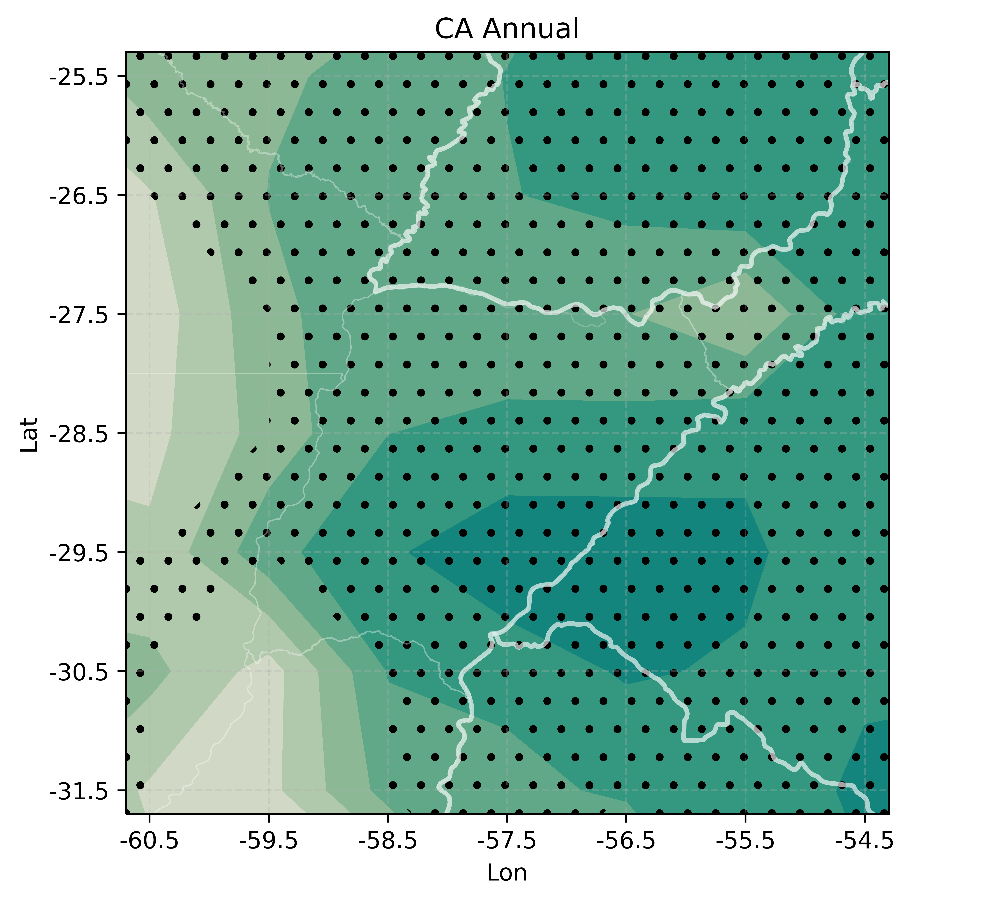

In [69]:
#Figure 6.21 grafico anual
def grafico_campos_climatologia_nubosidad_tendencias_paper_anual(xrdata, unidades_nombre, valor_minimo, valor_maximo, delta_valor):
    
    xticks_min = -60.5
    xticks_max = -54.5
    yticks_min = -31.5
    yticks_max = -25.5
    
    espacio_entre_lat_lon = 1
    # recorto region no hace falta porque ya estamos considerando solo la region de interes
    variable_data = xrdata[0]
    variable_significancia = xrdata[1]

    # me quedo solo con los que son significativos para marcar esas regiones con puntitos
    variable_significancia = variable_significancia.where(variable_significancia.values == 1)

    # ploteo 
    fig1 = plt.figure(figsize=[9.6, 6], dpi=900) 
    fig1.patch.set_facecolor('white')
    ax = fig1.add_subplot(111, projection=ccrs.PlateCarree(central_longitude=0))
    #variable_data.plot.contourf(ax=ax, levels=np.arange(valor_minimo, valor_maximo, delta_valor),
     #                               extend='neither',transform=ccrs.PlateCarree(),
     #                               cbar_kwargs={'label': unidades_nombre},cmap=cmocean.cm.curl)
    variable_data.plot.contourf(ax=ax, levels=np.arange(valor_minimo, valor_maximo, delta_valor),
                                    extend='neither',transform=ccrs.PlateCarree(),
                                    cbar_kwargs={'shrink':0.0001, "label":" ", "ticks": []},cmap=cmocean.cm.curl)
    # grafico puntos en los lugares donde es significativo
    variable_significancia.plot.contourf(ax=ax, levels=[0, 1], hatches=['.'], alpha=0, add_colorbar=False)

    # seteo el fondo gris para que los nans aparezcan en este color
    ax.set_facecolor('tab:gray')

    ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = 'white', linewidth = 0.6, alpha = 0.2) #, alpha = 0.5
    ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = 'white', linewidth = 2, alpha = 0.4) #, alpha = 0.7


    #seteo ejes
    ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
    ax.set_xticklabels(np.arange(xticks_min, xticks_max+1))
    plt.xticks(np.arange(xticks_min, xticks_max+1))
    ax.set_xlabel("Lon")
    ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
    ax.set_yticklabels(np.arange(yticks_min, yticks_max+1))
    plt.yticks(np.arange(yticks_min, yticks_max+1))
    ax.set_ylabel("Lat")
    plt.title("CA Annual")
    plt.grid(linestyle="--", alpha=0.3)
    return(fig1)

plt.close()

print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE FIGURE 6.21")
grafico_campos_climatologia_nubosidad_tendencias_paper_anual(xrdata = tendencia_anual, 
                                                 unidades_nombre = "%/dec", valor_minimo = -6 , 
                                                 valor_maximo = 6.5, delta_valor = 0.5)

plt.savefig("Figure6_21_tendencias_CA.png")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))

plt.show()

CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


SAVE FIGURE 6.22


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad


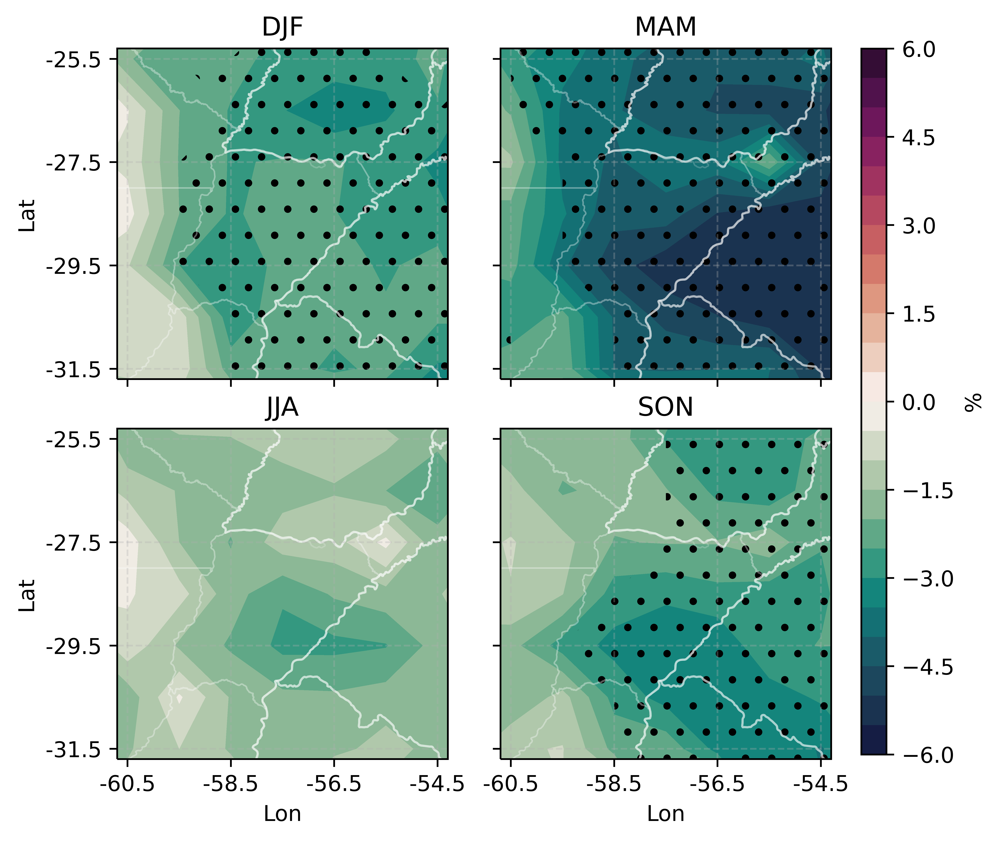

In [70]:
#HAGO EL GRAFICO ESTACIONAL: FIGURE 6.22
xrdata = tendencia_estacional 
unidades_nombre = "%/dec"
valor_minimo = -6
valor_maximo = 6.5
delta_valor = 0.5

xticks_min = -60.5
xticks_max = -54.5
yticks_min = -31.5
yticks_max = -25.5
espacio_entre_lat_lon = 1
fig1 = plt.figure(figsize = [8, 6], dpi = 900) 
fig1.patch.set_facecolor('white')
posiciones = [221, 222, 223, 224]
estaciones = ["DJF", "MAM", "JJA", "SON"]

for i in range(0,4):
    #xrdata_estacion = xrdata[estaciones[i]] #selecciono estacion del diccionario xrdata
    variable_data_estacion = xrdata[estaciones[i]][0]
    variable_significancia_estacion = xrdata[estaciones[i]][1]
    # me quedo solo con los que son significativos para marcar esas regiones con puntitos
    variable_significancia_estacion = variable_significancia_estacion.where(variable_significancia_estacion.values == 1)

    ax = fig1.add_subplot(posiciones[i], projection=ccrs.PlateCarree(central_longitude=0))

    im = variable_data_estacion.plot.contourf(ax=ax,levels=np.arange(valor_minimo, valor_maximo, 
                                                                     delta_valor),extend='neither',
                                              transform=ccrs.PlateCarree(),
                                              cbar_kwargs = {'shrink':0.0001, "label":" ", "ticks": []},
                                              cmap=cmocean.cm.curl)

    # grafico puntos en los lugares donde es significativo
    variable_significancia_estacion.plot.contourf(ax=ax, levels=[0, 1], hatches=["."], alpha=0, add_colorbar=False) 

    # seteo el fondo gris para que los nans aparezcan en este color
    ax.set_facecolor('tab:gray')


    ax.add_geometries(df_provincias(), crs=ccrs.PlateCarree(), facecolor='none',edgecolor='white', linewidth=0.7, alpha=0.2)

    ax.add_geometries(df_paises(), crs=ccrs.PlateCarree(), facecolor='none',edgecolor='white', alpha=0.4)

    #seteo ejes
    ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
    plt.xticks(np.arange(xticks_min, xticks_max+1, 2))
    if i == 0 or i == 1: #saco levels de x para los dos graficos de arriba
        ax.set_xticklabels([])
        ax.set_xlabel(" ")
    else:
        ax.set_xticklabels(np.arange(xticks_min, xticks_max+1, 2))
        ax.set_xlabel("Lon")


    ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
    plt.yticks(np.arange(yticks_min, yticks_max+1, 2))
    if i == 1 or i == 3: #saco levels de x para los dos graficos de la derecha
        ax.set_yticklabels([])
        ax.set_ylabel(" ")
    else:
        ax.set_yticklabels(np.arange(yticks_min, yticks_max+1, 2))
        ax.set_ylabel("Lat")
    ax.grid(linestyle="--", alpha=0.3)
    ax.set_title(estaciones[i], size= 14)

    ax.set_title(estaciones[i])

fig1.subplots_adjust(wspace=-0.35,hspace=0.15)
cbar_ax = fig1.add_axes([0.83, 0.13, 0.02, 0.75])
fig1.colorbar(im, cax=cbar_ax,label = "%")

print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE FIGURE 6.22")
plt.savefig("Figure6_22_tendencias_estacionales_CA.png")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/DoctoradoCodigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))

plt.show()